# Sex Differences in Functional Gradients in GSP

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
from math import isnan

# Computing
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/sex_diff_gradients/data/'

resdir = '/data/p_02667/sex_diff_gradients/results/GSP/'

In [3]:
path_list_fc_matrices = os.listdir(datadir+'fc_matrices/GSP/schaefer_output/')
path_list_fc_matrices.sort()

In [4]:
path_list_fc_matrices

['DEADJOE',
 'file_failed.txt',
 'sub-0001.csv',
 'sub-0002.csv',
 'sub-0003.csv',
 'sub-0004.csv',
 'sub-0005.csv',
 'sub-0006.csv',
 'sub-0007.csv',
 'sub-0009.csv',
 'sub-0010.csv',
 'sub-0011.csv',
 'sub-0012.csv',
 'sub-0013.csv',
 'sub-0014.csv',
 'sub-0015.csv',
 'sub-0016.csv',
 'sub-0017.csv',
 'sub-0018.csv',
 'sub-0019.csv',
 'sub-0020.csv',
 'sub-0021.csv',
 'sub-0022.csv',
 'sub-0023.csv',
 'sub-0024.csv',
 'sub-0025.csv',
 'sub-0026.csv',
 'sub-0027.csv',
 'sub-0028.csv',
 'sub-0029.csv',
 'sub-0030.csv',
 'sub-0031.csv',
 'sub-0032.csv',
 'sub-0033.csv',
 'sub-0034.csv',
 'sub-0035.csv',
 'sub-0036.csv',
 'sub-0037.csv',
 'sub-0038.csv',
 'sub-0039.csv',
 'sub-0040.csv',
 'sub-0041.csv',
 'sub-0042.csv',
 'sub-0043.csv',
 'sub-0044.csv',
 'sub-0045.csv',
 'sub-0046.csv',
 'sub-0047.csv',
 'sub-0048.csv',
 'sub-0049.csv',
 'sub-0050.csv',
 'sub-0051.csv',
 'sub-0052.csv',
 'sub-0053.csv',
 'sub-0054.csv',
 'sub-0055.csv',
 'sub-0056.csv',
 'sub-0057.csv',
 'sub-0058.csv',

## Data 

### Functional connectivity matrices (parcellation scheme: Schaefer 400, 7 networks) z-transformed

In [5]:
# list that contains all the subject IDs of subjects with fc matrices
sub_list = []

# list that contains the fc matrices of all subjects in the form of 1 np array per subject
fc_matrices_400 = []


for e in path_list_fc_matrices:
    if '.csv' in e:  # need to do this because there is a hidden files in the path_list_fc_matrices
        
        # add subject to the subjects' list
        sub_list.append(e.partition(".")[0])  # this partitions the subID.csv into a 3-tuple containing ('subID', '.', 'csv'), and I keep only the subID
        
        # reads csv file in the form of an array
        sub_matrix = np.genfromtxt(datadir+'fc_matrices/GSP/schaefer_output/'+e, delimiter=',')

        # add subject's matrix to the fc_matrices_400 list
        fc_matrices_400.append(sub_matrix)
        
print(f'Sample with FC matrices: N = {len(sub_list)}')

Sample with FC matrices: N = 1568


In [6]:
fc_matrices_400

[array([[ 0.        ,  0.71652034,  0.68361912, ...,  0.12986163,
          0.22923478,  0.2430989 ],
        [ 0.71652034,  0.        ,  0.4376179 , ...,  0.18841022,
          0.56861955,  0.35885721],
        [ 0.68361912,  0.4376179 ,  0.        , ..., -0.05823114,
          0.0919148 ,  0.14671486],
        ...,
        [ 0.12986163,  0.18841022, -0.05823114, ...,  0.        ,
          0.62925457,  0.36280906],
        [ 0.22923478,  0.56861955,  0.0919148 , ...,  0.62925457,
          0.        ,  0.37880951],
        [ 0.2430989 ,  0.35885721,  0.14671486, ...,  0.36280906,
          0.37880951,  0.        ]]),
 array([[0.        , 0.32374583, 0.9262678 , ..., 0.67479112, 0.62851121,
         0.54554591],
        [0.32374583, 0.        , 0.2647268 , ..., 0.40826663, 0.32688575,
         0.23567373],
        [0.9262678 , 0.2647268 , 0.        , ..., 0.67381319, 0.48678718,
         0.49429925],
        ...,
        [0.67479112, 0.40826663, 0.67381319, ..., 0.        , 0.96659772

### Descriptive

#### Load data

In [7]:
demographics = pd.read_csv(datadir+'GSP/GSP_list_140630.csv')  
print(f'Sample with demographic data: N = {len(demographics)}')

Sample with demographic data: N = 1570


In [8]:
demographics.keys()

Index(['Subject_ID', 'Subject_Rescan_ID', 'MRI', 'Behavior', 'Sex', 'Age_Bin',
       'Hand', 'Educ', 'Race_Ethn', 'Scanner_Bin', 'Console', 'Coil', 'ANAT',
       'BOLD1', 'BOLD1_sSNR', 'BOLD1_MotMicro', 'BOLD1_MotAbsMax', 'BOLD2',
       'BOLD2_sSNR', 'BOLD2_MotMicro', 'BOLD2_MotAbsMax', 'Flank_S_CORRpc',
       'Flank_S_meanRTcorr', 'Flank_S_medRTcorr', 'Flank_S_score',
       'Flank_NS_CORRpc', 'Flank_NS_meanRTcorr', 'Flank_NS_medRTcorr',
       'Flank_NS_score', 'Flank_CORRpc', 'Flank_meanRTcorr', 'Flank_medRTcorr',
       'Flank_TOT_score', 'MenRot_0_CORRpc', 'MenRot_0_meanRTcorr',
       'MenRot_0_medRTcorr', 'MenRot_80_CORRpc', 'MenRot_80_meanRTcorr',
       'MenRot_80_medRTcorr', 'MenRot_120_CORRpc', 'MenRot_120_meanRTcorr',
       'MenRot_120_medRTcorr', 'MenRot_160_CORRpc', 'MenRot_160_meanRTcorr',
       'MenRot_160_medRTcorr', 'MenRot_TOT_CORRpc', 'MenRot_TOT_meanRTcorr',
       'MenRot_TOT_medRTcorr', 'ICV', 'BrainSegVol', 'BrainSegVolNonVent',
       'postCorCall_Vol', '

In [9]:
demographics

,Subject_ID,Subject_Rescan_ID,MRI,Behavior,Sex,Age_Bin,Hand,Educ,Race_Ethn,Scanner_Bin,...,R_Parahipp_Thick,L_Parahipp_Thick,R_Fform_Thick,L_Fform_Thick,R_supF_Thick,L_supF_Thick,R_iPar_Thick,L_iPar_Thick,R_Ins_Thick,L_Ins_Thick
0,Sub0001_Ses1,NaN,2,Absent,F,25,RHT,16,W_NOT_HL,E,...,2.889,2.414,2.825,2.687,2.726,2.809,2.459,2.394,3.354,3.057
1,Sub0002_Ses1,NaN,1,Present,F,23,RHT,16,W_NOT_HL,B,...,2.912,2.697,2.784,2.721,2.948,2.945,2.509,2.489,3.347,3.506
2,Sub0003_Ses1,NaN,2,Absent,M,19,RHT,14,Other,E,...,2.559,2.644,2.794,2.691,2.950,2.966,2.399,2.450,3.226,3.286
3,Sub0004_Ses1,NaN,2,Present,F,27,RHT,18,W_NOT_HL,B,...,2.789,2.781,2.746,2.605,2.971,2.971,2.530,2.348,3.195,3.097
4,Sub0005_Ses1,NaN,1,Absent,F,21,RHT,15,Other,E,...,2.817,2.919,2.901,2.741,3.041,3.229,2.611,2.476,3.387,3.267
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1565,Sub1566_Ses1,NaN,1,Absent,M,23,RHT,15,W_NOT_HL,E,...,2.436,2.160,2.676,2.793,2.700,2.760,2.399,2.209,3.291,3.251
1566,Sub1567_Ses1,NaN,1,Absent,M,25,RHT,16,W_NOT_HL,D,...,2.537,2.719,2.717,2.657,2.720,2.773,2.382,2.282,3.238,3.461
1567,Sub1568_Ses1,NaN,1,Absent,M,21,RHT,15,W_NOT_HL,E,...,2.773,3.004,2.673,2.610,2.752,2.835,2.395,2.394,3.372,3.129
1568,Sub1569_Ses1,NaN,1,Absent,M,19,RHT,12,W_NOT_HL,E,...,2.613,2.921,2.733,2.739,2.621,2.755,2.625,2.591,3.405,3.463


#### Making "cleaned" version of the demographics dataframe which only contains subjects who also have fc matrices

In [10]:
# making a list of only the numbers of subjects with fc matrices 

sub_list_numbers = []

for sub in sub_list:
    sub_list_numbers.append(sub[4:])
    
    
# set index as subject in order to drop subject rows by calling on subject ID
demographics_cleaned = demographics.set_index('Subject_ID')

# 2 subjects with fc matrices missing: 0008 and 1287
for subID in demographics.loc[:,'Subject_ID']:
    if str(str(subID)[3:7]) not in sub_list_numbers:
        demographics_cleaned = demographics_cleaned.drop(subID)

print(f'Final sample with FC matrices and demographic data: N = {len(demographics_cleaned)}')

Final sample with FC matrices and demographic data: N = 1568


In [11]:
print(f"N = {len(demographics_cleaned)}\n"
      f"{np.sum(demographics_cleaned.Sex == 'F')} females, {np.sum(demographics_cleaned.Sex == 'M')} males\n"
      f"Mean subject age: {np.mean(demographics_cleaned.Age_Bin):.2f}, SD: {np.std(demographics_cleaned.Age_Bin):.2f}, range: {np.min(demographics_cleaned.Age_Bin):.2f} - {np.max(demographics_cleaned.Age_Bin):.2f}\n"
      f"Mean ICV: {np.mean(demographics_cleaned.ICV):.2f}, SD: {np.std(demographics_cleaned.ICV):.2f}, range: {np.min(demographics_cleaned.ICV):.2f} - {np.max(demographics_cleaned.ICV):.2f}")

N = 1568
905 females, 663 males
Mean subject age: 21.54, SD: 2.89, range: 19.00 - 35.00
Mean ICV: 1550645.44, SD: 148622.46, range: 1128895.08 - 2028048.55


#### Export demographics dataframe to csv for R analyses

In [12]:
# Export as csv merged dataframe of demographic data cleaned (for R analyses)
demographics_cleaned.to_csv(resdir+'demographics_cleaned.csv', header = True, index = True)

#### Testing differences in age between the sexes (given that I will test sex differences without matching for age)

In [13]:
# Levene's test for equality of variances -> non-significant differences means equality, can contiunue with parametric independent samples t-test
stats.levene(demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'M'], demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'F'])

LeveneResult(statistic=0.9402326681380857, pvalue=0.3323677474311486)

In [14]:
stats.ttest_ind(demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'M'], demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'F'])

Ttest_indResult(statistic=1.283186804764, pvalue=0.19961650062768793)

Text(0, 0.5, 'Frequency')

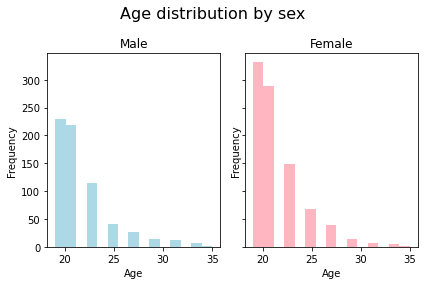

In [15]:
fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)

fig.suptitle('Age distribution by sex', fontsize=16)

axs[0].hist(demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'M'], bins=15, color = 'lightblue')
axs[0].set_title('Male')
axs[0].set_xlabel('Age')
axs[0].set_ylabel('Frequency')

axs[1].hist(demographics_cleaned.Age_Bin[demographics_cleaned.Sex == 'F'], bins=15, color = 'lightpink')
axs[1].set_title('Female')
axs[1].set_xlabel('Age')
axs[1].set_ylabel('Frequency')

## Constructing gradients

### Mean gradients

*Needed for alignment*

#### Calculate the mean matrix

In [16]:
mean_fc_matrix = sum(fc_matrices_400)/len(fc_matrices_400)

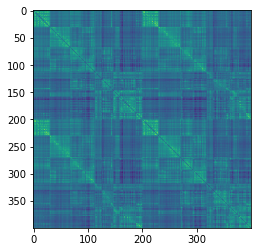

(400, 400)

In [17]:
plt.imshow(mean_fc_matrix)
plt.show()
mean_fc_matrix.shape

In [18]:
mean_fc_matrix

array([[0.        , 0.68740035, 0.71751586, ..., 0.28088017, 0.25177694,
        0.43392919],
       [0.68740035, 0.        , 0.45874188, ..., 0.31542722, 0.34283355,
        0.4801817 ],
       [0.71751586, 0.45874188, 0.        , ..., 0.29153778, 0.19064218,
        0.38746676],
       ...,
       [0.28088017, 0.31542722, 0.29153778, ..., 0.        , 0.62605202,
        0.60371687],
       [0.25177694, 0.34283355, 0.19064218, ..., 0.62605202, 0.        ,
        0.68049041],
       [0.43392919, 0.4801817 , 0.38746676, ..., 0.60371687, 0.68049041,
        0.        ]])

**IT WOULD BE NICE TO PLOT WITH PARCEL LABELS** 
e.g. different ways:
- brainspace.utils.parcellation import reduce_by_labels**
- calculate_fc_matrices script using nilearn plotting function

>not here with Schaefer: 400 parcels makes the labels unreadable

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [19]:
# GradientMaps function used to build the model parameters
mean_grad = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad.fit(mean_fc_matrix)

GradientMaps(kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


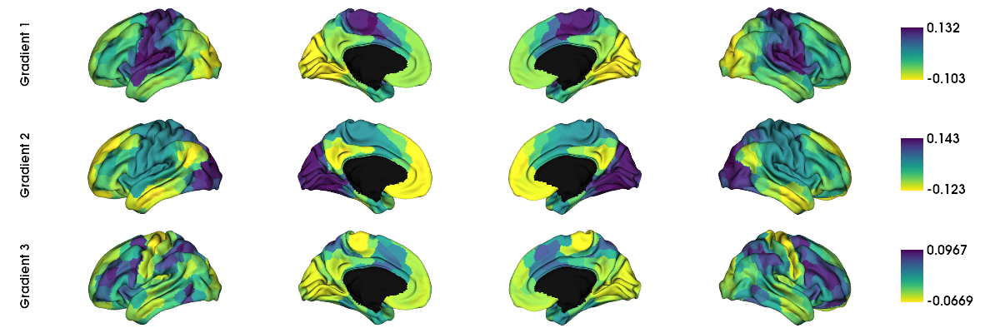

In [20]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels((mean_grad.gradients_)[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

From gradient inspection, noticed that Gradient 2 here in GSP data (correspomding to Gradient 1 in GSP and Margulies et al., 2016; i.e., unimodal-heteromodal gradient) has a flipped directionality compared to HCP G1 

**To make results more easily comparable, creating a new array of mean_grad with a flipped directionality for G2 only (i.e., x -1)**

Explanations
- Flipping directionality is okbecause it doesn't really matter what directionality a gradient has, important is that it has a directionality (it is a gradient)
- It is possible to only flip one gradient because gradients are independent of one another
- Only G2 mean gradient needs to be flipped here because then will do procrustus alignment with new set of mean gradients (only G2 flipped) and all the individual gradients should have this directionality

In [21]:
# list containing gradients matching directionality of HCP gradients (to make results more comparable)
mean_grad_hcp_directionality = []

# counter for iteration
grad_count = 0

# iterating over transposed array of gradients because original shape is (400,10) but it's easier to access G2 from a (10,400) shape 
for grad in mean_grad.gradients_.T:
    
    grad_count += 1

    # append to mean_grad_hcp_directionality the current gradient - only flip the directionality of G2 (to match G1 HCP), for the rest append as is
    if grad_count == 2:
        mean_grad_hcp_directionality.append(grad*-1)
        
    else:
        mean_grad_hcp_directionality.append(grad)

# need to make gradient list back into an array and transpose it back to initial (400, 10) shape
mean_grad_hcp_directionality = np.array(mean_grad_hcp_directionality).T

Below, only G2 should be flipped relative to original .gradient_ results

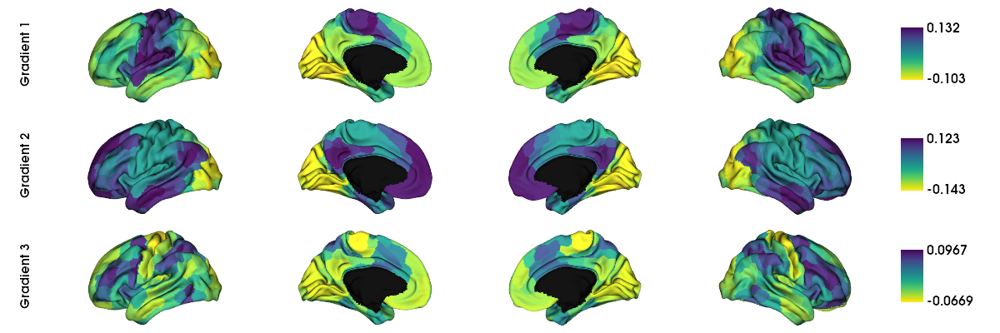

In [22]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels((mean_grad_hcp_directionality)[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

**!! From here on, need to use mean_grad_hcp_directionality array instead of mean_grad.gradients_ !!**

Variance explained by the 10 gradients

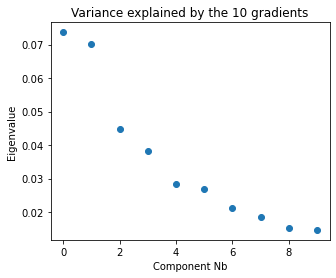

In [23]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad.lambdas_.size), mean_grad.lambdas_)
ax.set_title("Variance explained by the 10 gradients")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [24]:
print(f"Total amount of variance explained by the {len(mean_grad.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_grad.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad.lambdas_[0]/sum(mean_grad.lambdas_)*100:.2f}%\nG2: {mean_grad.lambdas_[1]/sum(mean_grad.lambdas_)*100:.2f}%\nG3: {mean_grad.lambdas_[2]/sum(mean_grad.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.35

Scaled variance explained by individual gradients:
G1: 20.93%
G2: 19.95%
G3: 12.77%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

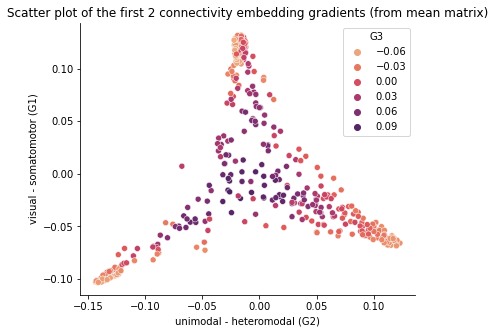

In [25]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality[:,1],  # all rows (400 parcels), second column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality[:,0],  # all rows (400 parcels), first column (G1: visual - somatomotor)
                     hue=mean_grad_hcp_directionality[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

#### Export mean gradient for correlation with HCP mean gradient

In [26]:
# Export as csv
pd.DataFrame(mean_grad_hcp_directionality).to_csv(resdir+'mean_gradient_eigenvalues.csv', header = True, index = False)

### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [27]:
list_aligned_gradients = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ 
      # use ._gradients for mean_grad (mean grad was not even calculated with a reference so doesn't have ._aligned) and use .aligned_ for grad_procr 
    
    grad_procr.fit(fc_matrices_400[i], reference=mean_grad_hcp_directionality)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients.append(grad_procr.aligned_)
    list_aligned_G1.append(grad_procr.aligned_.T[0])
    list_aligned_G2.append(grad_procr.aligned_.T[1])
    list_aligned_G3.append(grad_procr.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients = np.array(list_aligned_gradients)
array_aligned_G1 = np.array(list_aligned_G1)
array_aligned_G2 = np.array(list_aligned_G2)
array_aligned_G3 = np.array(list_aligned_G3)

In [28]:
array_aligned_G1[1]

array([-0.03044254, -0.0519709 , -0.05440053, -0.04920809, -0.08423445,
       -0.06958169, -0.03453721, -0.05275901, -0.08584001, -0.05250113,
       -0.08599725,  0.00535513,  0.01085672, -0.05711029, -0.09541097,
       -0.06875898,  0.03088566, -0.07660945, -0.09488146, -0.06118934,
       -0.07547481, -0.08062545, -0.08913235, -0.09718778, -0.08862605,
       -0.05151591, -0.09705642, -0.06183791, -0.0983179 , -0.09839904,
        0.08757918,  0.13988234,  0.14641413,  0.11604174,  0.1446684 ,
        0.09463322, -0.01268185,  0.13860734,  0.13531707,  0.14035301,
        0.08200822,  0.14596884,  0.13842023,  0.14747615,  0.13644862,
        0.10372086,  0.13798684,  0.13004302,  0.13772004,  0.13763678,
        0.13305218,  0.11089683,  0.12897921,  0.07036032,  0.10242455,
        0.14327798,  0.11756442,  0.0735426 ,  0.12200231,  0.09068539,
        0.12845466,  0.08913258,  0.0294209 ,  0.07860691,  0.12941175,
        0.09457747,  0.08427615,  0.08662718,  0.01034633,  0.03

#### Exporting Gradients to csv for R analyses

In [29]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_G1.csv', array_aligned_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'array_aligned_G2.csv', array_aligned_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'array_aligned_G3.csv', array_aligned_G3, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

### Mean gradients by sex

*Needed for plotting Males vs Females*

#### Mean matrices by sex

Creating lists containing only male and only female fc matrices

In [29]:
fc_matrices_400_M = []
fc_matrices_400_F = []

for i in range(len(fc_matrices_400)):
    if demographics_cleaned.Sex.iloc[i] == "M":
        fc_matrices_400_M.append(fc_matrices_400[i])
    elif demographics_cleaned.Sex.iloc[i] == "F":
        fc_matrices_400_F.append(fc_matrices_400[i])

Calculating mean matrices by sex

In [30]:
mean_fc_matrix_M = sum(fc_matrices_400_M)/len(fc_matrices_400_M)
mean_fc_matrix_F = sum(fc_matrices_400_F)/len(fc_matrices_400_F)

#### Construct mean gradients by sex

In [31]:
# GradientMaps function used to build the model parameters
mean_grad_M = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')
mean_grad_F = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_M.fit(mean_fc_matrix_M)
mean_grad_F.fit(mean_fc_matrix_F)

GradientMaps(kernel='normalized_angle', random_state=0)

Again need to flip G2 directionality in males and females separately

In [32]:
# list containing gradients matching directionality of HCP gradients (to make results more comparable)
mean_grad_hcp_directionality_M = []
mean_grad_hcp_directionality_F = []

## Males

# counter for iteration
grad_count = 0

# iterating over transposed array of gradients because original shape is (400,10) but it's easier to access G2 from a (10,400) shape 
for grad in mean_grad_M.gradients_.T:
    
    grad_count += 1

    # append to mean_grad_hcp_directionality the current gradient - only flip the directionality of G2 (to match G1 HCP), for the rest append as is
    if grad_count == 2:
        mean_grad_hcp_directionality_M.append(grad*-1)
        
    else:
        mean_grad_hcp_directionality_M.append(grad)

# need to make gradient list back into an array and transpose it back to initial (400, 10) shape
mean_grad_hcp_directionality_M = np.array(mean_grad_hcp_directionality_M).T


## Females

# counter for iteration
grad_count = 0

# iterating over transposed array of gradients because original shape is (400,10) but it's easier to access G2 from a (10,400) shape 
for grad in mean_grad_F.gradients_.T:
    
    grad_count += 1

    # append to mean_grad_hcp_directionality the current gradient - only flip the directionality of G2 (to match G1 HCP), for the rest append as is
    if grad_count == 2:
        mean_grad_hcp_directionality_F.append(grad*-1)
        
    else:
        mean_grad_hcp_directionality_F.append(grad)

# need to make gradient list back into an array and transpose it back to initial (400, 10) shape
mean_grad_hcp_directionality_F = np.array(mean_grad_hcp_directionality_F).T

Visualization of first three gradients in males

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


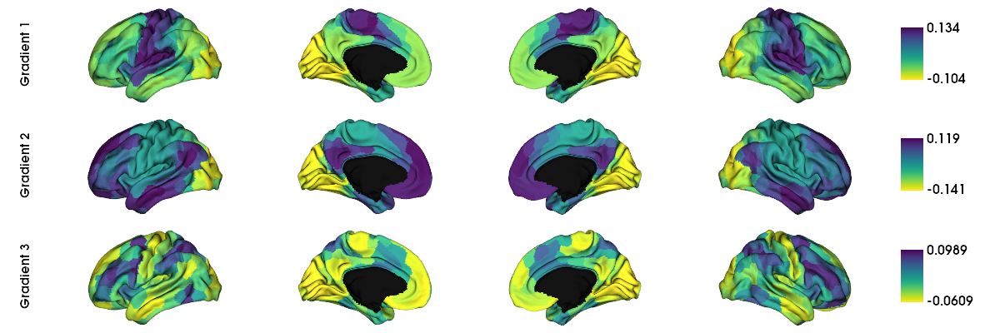

In [33]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels((mean_grad_hcp_directionality_M)[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Visualization of first three gradients in females

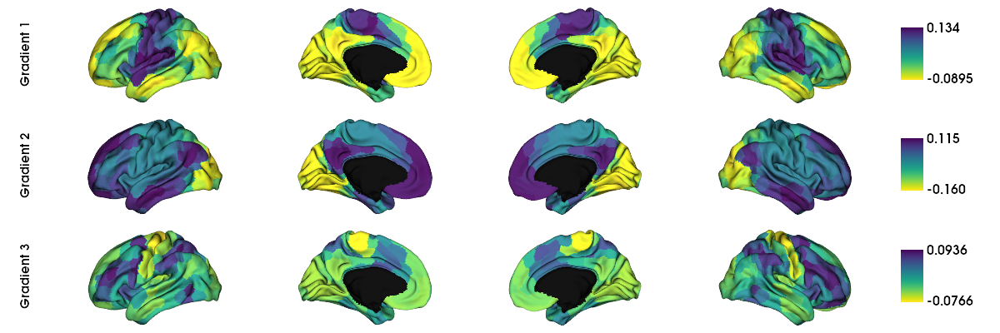

In [34]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels((mean_grad_hcp_directionality_F)[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

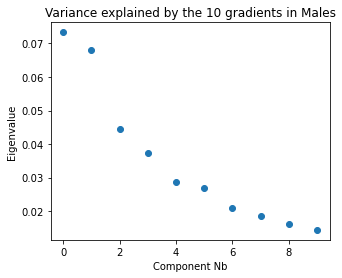

In [35]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_M.lambdas_.size), mean_grad_M.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Males")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [36]:
print(f"Total amount of variance explained by the {len(mean_grad_M.lambdas_)} gradients (uncorrected sum lambdas) in MALES: {sum(mean_grad_M.lambdas_):.2f}\n") # new

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_M.lambdas_[0]/sum(mean_grad_M.lambdas_)*100:.2f}%\nG2: {mean_grad_M.lambdas_[1]/sum(mean_grad_M.lambdas_)*100:.2f}%\nG3: {mean_grad_M.lambdas_[2]/sum(mean_grad_M.lambdas_)*100:.2f}%\n")


Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) in MALES: 0.35

Scaled variance explained by individual gradients:
G1: 21.01%
G2: 19.52%
G3: 12.74%



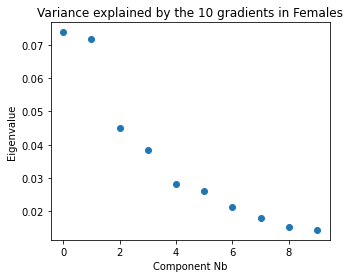

In [37]:
fig, ax = plt.subplots(1, figsize=(5, 4))

ax.scatter(range(mean_grad_F.lambdas_.size), mean_grad_F.lambdas_)
ax.set_title("Variance explained by the 10 gradients in Females")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [38]:
print(f"Total amount of variance explained by the {len(mean_grad_F.lambdas_)} gradients (uncorrected sum lambdas) in FEMALES: {sum(mean_grad_F.lambdas_):.2f}\n") # new

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_F.lambdas_[0]/sum(mean_grad_F.lambdas_)*100:.2f}%\nG2: {mean_grad_F.lambdas_[1]/sum(mean_grad_F.lambdas_)*100:.2f}%\nG3: {mean_grad_F.lambdas_[2]/sum(mean_grad_F.lambdas_)*100:.2f}%\n")


Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) in FEMALES: 0.35

Scaled variance explained by individual gradients:
G1: 20.91%
G2: 20.36%
G3: 12.80%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

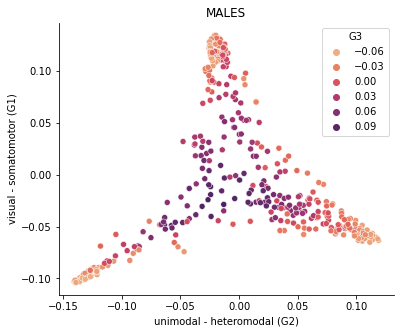

In [39]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_M[:,1],  # all rows (400 parcels), second column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality_M[:,0],  # all rows (400 parcels), first column (G1: visual - somatomotor)
                     hue=mean_grad_hcp_directionality_M[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

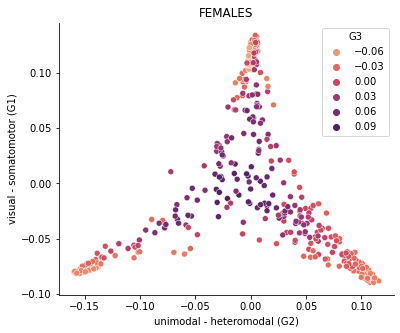

In [40]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_F[:,1],  # all rows (400 parcels), second column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality_F[:,0],  # all rows (400 parcels), first column (G1: visual - somatomotor)            
                     hue=mean_grad_hcp_directionality_F[:,2],  # gives color coding based on all rows (400 parcels), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

## Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

### Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)



- **So a parcel cannot belong to more than 1 network..? LIMITATION NO? -> Yes. Shanmugan et al. (2022) for example use loading onto a network (i.e., not discrete)** 

In [35]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

with open(datadir+'yeo_7.csv') as f:
    reader = csv.reader(f)
    yeo7_networks = list(reader)[0]  # need [0] because the network values are contained in double brackets [[ ]]

Plotting the 7 Yeo networks on cortical surface

**TO DO:**
- no option of a map with 7 colors..? https://matplotlib.org/stable/tutorials/colors/colormaps.html
- there must be a better way of labelling the maps with actual names of networks (ie categorical)? maybe not, not the purpose of this plot hemispheres function


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


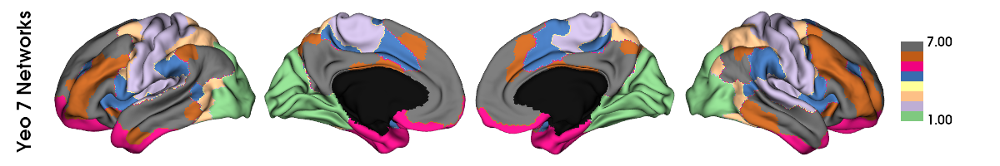

In [36]:
# need the the yeo network values (=dummy coding) to be in array format & float type in order to map_to_labels
yeo7_networks_array = []

for i in yeo7_networks:
    yeo7_networks_array.append(float(i))

yeo7_networks_array = np.asarray(yeo7_networks_array)



# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=networks, embed_nb = True, size=(1200, 200), cmap='Accent', color_bar=True, label_text=['Yeo 7 Networks'], zoom=1.55)


## Network labels ('Accent' cmap):
# 1 visual (green)
# 2 sensory motor (purple)
# 3 dorsal attention (beige)
# 4 ventral attention (blue)
# 5 limbic (fuchsia)
# 6 fronto parietal (brown)
# 7 DMN (grey)

This is not needed for the raincloud plot, just for the scatterplot G1 v G2 displaying networks

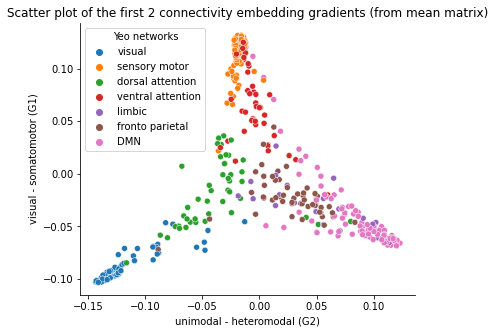

In [37]:
# making an array with yeo network labels (names instead of numbers)
yeo7_networks_array_labels = []

for i in yeo7_networks:
    if i == '1':
        yeo7_networks_array_labels.append('visual')
    elif i == '2':
        yeo7_networks_array_labels.append('sensory motor')
    elif i == '3':
        yeo7_networks_array_labels.append('dorsal attention')
    elif i == '4':
        yeo7_networks_array_labels.append('ventral attention')
    elif i == '5':
        yeo7_networks_array_labels.append('limbic')
    elif i == '6':
        yeo7_networks_array_labels.append('fronto parietal')
    elif i == '7':
        yeo7_networks_array_labels.append('DMN')

yeo7_networks_array_labels = np.asarray(yeo7_networks_array_labels)


# dictionary color palette emphasizing visual, sensory motore, and DMN networks
palette_visual_sensmotor_DMN = {"visual":"tab:cyan",
                                "sensory motor":"tab:orange", 
                                "DMN":"tab:purple",
                                
                                "dorsal attention":"tab:grey",
                                "ventral attention":"tab:grey",
                                "limbic":"tab:grey",
                                "fronto parietal":"tab:grey"}




# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality[:,1],  # all rows (400 parcels), second column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality[:,0],  # all rows (400 parcels), first column (G1: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     #palette=sns.color_palette("muted", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

In [41]:
network_names = ["visual", "sensory motor", "DMN", "dorsal attention", "ventral attention", "limbic", "fronto parietal"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- DMN: 90
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53


### Gradient 1: visual - somatomotor

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [69]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1 = pd.DataFrame(array_aligned_G1.T)

# adding a column containing the Yeo network labels
df_G1['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1.loc[df_G1["yeo network"] == "1", "yeo network"] = "visual"
df_G1.loc[df_G1["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1.loc[df_G1["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1.loc[df_G1["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1.loc[df_G1["yeo network"] == "5", "yeo network"] = "limbic"
df_G1.loc[df_G1["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1.loc[df_G1["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1 = df_G1.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1.index.name = "sub"
df_G1 = df_G1.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1=pd.melt(df_G1, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1["across sexes"] = [1] * 10976

#### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

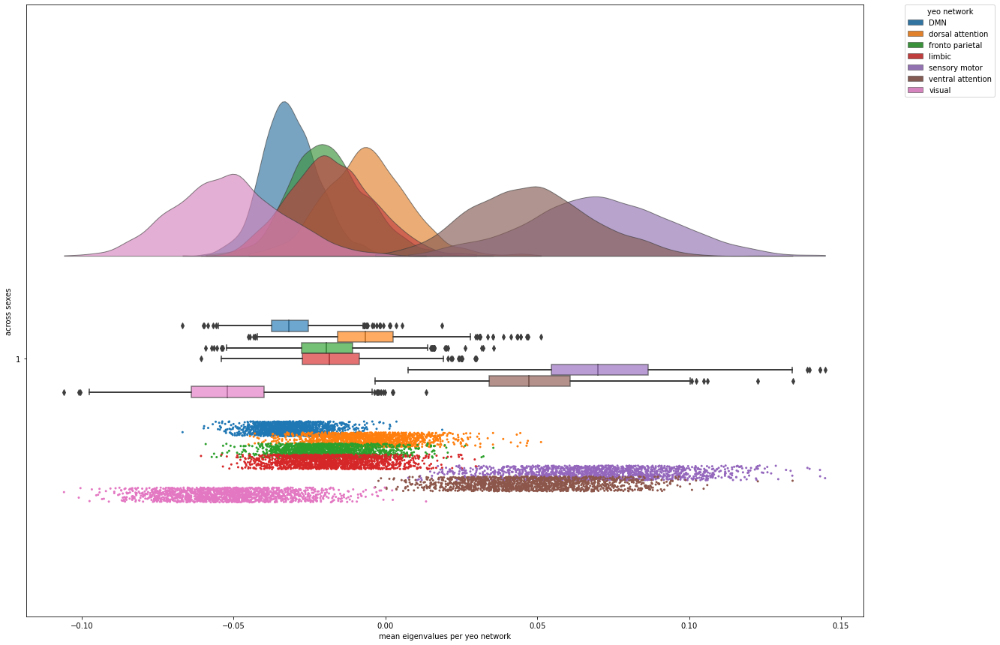

In [70]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

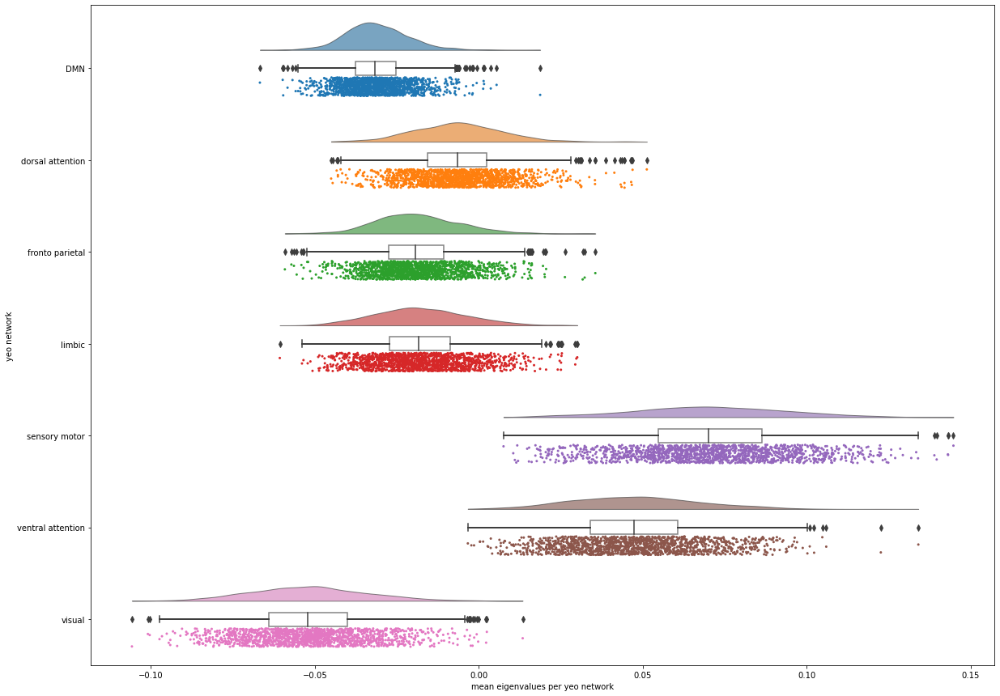

In [71]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks)

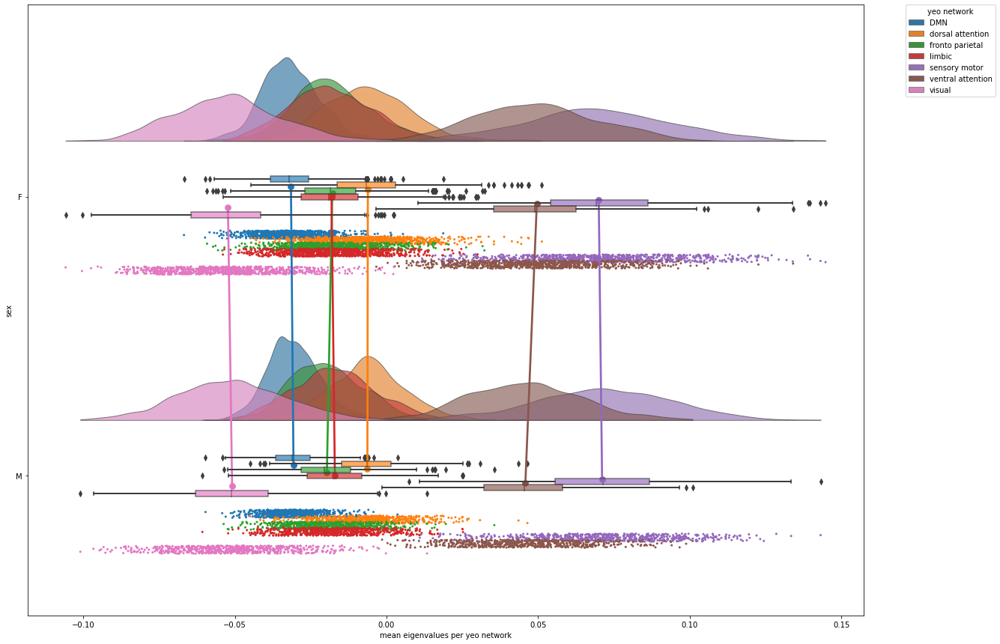

In [72]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

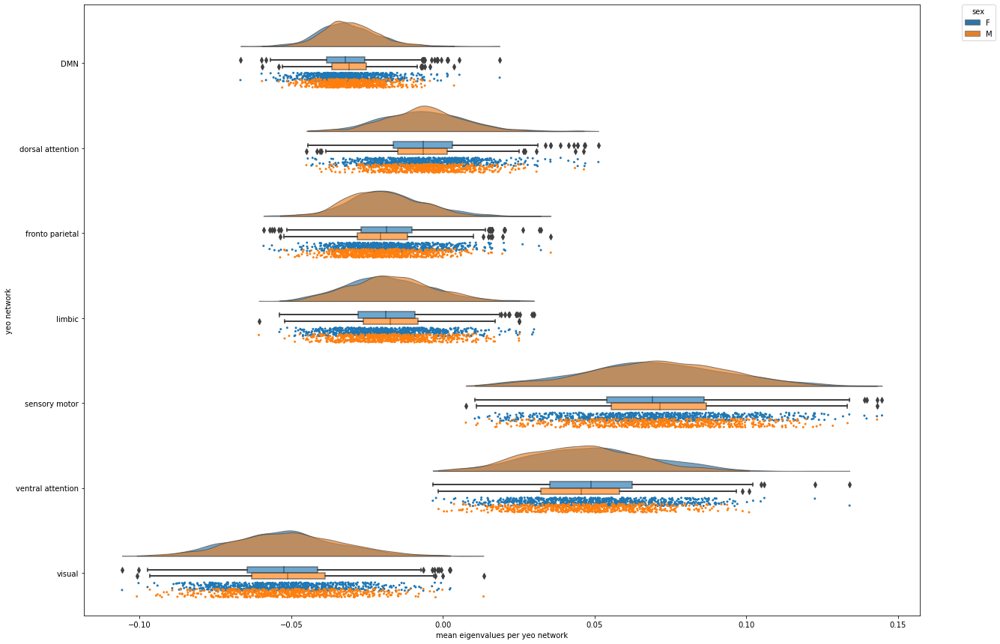

In [73]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G1) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G1, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['F', 'F', 'M', 'F', 'F', 'M', 'M', 'M', 'M', 'M']


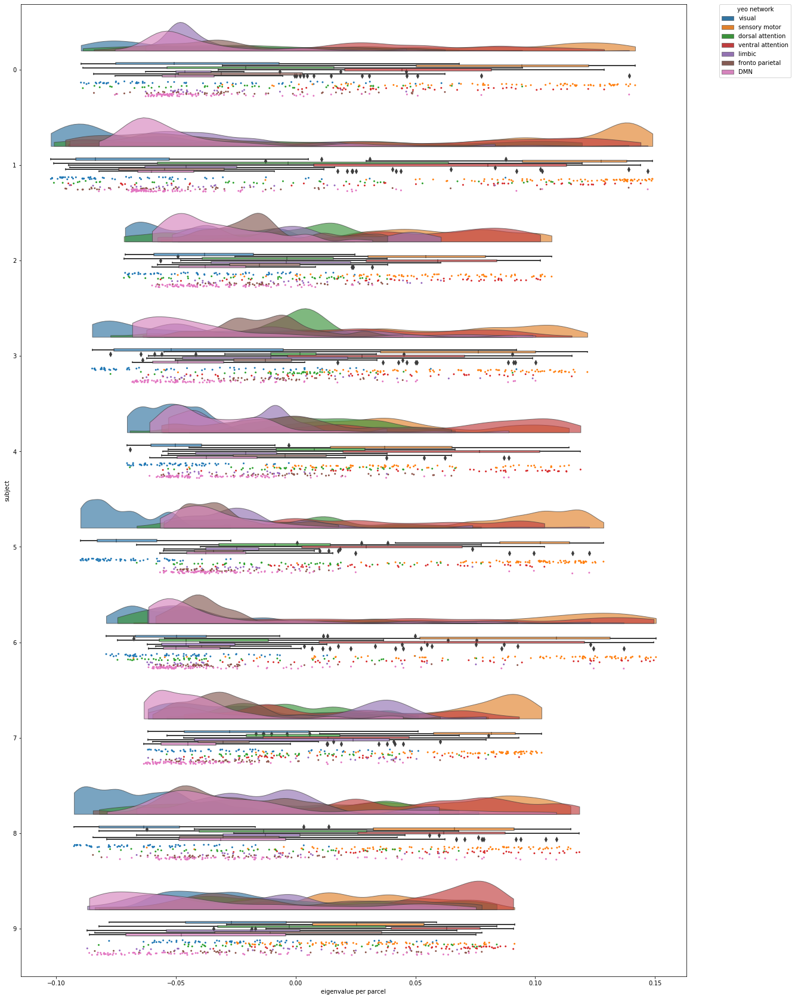

In [74]:
### Organizing the data

df_G1_10sub = pd.DataFrame(array_aligned_G1[0:10].T)

# adding a column containing the Yeo network labels
df_G1_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_10sub.loc[df_G1_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_10sub=pd.melt(df_G1_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G1, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G1_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {demographics_cleaned["Sex"].tolist()[0:10]}')

### Gradient 2: unimodal - heteromodal

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [75]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2 = pd.DataFrame(array_aligned_G2.T)

# adding a column containing the Yeo network labels
df_G2['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2.loc[df_G2["yeo network"] == "1", "yeo network"] = "visual"
df_G2.loc[df_G2["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2.loc[df_G2["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2.loc[df_G2["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2.loc[df_G2["yeo network"] == "5", "yeo network"] = "limbic"
df_G2.loc[df_G2["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2.loc[df_G2["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2 = df_G2.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2.index.name = "sub"
df_G2 = df_G2.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2=pd.melt(df_G2, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2["across sexes"] = [1] * 10976

#### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

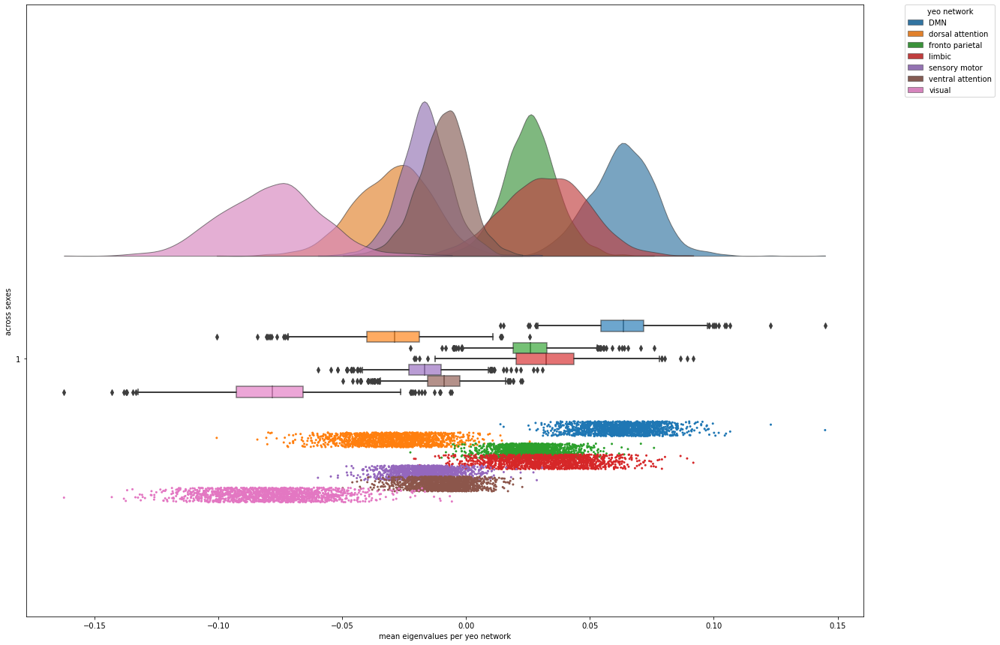

In [76]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

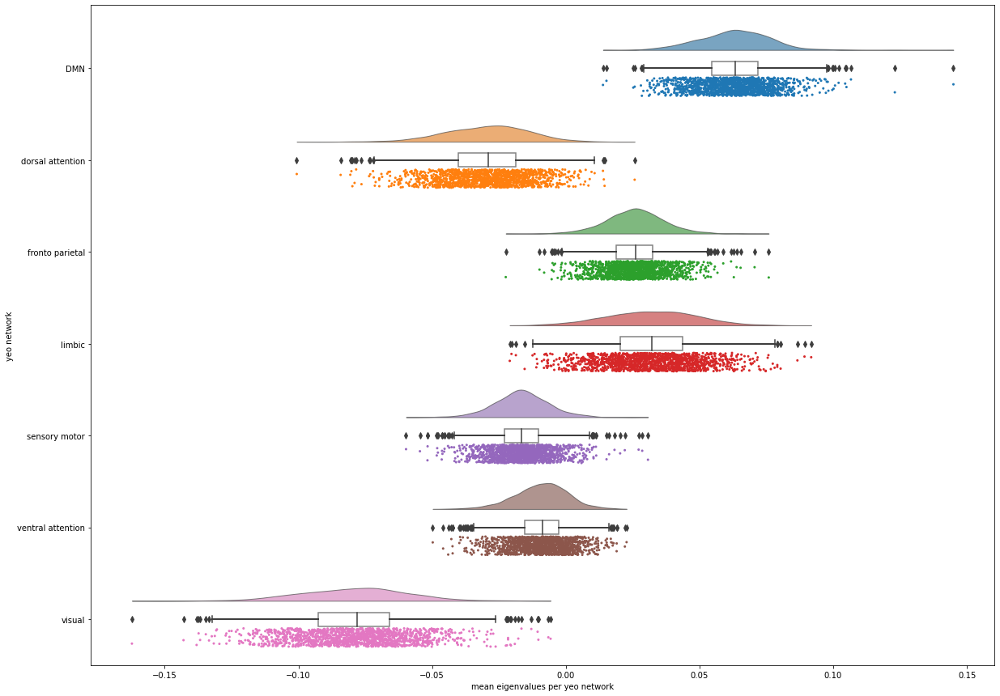

In [77]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks) 


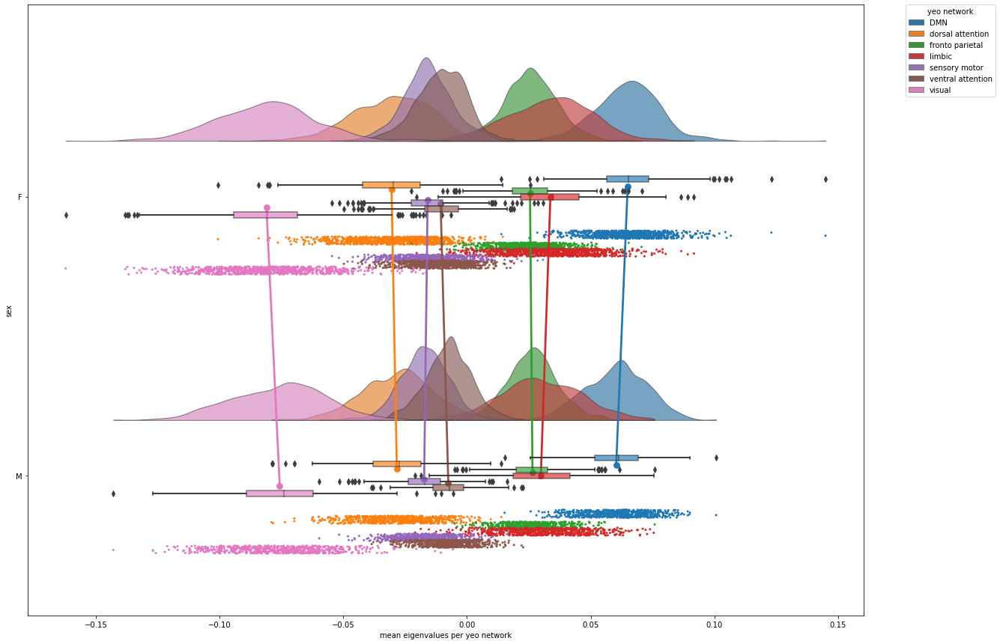

In [78]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

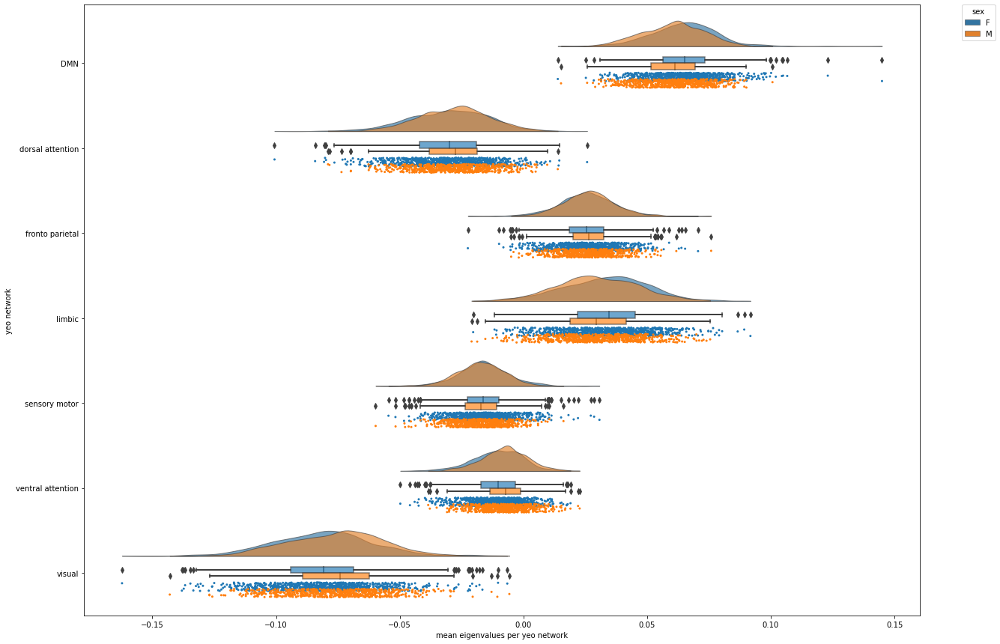

In [79]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G2) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G2, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['F', 'F', 'M', 'F', 'F', 'M', 'M', 'M', 'M', 'M']


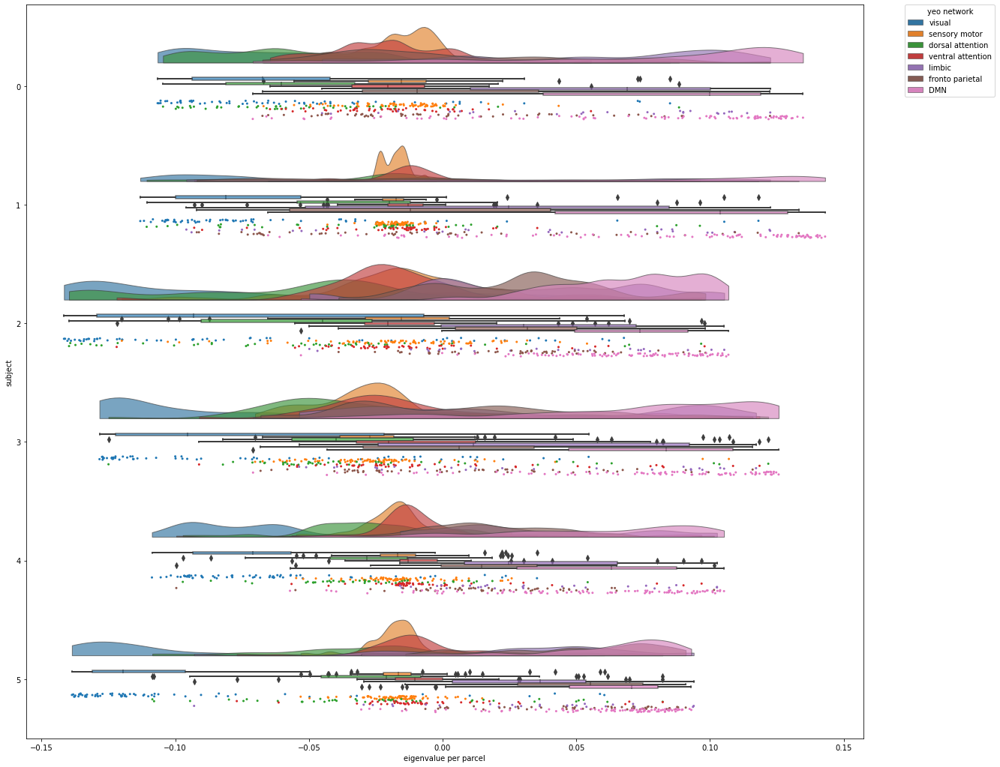

In [80]:
### Organizing the data

df_G2_10sub = pd.DataFrame(array_aligned_G2[0:6].T)

# adding a column containing the Yeo network labels
df_G2_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_10sub.loc[df_G2_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_10sub=pd.melt(df_G2_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G2, for first 10 subjects

f,ax=plt.subplots(figsize=(20,18))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G2_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {demographics_cleaned["Sex"].tolist()[0:10]}')

### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [81]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3 = pd.DataFrame(array_aligned_G3.T)

# adding a column containing the Yeo network labels
df_G3['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3.loc[df_G3["yeo network"] == "1", "yeo network"] = "visual"
df_G3.loc[df_G3["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3.loc[df_G3["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3.loc[df_G3["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3.loc[df_G3["yeo network"] == "5", "yeo network"] = "limbic"
df_G3.loc[df_G3["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3.loc[df_G3["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3 = df_G3.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3.index.name = "sub"
df_G3 = df_G3.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3=pd.melt(df_G3, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3["across sexes"] = [1] * 10976

#### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

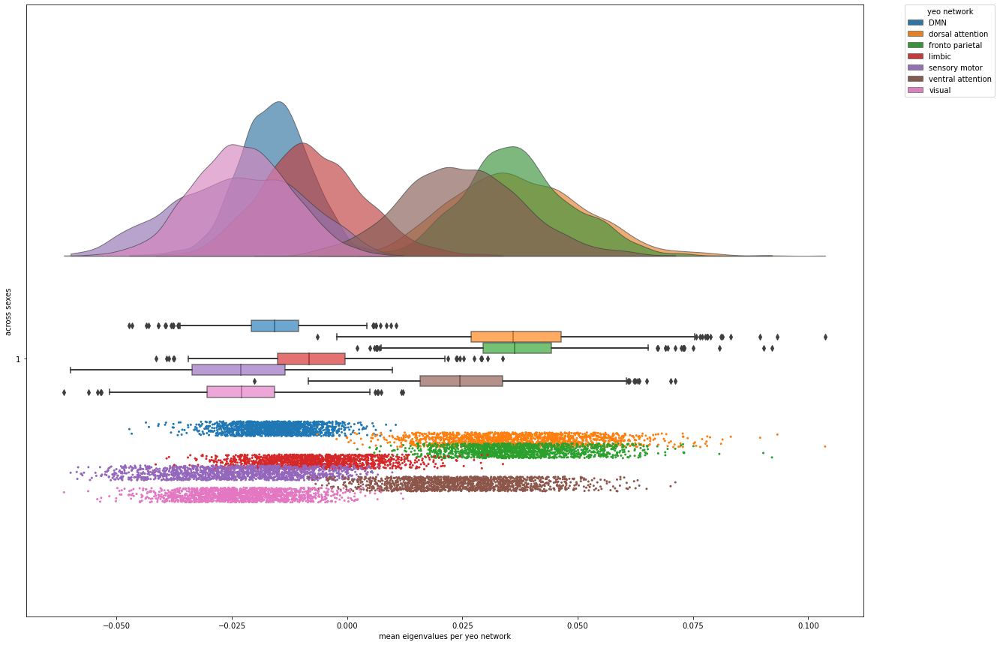

In [82]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

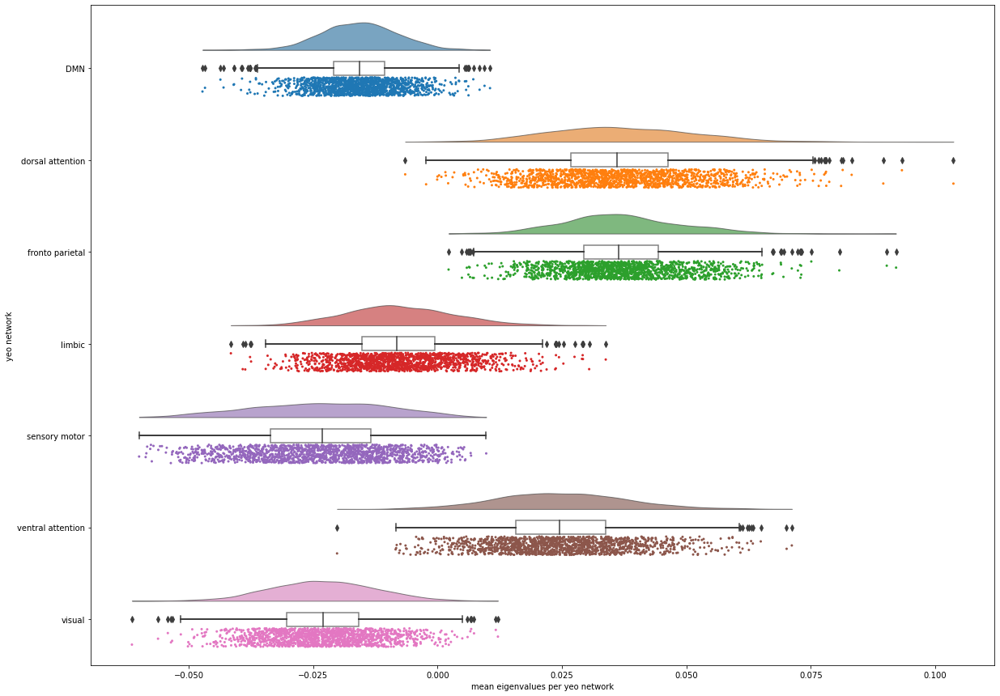

In [83]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

#### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks) 

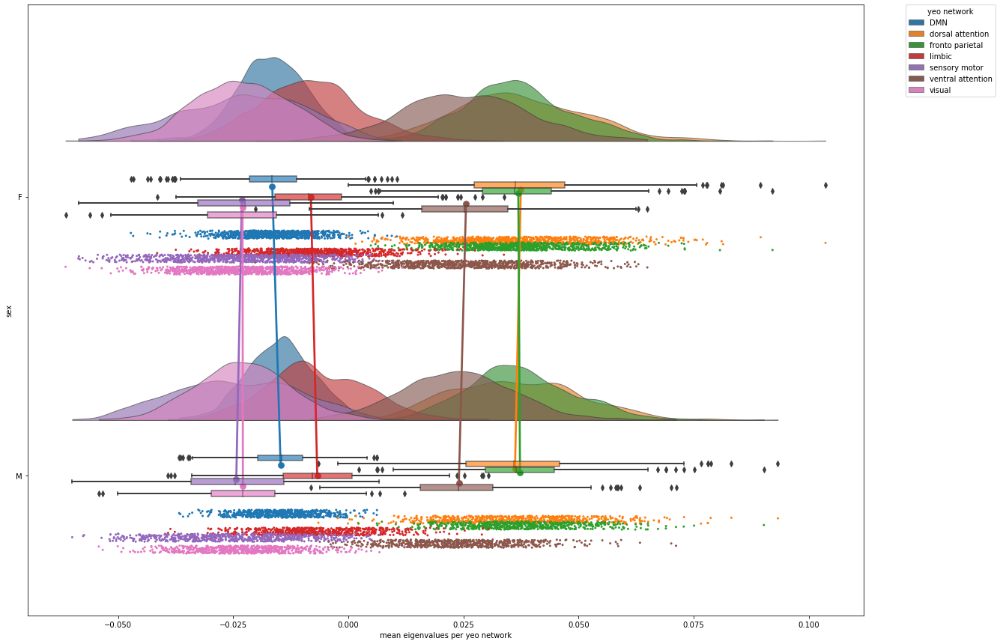

In [84]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

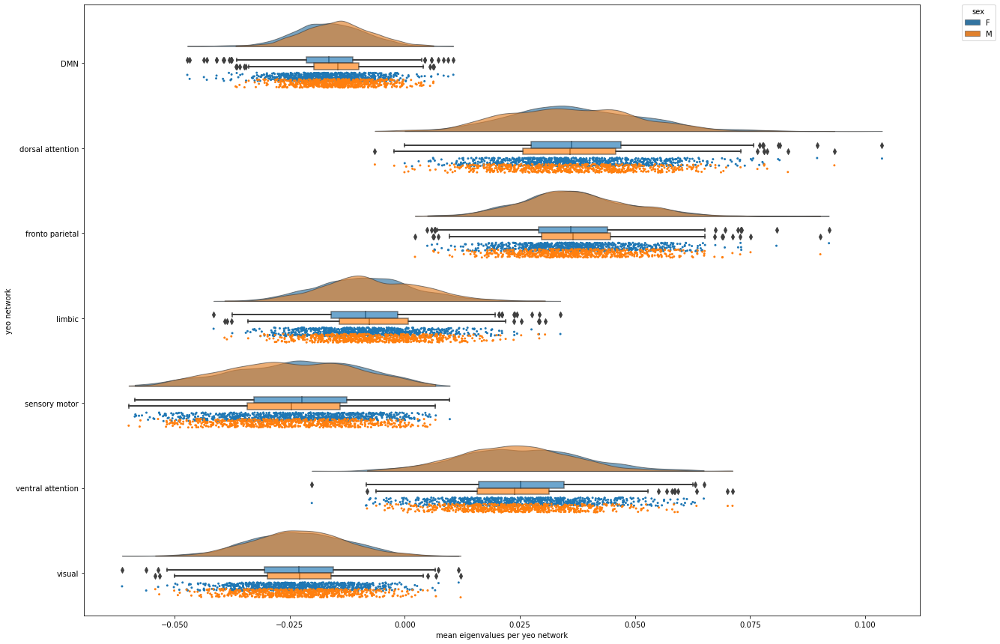

In [85]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
#### RainCloud plot of eigenvalues (G3) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G3, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['F', 'F', 'M', 'F', 'F', 'M', 'M', 'M', 'M', 'M']


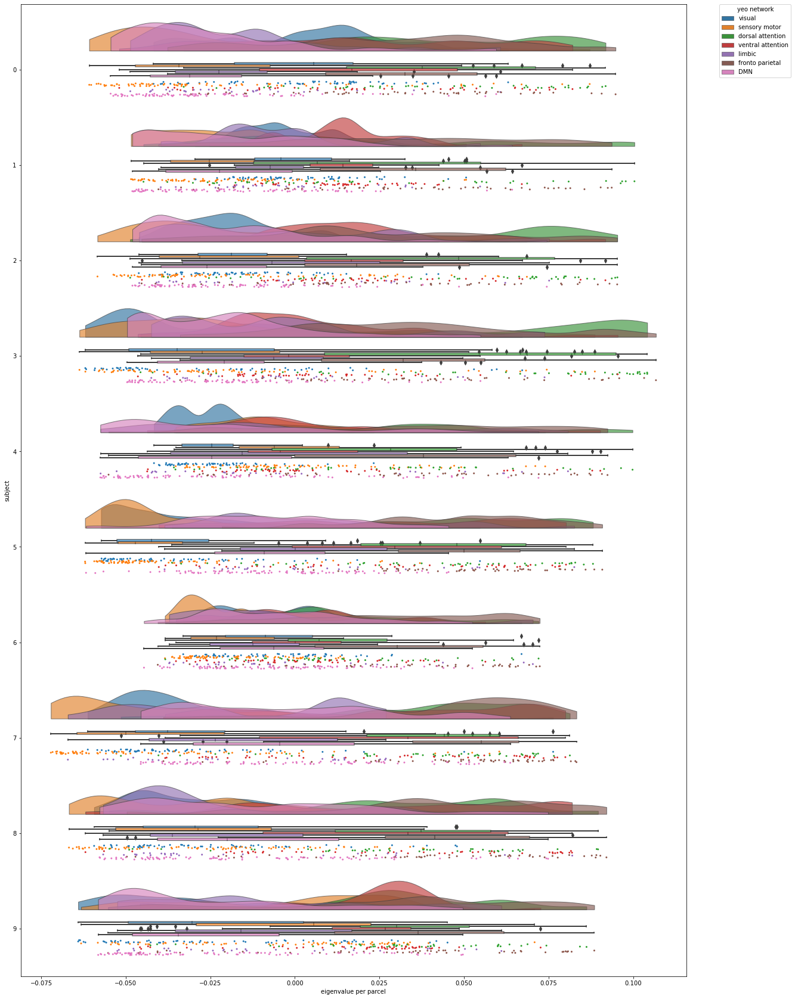

In [86]:
### Organizing the data

df_G3_10sub = pd.DataFrame(array_aligned_G3[0:10].T)

# adding a column containing the Yeo network labels
df_G3_10sub['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "1", "yeo network"] = "visual"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_10sub.loc[df_G3_10sub["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_10sub.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_10sub=pd.melt(df_G3_10sub, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G3, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G3_10sub,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {demographics_cleaned["Sex"].tolist()[0:10]}')

## Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

In [78]:
def plot_slm_results(slm):
    
    '''
    Function that plots slm results (t-values and for now only FDR corrected q-values)
    
    Input required: slm output from Brainstat's brainstat.stats.SLM 
    
    Specific to plotting on surf_lh, surf_rh from conte69; for data coming from Schaefer 400 parcellation
    
    '''
    
    # defining labeling scheme and mask
    # ! if doesn't work anymore for some reason, take this out of the definition (put it before it) !
    labeling = load_parcellation('schaefer', scale=400, join=True)
    surf_lh, surf_rh = load_conte69()
    mask = labeling != 0
    
    
    # will contain the different plots
    handles = []
    
    
    ### t-values
    tvals_mapped_to_labels = map_to_labels(slm.t[0], labeling, mask=mask, fill=np.nan)  # t[0] because there is a double bracket for the t-values array, need [0] to access the values themselves
    
    tvals_plotted_hemispheres = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = tvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "bwr_r",  # bwr, _r stands for reversed; using it to matche male-blue female-red 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["t-values"],
        zoom = 1.45)
    
    # plot
    handles.append(tvals_plotted_hemispheres)
                   
                   
    ### Q-values
    
    #assigning to new variable using copy() so that changes made in copy will not affect the original array
    Qvals = slm.Q.copy()  

    # only keep Q-values that are significant (replacing values > 0.05 with nan)
    np.place(Qvals, Qvals > 0.05, np.nan) 
    
    # this maps shape (400,) turning it inot shape (64984,)
    Qvals_mapped_to_labels = map_to_labels(Qvals, labeling, mask=mask, fill=np.nan)
    
    # plot
    Qvals_plotted_hemispheres =  plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = Qvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "plasma_r", 
        color_bar = True, 
        #color_range = color_range_Q,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["Q-values"],
        zoom = 1.45)
    
    handles.append(Qvals_plotted_hemispheres)
                                           
    return handles

In [77]:
def plot_slm_results_R(slm_res_R):
    
    '''
    Function that plots slm results (t-values, p-values, and only FDR corrected q-values)
    
    Input required: slm results dataframe containing vales with the following names: t_val_sex, p_val_sex, q_val_sex (*** HARCODED WITH "sex" IN NAME - CHANGE THIS TO SIMPLY t_val IF I START USING THIS VISUALIZATION FUNCTION FOR OTHER R RESULTS ***)
    
    Specific to plotting on surf_lh, surf_rh from conte69; for data coming from Schaefer 400 parcellation
    
    '''
    
    # defining labeling scheme and mask
    # ! if doesn't work anymore for some reason, take this out of the definition (put it before it) !
    labeling = load_parcellation('schaefer', scale=400, join=True)
    surf_lh, surf_rh = load_conte69()
    mask = labeling != 0
    
    
    # will contain the different plots
    handles = []
    
    
    ### t-values
    tvals_mapped_to_labels = map_to_labels(np.asarray(slm_res_R.t_val_sex), labeling, mask=mask, fill=np.nan)  # t[0] because there is a double bracket for the t-values array, need [0] to access the values themselves
    
    tvals_plotted_hemispheres = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = tvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "bwr_r",  # bwr, _r stands for reversed; using it to matche male-blue female-red 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["t-values"],
        zoom = 1.45)
    
    # plot
    handles.append(tvals_plotted_hemispheres)
       
        
    
    ### p-values (uncorrected)
    
    #assigning to new variable using copy() so that changes made in copy will not affect the original array
    pvals = np.asarray(slm_res_R.p_val_sex.copy())

    # only keep Q-values that are significant (replacing values > 0.05 with nan)
    np.place(pvals, pvals > 0.05, np.nan) 
    
    # this maps shape (400,) turning it inot shape (64984,)
    pvals_mapped_to_labels = map_to_labels(pvals, labeling, mask=mask, fill=np.nan)
    
    # plot
    pvals_plotted_hemispheres =  plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = pvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "plasma_r", 
        color_bar = True, 
        #color_range = color_range_Q,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["p-values (uncorr.)"],
        zoom = 1.45)
    
    handles.append(pvals_plotted_hemispheres)    
        
        
                   
    ### Q-values
    
    #assigning to new variable using copy() so that changes made in copy will not affect the original array
    Qvals = np.asarray(slm_res_R.q_val_sex.copy())

    # only keep Q-values that are significant (replacing values > 0.05 with nan)
    np.place(Qvals, Qvals > 0.05, np.nan) 
    
    # this maps shape (400,) turning it inot shape (64984,)
    Qvals_mapped_to_labels = map_to_labels(Qvals, labeling, mask=mask, fill=np.nan)
    
    # plot
    Qvals_plotted_hemispheres =  plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = Qvals_mapped_to_labels, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = "plasma_r", 
        color_bar = True, 
        #color_range = color_range_Q,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["Q-values"],
        zoom = 1.45)
    
    handles.append(Qvals_plotted_hemispheres)
                                           
    return handles

### Gradient 1: visual - somatomotor

#### Python (Brainstat) lm

In [54]:
### creating model terms

term_sex = FixedEffect(demographics_cleaned.Sex)
term_age = FixedEffect(demographics_cleaned.Age_Bin)
term_icv = FixedEffect(demographics_cleaned.ICV)


### defining contrast to test: sex differences

contrast_sex = (demographics_cleaned.Sex == "M").astype(int) - (demographics_cleaned.Sex == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv = term_sex + term_age + term_icv  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G1)

In [55]:
slm_SEX_age_icv.Q

array([5.02715319e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 7.19922490e-01, 1.00000000e+00,
       1.00000000e+00, 2.56290050e-01, 1.00000000e+00, 6.88909214e-01,
       9.89155086e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       5.51469120e-01, 1.00000000e+00, 1.00000000e+00, 6.79031723e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 8.95525784e-01,
       1.15093633e-03, 8.79484342e-01, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 4.47890637e-02, 1.00000000e+00, 1.00000000e+00,
       8.36578085e-01, 1.00000000e+00, 8.35409822e-01, 1.00000000e+00,
       8.73530086e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       8.36578085e-01, 8.52925157e-01, 9.46456360e-01, 1.00000000e+00,
      

In [56]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(slm_SEX_age_icv.Q)):
    
    if slm_SEX_age_icv.Q[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(slm_SEX_age_icv.Q[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 29

Number of significant parcels in each Yeo network:
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 2 out of 77 (2.6%) -> 6.9% of overall significance
- DMN: 7 out of 90 (7.78%) -> 24.14% of overall significance
- dorsal attention: 1 out of 46 (2.17%) -> 3.45% of overall significance
- ventral attention: 16 out of 47 (34.04%) -> 55.17% of overall significance
- limbic: 1 out of 26 (3.85%) -> 3.45% of overall significance
- fronto parietal: 2 out of 53 (3.77%) -> 6.9% of overall significance


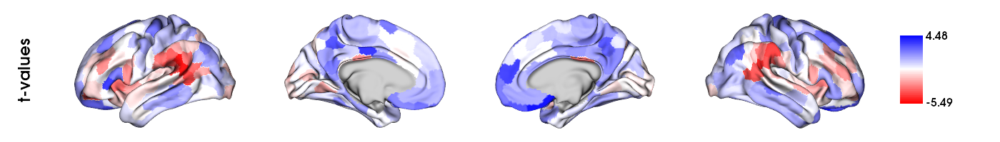

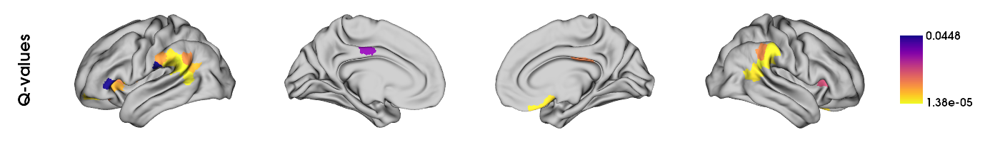

In [ ]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

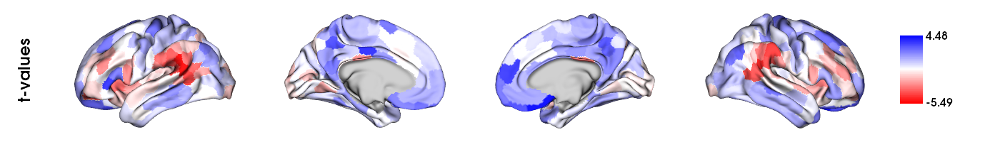

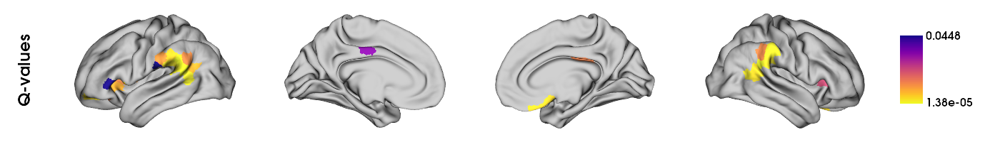

In [ ]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

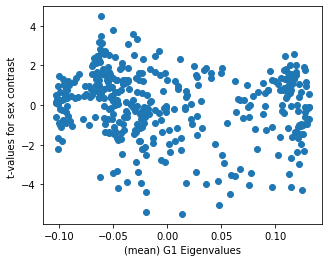

In [93]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [60]:
# loading R results

R_lm_G1_sex_age_icv_res = pd.read_csv(resdir+'R_lm_G1_sex_age_icv_res.csv')  

In [61]:
# counting number of significant parcels whilst making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later visualization)

sig_Q_vals_slm = []
count_sig = 0

for i in range(len(R_lm_G1_sex_age_icv_res.q_val_sex)):
    
    if R_lm_G1_sex_age_icv_res.q_val_sex[i] < 0.05:
        count_sig += 1
        sig_Q_vals_slm.append(R_lm_G1_sex_age_icv_res.q_val_sex[i])
        
    else:
        sig_Q_vals_slm.append(1)
        #sig_Q_vals_slm.append(float('Nan'))

print(f"Number of significant parcels: {count_sig}")

Number of significant parcels: 37


In [62]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(R_lm_G1_sex_age_icv_res.q_val_sex)):
    
    if R_lm_G1_sex_age_icv_res.q_val_sex[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(R_lm_G1_sex_age_icv_res.q_val_sex[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 37

Number of significant parcels in each Yeo network:
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 2 out of 77 (2.6%) -> 5.41% of overall significance
- DMN: 10 out of 90 (11.11%) -> 27.03% of overall significance
- dorsal attention: 1 out of 46 (2.17%) -> 2.7% of overall significance
- ventral attention: 17 out of 47 (36.17%) -> 45.95% of overall significance
- limbic: 3 out of 26 (11.54%) -> 8.11% of overall significance
- fronto parietal: 4 out of 53 (7.55%) -> 10.81% of overall significance


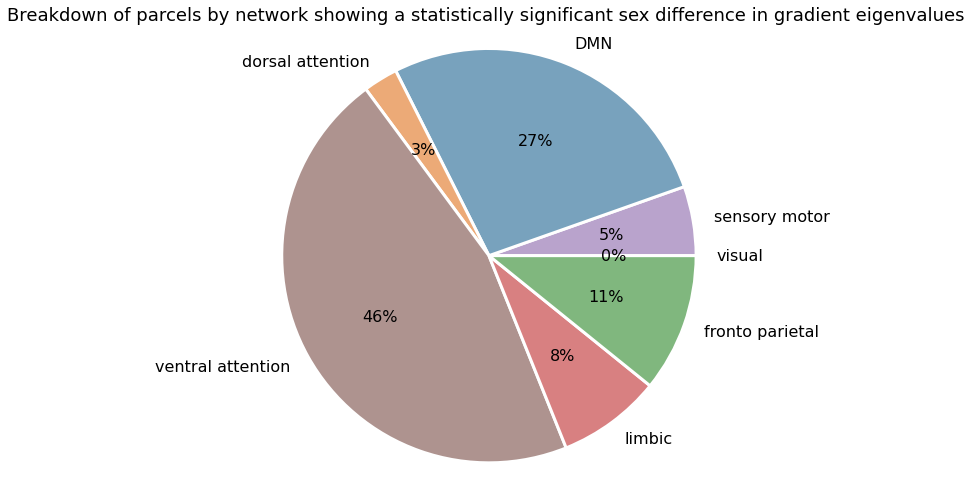

In [63]:
# setting figure size
fig, ax = plt.subplots(1, figsize=(10, 7))

# data to plot: in dictionary count_sig_per_network
network_labels = []
data = []

for x, y in count_sig_per_network.items():
    network_labels.append(x)
    data.append(y)

# define color palette to use
color_palette =[(227/255, 174/255, 211/255),  # color palette matching the raincloudplot colors (rgb found via mac's digital color meter, then /255 to obtain 0-1 values as required by plt
                (185/255, 163/255, 204/255),
                (120/255, 162/255, 189/255),
                (236/255, 170/255, 119/255),
                (174/255, 147/255, 143/255),
                (216/255, 128/255, 129/255),
                (128/255, 183/255, 126/255)]
# color_palette = sns.color_palette('pastel')[0:7]  # seaborn pastel color palette

# plot pie chart
ax.pie(data, 
       labels = network_labels, colors = color_palette, autopct='%.0f%%', 
       wedgeprops={'linewidth': 3.0, 'edgecolor': 'white'},
       textprops={'fontsize': 16})

ax.set_title('Breakdown of parcels by network showing a statistically significant sex difference in gradient eigenvalues', fontsize=18)

# display
ax.axis('equal')
plt.tight_layout()

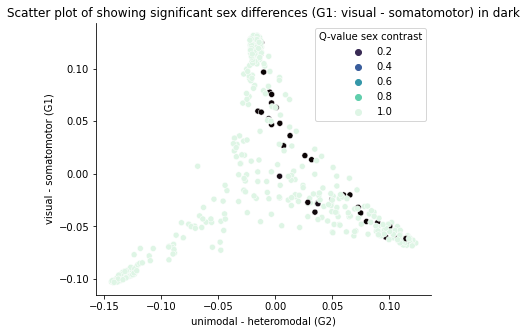

In [64]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality[:,1],  # all rows (400 parces), first column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality[:,0],  # all rows (400 parces), second column (G1: somatomotor/auditory - visual)  
                     hue=sig_Q_vals_slm,  # gives color coding based on Q value of sex contrast (main model including age, sex, icv) -> dark color: significance
                     palette=sns.color_palette("mako", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("Scatter plot of showing significant sex differences (G1: visual - somatomotor) in dark")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Q-value sex contrast')
plt.show(ax)

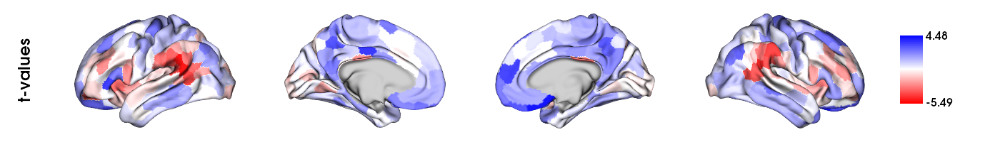

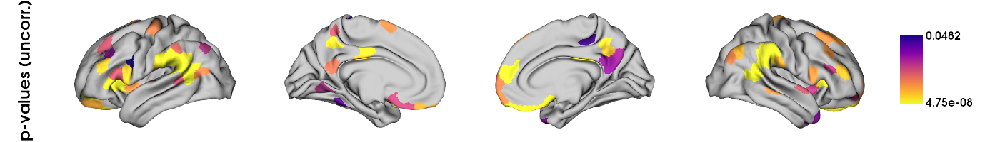

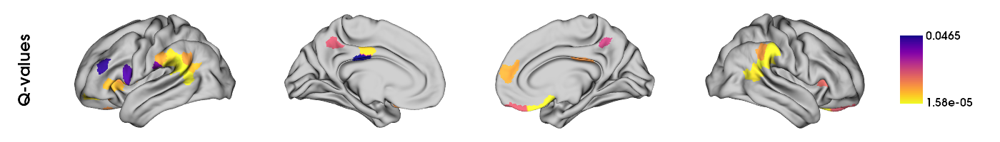

In [66]:
plots_to_display = plot_slm_results_R(R_lm_G1_sex_age_icv_res)
display(*plots_to_display)

### Gradient 2: unimodal - heteromodal

#### Python (Brainstat) lm

In [67]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G2)

In [68]:
slm_SEX_age_icv.Q

array([3.74958396e-01, 1.00000000e+00, 1.43382329e-01, 1.48146060e-01,
       3.47537047e-02, 8.86863633e-02, 6.32715643e-01, 6.15785019e-01,
       9.91187754e-02, 1.00000000e+00, 8.10027509e-03, 1.21744608e-02,
       7.01313988e-01, 8.04487377e-03, 4.09158640e-01, 1.00000000e+00,
       4.41915904e-01, 1.87895407e-01, 1.88398976e-03, 1.00000000e+00,
       6.15785019e-01, 5.21409780e-01, 3.59879226e-01, 1.00000000e+00,
       1.91538753e-01, 9.09639674e-01, 1.90109884e-02, 1.00000000e+00,
       2.63768662e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 5.81366482e-01, 2.62684651e-01,
       3.95400302e-02, 3.70961183e-01, 1.00000000e+00, 1.00000000e+00,
       7.15415292e-01, 8.41546521e-01, 7.15415292e-01, 1.00000000e+00,
       2.07377271e-01, 1.00000000e+00, 3.95400302e-02, 8.60234895e-01,
       1.00000000e+00, 1.00000000e+00, 7.70813597e-01, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 5.32032613e-01, 1.00000000e+00,
      

In [69]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(slm_SEX_age_icv.Q)):
    
    if slm_SEX_age_icv.Q[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(slm_SEX_age_icv.Q[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 85

Number of significant parcels in each Yeo network:
- visual: 18 out of 61 (29.51%) -> 21.18% of overall significance
- sensory motor: 2 out of 77 (2.6%) -> 2.35% of overall significance
- DMN: 24 out of 90 (26.67%) -> 28.24% of overall significance
- dorsal attention: 4 out of 46 (8.7%) -> 4.71% of overall significance
- ventral attention: 17 out of 47 (36.17%) -> 20.0% of overall significance
- limbic: 9 out of 26 (34.62%) -> 10.59% of overall significance
- fronto parietal: 11 out of 53 (20.75%) -> 12.94% of overall significance


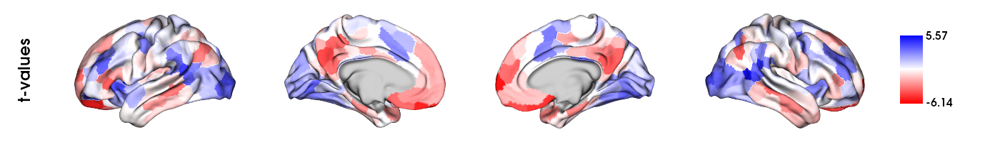

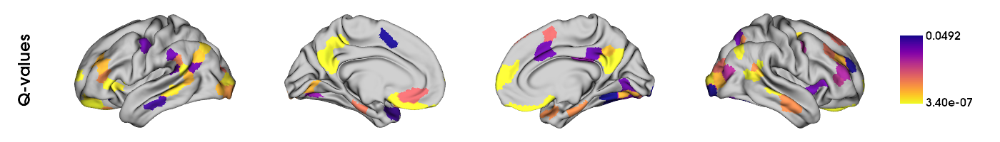

In [70]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

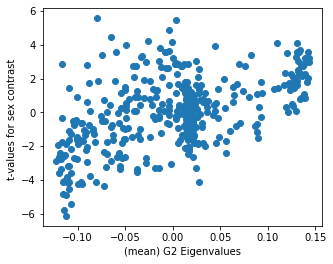

In [71]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 1], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [72]:
# loading R results

R_lm_G2_sex_age_icv_res = pd.read_csv(resdir+'R_lm_G2_sex_age_icv_res.csv')  

In [73]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(R_lm_G2_sex_age_icv_res.q_val_sex)):
    
    if R_lm_G2_sex_age_icv_res.q_val_sex[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(R_lm_G2_sex_age_icv_res.q_val_sex[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 105

Number of significant parcels in each Yeo network:
- visual: 19 out of 61 (31.15%) -> 18.1% of overall significance
- sensory motor: 3 out of 77 (3.9%) -> 2.86% of overall significance
- DMN: 33 out of 90 (36.67%) -> 31.43% of overall significance
- dorsal attention: 5 out of 46 (10.87%) -> 4.76% of overall significance
- ventral attention: 20 out of 47 (42.55%) -> 19.05% of overall significance
- limbic: 11 out of 26 (42.31%) -> 10.48% of overall significance
- fronto parietal: 14 out of 53 (26.42%) -> 13.33% of overall significance


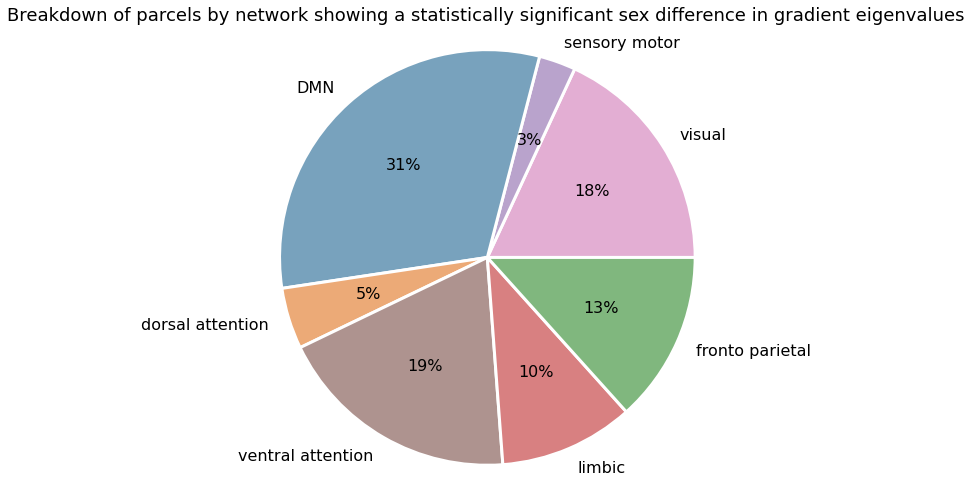

In [74]:
# setting figure size
fig, ax = plt.subplots(1, figsize=(10, 7))

# data to plot: in dictionary count_sig_per_network
network_labels = []
data = []

for x, y in count_sig_per_network.items():
    network_labels.append(x)
    data.append(y)

# define color palette to use
color_palette =[(227/255, 174/255, 211/255),  # color palette matching the raincloudplot colors (rgb found via mac's digital color meter, then /255 to obtain 0-1 values as required by plt
                (185/255, 163/255, 204/255),
                (120/255, 162/255, 189/255),
                (236/255, 170/255, 119/255),
                (174/255, 147/255, 143/255),
                (216/255, 128/255, 129/255),
                (128/255, 183/255, 126/255)]
# color_palette = sns.color_palette('pastel')[0:7]  # seaborn pastel color palette

# plot pie chart
ax.pie(data, 
       labels = network_labels, colors = color_palette, autopct='%.0f%%', 
       wedgeprops={'linewidth': 3.0, 'edgecolor': 'white'},
       textprops={'fontsize': 16})

ax.set_title('Breakdown of parcels by network showing a statistically significant sex difference in gradient eigenvalues', fontsize=18)

# display
ax.axis('equal')
plt.tight_layout()

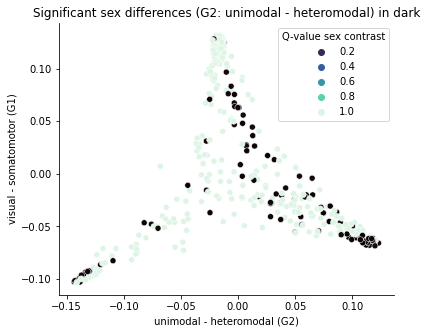

In [75]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality[:,1],  # all rows (400 parces), first column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality[:,0],  # all rows (400 parces), second column (G1: somatomotor/auditory - visual)  
                     hue=sig_Q_vals_slm,  # gives color coding based on Q value of sex contrast (main model including age, sex, icv) -> dark color: significance
                     palette=sns.color_palette("mako", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("Significant sex differences (G2: unimodal - heteromodal) in dark")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Q-value sex contrast')
plt.show(ax)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


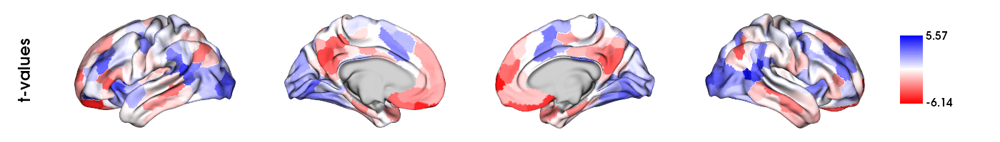

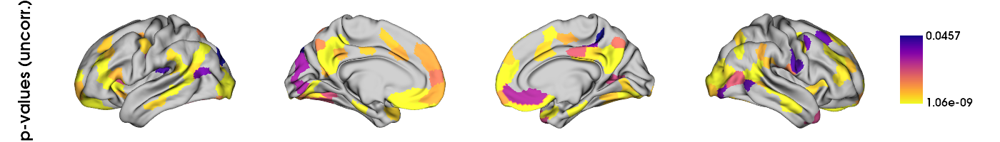

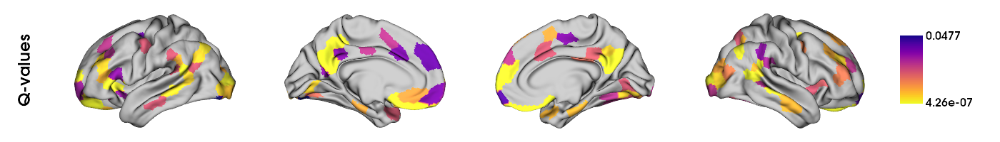

In [76]:
plots_to_display = plot_slm_results_R(R_lm_G2_sex_age_icv_res)
display(*plots_to_display)

# TO DO Visualizing sex differences in gradients

## TO DO: Goal is to replicate this figure from Hong et al https://www.nature.com/articles/s41467-019-08944-1/figures/3

**NEXT STEPS:**
- Put Males and Females side by side
- Try quiver plots to show movements of t values https://pythonforundergradengineers.com/quiver-plot-with-matplotlib-and-jupyter-notebooks.html

Preparing colorcoding for plots

**TO DO: FIND OTHER COLOR NAMES??** could only find sns color maps but not individual names...

In [112]:
# making an array with yeo network labels (names instead of numbers)
yeo7_networks_array_labels = []

for i in yeo7_networks:
    if i == '1':
        yeo7_networks_array_labels.append('visual')
    elif i == '2':
        yeo7_networks_array_labels.append('sensory motor')
    elif i == '3':
        yeo7_networks_array_labels.append('dorsal attention')
    elif i == '4':
        yeo7_networks_array_labels.append('ventral attention')
    elif i == '5':
        yeo7_networks_array_labels.append('limbic')
    elif i == '6':
        yeo7_networks_array_labels.append('fronto parietal')
    elif i == '7':
        yeo7_networks_array_labels.append('DMN')

yeo7_networks_array_labels = np.asarray(yeo7_networks_array_labels)


# dictionary color palette emphasizing visual, sensory motore, and DMN networks
palette_visual_sensmotor_DMN = {"visual":"tab:cyan",
                                "sensory motor":"tab:orange", 
                                "DMN":"tab:purple",
                                
                                "dorsal attention":"tab:grey",
                                "ventral attention":"tab:grey",
                                "limbic":"tab:grey",
                                "fronto parietal":"tab:grey"}

Color-coding all networks

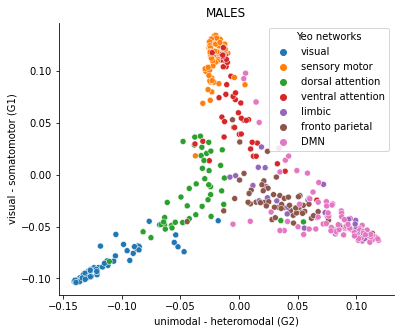

In [113]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_M[:,1],  # all rows (400 parces), first column (G2: unimodal-heteromodal)
                     y=mean_grad_hcp_directionality_M[:,0],  # all rows (400 parces), second column (G1: visual - somatomotor)                   
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     #palette=sns.color_palette("muted", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

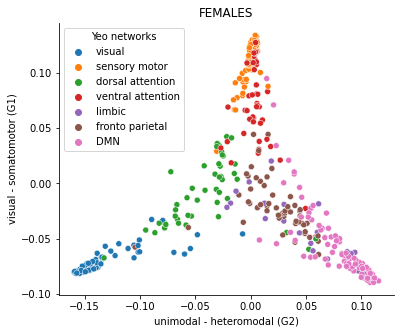

In [114]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_F[:,1],  # all rows (400 parces), first column (G2: unimodal-heteromodal)
                     y=mean_grad_hcp_directionality_F[:,0],  # all rows (400 parces), second column (G1: visual - somatomotor)                   
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     #palette=sns.color_palette("muted", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

Color-coding only networks at G1-G2 extremities (visual, sensorymotor, DMN)

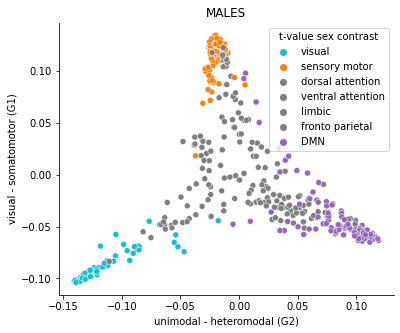

In [115]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_M[:,1],  # all rows (400 parces), first column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality_M[:,0],  # all rows (400 parces), second column (G1: visual - somatomotor)  
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks (only visual, sensory motore, DMN)
                     palette=palette_visual_sensmotor_DMN,                    
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("MALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

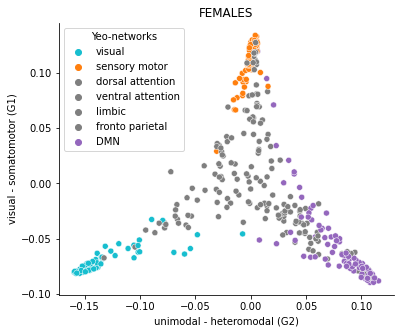

In [116]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality_F[:,1],  # all rows (400 parces), first column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality_F[:,0],  # all rows (400 parces), second column (G1: visual - somatomotor)  
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks (only visual, sensory motore, DMN)
                     palette=palette_visual_sensmotor_DMN,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("FEMALES")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo-networks')
plt.show(ax)

Scatter plots of the first 2 gradients, color coding shows t-values (**but categorical colorcoding -> NEED TO FIND A WAY TO DO IT CONTINOUS!!**)

*this was asked by Sofie, not replication of Hong et al.*

**TO DO: TROUBLESHOOTING CONTINOUS COLOR CODING**

- asked sofie if Hong's exact code is available anywhere
- can try using a different package for scatter (and not sns, e.g. https://stackoverflow.com/questions/12965075/matplotlib-scatter-plot-colour-as-function-of-third-variable specifically look for packages that will allow to color as a function of a third CONTINUOUS variable)
- ask Bin / Seyma for help?


**TO DO: WHEN FOUND A SOLUTION, ALSO EDIT THESE G1/G2 SCATTERPLOTS WITH COLORCODING BASED ON G3 (in building the gradients, both for full and unrelated sample replication)**

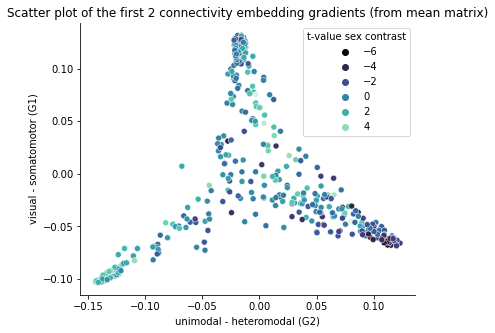

In [135]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_hcp_directionality[:,1],  # all rows (400 parces), first column (G2: unimodal - heteromodal)
                     y=mean_grad_hcp_directionality[:,0],  # all rows (400 parces), second column (G1: somatomotor/auditory - visual)  
                     hue=R_lm_G2_sex_age_icv_res.t_val_sex,  # gives color coding based on t value of sex contrast (main model including age, sex, icv)
                     palette=sns.color_palette("mako", as_cmap=True), 
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G2)');
ax.set_ylabel('visual - somatomotor (G1)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='t-value sex contrast')
plt.show(ax)

https://stackoverflow.com/questions/44641669/scatterplot-with-point-colors-representing-a-continuous-variable-in-seaborn-face problem of categorical coloring with hue >> solve to make continuous

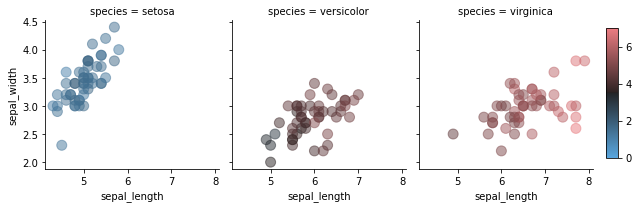

In [49]:
iris = sns.load_dataset('iris')
g = sns.FacetGrid(iris, col='species', palette = 'seismic')

def facet_scatter(x, y, c, **kwargs):
    """Draw scatterplot with point colors from a faceted DataFrame columns."""
    kwargs.pop("color")
    plt.scatter(x, y, c=c, **kwargs)

vmin, vmax = 0, 7
cmap = sns.diverging_palette(240, 10, l=65, center="dark", as_cmap=True)

g = g.map(facet_scatter, 'sepal_length', 'sepal_width', "petal_length",
          s=100, alpha=0.5, vmin=vmin, vmax=vmax, cmap=cmap)

# Make space for the colorbar
g.fig.subplots_adjust(right=.92)

# Define a new Axes where the colorbar will go
cax = g.fig.add_axes([.94, .25, .02, .6])

# Get a mappable object with the same colormap as the data
points = plt.scatter([], [], c=[], vmin=vmin, vmax=vmax, cmap=cmap)

# Draw the colorbar
g.fig.colorbar(points, cax=cax)

##### GIVEN THE PROBLEM WITH CATEGORICAL COLOR CODING, WAS TRYING TO DO A CONTINUOUS ONE FOLLOWING MARGULIES' CODE

but the color component of it does't work (see error below) - the only difference here with this jointplot is the addition of the histogram on axes

In [50]:
sns.set(style="white")
sns.set_context("notebook", font_scale=1.5)

df = pd.DataFrame()
df['e0'] = np.array(mean_grad.gradients_[:,0])
df['e1'] = np.array(mean_grad.gradients_[:,1]) #* -1 # to reorient plot

In [51]:
import matplotlib.cm as cm
import matplotlib as mpl
# import matplotlib.pyplot as plt
# import pylab as plt
# from matplotlib.colors import ListedColormap
# mpl.rcParams['svg.fonttype'] = 'none'

norm_1 = mpl.colors.Normalize(vmin=df['e0'].min(), vmax=df['e0'].max())
cmap_1 = cm.Reds
map_1 = cm.ScalarMappable(norm=norm_1, cmap=cmap_1)

norm_2 = mpl.colors.Normalize(vmin=df['e1'].min(), vmax=df['e1'].max())
cmap_2 = cm.Greens
map_2 = cm.ScalarMappable(norm=norm_2, cmap=cmap_2)

norm_3 = mpl.colors.Normalize(vmin=df['e1'].max() * -1, vmax=df['e1'].min() * -1)
cmap_3 = cm.Blues
map_3= cm.ScalarMappable(norm=norm_3, cmap=cmap_3)

c = np.ones(map_1.to_rgba(df['e0']).shape)


a = df['e1'].copy()
a = a - a.min() 
a = a / a.max()
c[:,1] = a

a = df['e1'].copy() * -1
a = a - a.min() 
a = a / a.max()
c[:,2] = a

a = df['e0'].copy()
a = a - a.min() 
a = a / a.max()
c[:,0] = a
c[:,1] = c[:,1] * ((a - 1) *  -1)
c[:,2] = c[:,2] * ((a - 1) *  -1)

In [52]:
np.array(c)

array([[0.16589219, 0.10662289, 0.72748492, 1.        ],
       [0.59927073, 0.13959622, 0.26113305, 1.        ],
       [0.05849646, 0.04325878, 0.89824477, 1.        ],
       ...,
       [0.83238482, 0.07005999, 0.09755519, 1.        ],
       [0.95836653, 0.01590039, 0.02573307, 1.        ],
       [0.65085832, 0.14182363, 0.20731806, 1.        ]])

error
- use c argument if you want to feed numbers, use color argument if you want to feed words https://cumsum.wordpress.com/2021/09/19/matplotlibvalueerror-color-kwarg-must-be-an-color-or-sequence-of-color-specs-for-a-sequence-of-values-to-be-color-mapped-use-the-c-argument-instead/ 

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:2182: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


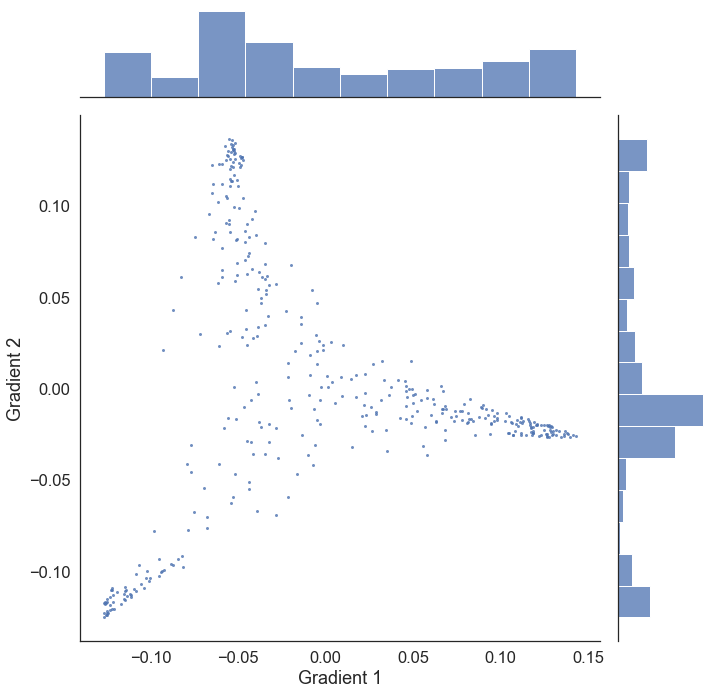

In [53]:
sns.set_context(font_scale=2)
g = sns.jointplot(x = 'e0', y = 'e1', data=df,
                  size=10, linewidth=0, marker='.', alpha=0.8,
                  

                  #c=np.array(c),  # ORIGINAL ARGUMENT
                  
                  #label='big',                   
                  #ylim = [np.min(df['e0']) - 0.5, np.max(df['e0']) + 0.5], 
                  #xlim = [np.min(df['e1']) - 0.5, np.max(df['e1']) + 0.5],
                  #stat_func=None)
                  )

g.set_axis_labels('Gradient 1', 'Gradient 2')

Margulies original code https://github.com/NeuroanatomyAndConnectivity/gradient_analysis/blob/master/03_visualize_embeddings.ipynb

In [ ]:
sns.set(style="white")
sns.set_context("notebook", font_scale=1.5)

df = pd.DataFrame()
df['e0'] = np.array(emb[range(cortLen),0])
df['e1'] = np.array(emb[range(cortLen),1]) * -1 # to reorient plot

In [ ]:
import matplotlib.cm as cm

norm_1 = mpl.colors.Normalize(vmin=df['e0'].min(), vmax=df['e0'].max())
cmap_1 = cm.Reds
map_1 = cm.ScalarMappable(norm=norm_1, cmap=cmap_1)

norm_2 = mpl.colors.Normalize(vmin=df['e1'].min(), vmax=df['e1'].max())
cmap_2 = cm.Greens
map_2 = cm.ScalarMappable(norm=norm_2, cmap=cmap_2)

norm_3 = mpl.colors.Normalize(vmin=df['e1'].max() * -1, vmax=df['e1'].min() * -1)
cmap_3 = cm.Blues
map_3= cm.ScalarMappable(norm=norm_3, cmap=cmap_3)

c = np.ones(map_1.to_rgba(df['e0']).shape)

a = df['e1'].copy()
a = a - a.min() 
a = a / a.max()
c[:,1] = a

a = df['e1'].copy() * -1
a = a - a.min() 
a = a / a.max()
c[:,2] = a

a = df['e0'].copy()
a = a - a.min() 
a = a / a.max()
c[:,0] = a
c[:,1] = c[:,1] * ((a - 1) *  -1)
c[:,2] = c[:,2] * ((a - 1) *  -1)

In [ ]:
sns.set_context(font_scale=2)
g = (sns.jointplot('e1', 'e0', 
                   data=df, 
                   size=10, label='big', linewidth=0, marker='.', c=np.array(c), alpha=0.8,
                   ylim = [np.min(df['e0']) - 0.5, np.max(df['e0']) + 0.5], 
                   xlim=[np.min(df['e1']) - 0.5, np.max(df['e1']) + 0.5],
                   stat_func=None).set_axis_labels('Gradient 2', 'Gradient 1'))

# SEX ANALYSES CODE RESUMES HERE

### Gradient 3

#### Python (Brainstat) lm

In [118]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_G3)

In [119]:
slm_SEX_age_icv.Q

array([6.55615155e-01, 7.02201054e-01, 4.22906538e-01, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 5.15959535e-01, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       7.29142666e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 8.23477012e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 9.79930157e-01,
       1.00000000e+00, 1.00000000e+00, 1.03181369e-01, 1.00000000e+00,
       5.60712817e-01, 3.16366518e-01, 2.64256721e-01, 6.18352927e-01,
       8.10673840e-02, 1.00000000e+00, 1.00000000e+00, 9.88814823e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       3.81709107e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 7.14910007e-02, 1.00000000e+00, 1.70770498e-01,
      

In [120]:
# counting number of significant parcels whilst making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)

sig_Q_vals_slm = []
count_sig = 0

for i in range(len(slm_SEX_age_icv.Q)):
    
    if slm_SEX_age_icv.Q[i] < 0.05:
        count_sig += 1
        sig_Q_vals_slm.append(slm_SEX_age_icv.Q[i])
        
    else:
        sig_Q_vals_slm.append(1)
        #sig_Q_vals_slm.append(float('Nan'))

print(f"Number of significant parcels: {count_sig}")

Number of significant parcels: 19


In [121]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(slm_SEX_age_icv.Q)):
    
    if slm_SEX_age_icv.Q[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(slm_SEX_age_icv.Q[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 19

Number of significant parcels in each Yeo network:
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 0 out of 77 (0.0%) -> 0.0% of overall significance
- DMN: 2 out of 90 (2.22%) -> 10.53% of overall significance
- dorsal attention: 5 out of 46 (10.87%) -> 26.32% of overall significance
- ventral attention: 3 out of 47 (6.38%) -> 15.79% of overall significance
- limbic: 6 out of 26 (23.08%) -> 31.58% of overall significance
- fronto parietal: 3 out of 53 (5.66%) -> 15.79% of overall significance


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


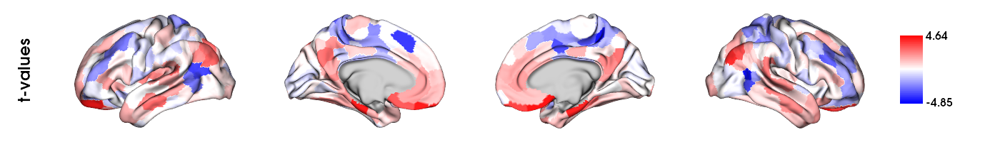

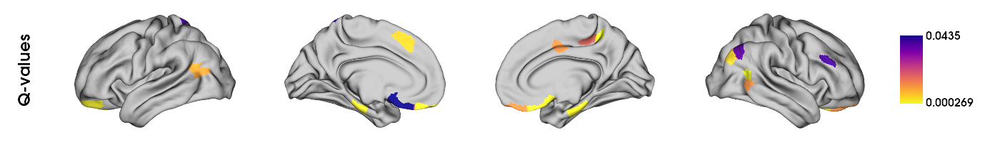

In [122]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

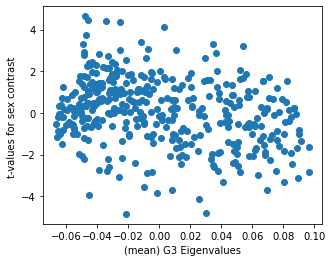

In [123]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 2], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [124]:
# loading R results

R_lm_G3_sex_age_icv_res = pd.read_csv(resdir+'R_lm_G3_sex_age_icv_res.csv')  

In [133]:
# counting number of significant parcels 
# making a list storing the Q values in a list the Q values (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network

sig_Q_vals_slm = []
count_sig = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}

for i in range(len(R_lm_G3_sex_age_icv_res.q_val_sex)):
    
    if R_lm_G3_sex_age_icv_res.q_val_sex[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(R_lm_G3_sex_age_icv_res.q_val_sex[i])
        
    else:
        sig_Q_vals_slm.append(1)

print(f"Number of significant parcels: {count_sig}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

Number of significant parcels: 26

Number of significant parcels in each Yeo network:
- visual: 1 out of 61 (1.64%) -> 3.85% of overall significance
- sensory motor: 2 out of 77 (2.6%) -> 7.69% of overall significance
- DMN: 3 out of 90 (3.33%) -> 11.54% of overall significance
- dorsal attention: 6 out of 46 (13.04%) -> 23.08% of overall significance
- ventral attention: 3 out of 47 (6.38%) -> 11.54% of overall significance
- limbic: 6 out of 26 (23.08%) -> 23.08% of overall significance
- fronto parietal: 5 out of 53 (9.43%) -> 19.23% of overall significance


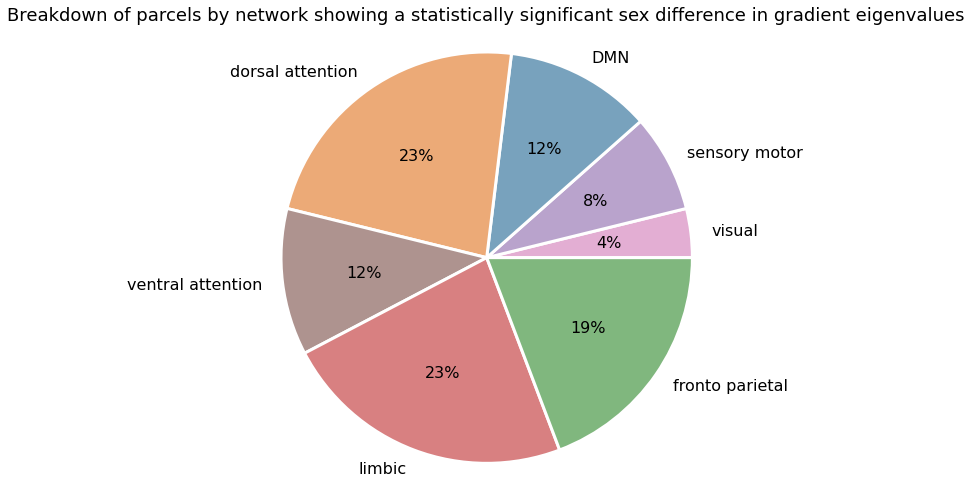

In [134]:
# setting figure size
fig, ax = plt.subplots(1, figsize=(10, 7))

# data to plot: in dictionary count_sig_per_network
network_labels = []
data = []

for x, y in count_sig_per_network.items():
    network_labels.append(x)
    data.append(y)

# define color palette to use
color_palette =[(227/255, 174/255, 211/255),  # color palette matching the raincloudplot colors (rgb found via mac's digital color meter, then /255 to obtain 0-1 values as required by plt
                (185/255, 163/255, 204/255),
                (120/255, 162/255, 189/255),
                (236/255, 170/255, 119/255),
                (174/255, 147/255, 143/255),
                (216/255, 128/255, 129/255),
                (128/255, 183/255, 126/255)]
# color_palette = sns.color_palette('pastel')[0:7]  # seaborn pastel color palette

# plot pie chart
ax.pie(data, 
       labels = network_labels, colors = color_palette, autopct='%.0f%%', 
       wedgeprops={'linewidth': 3.0, 'edgecolor': 'white'},
       textprops={'fontsize': 16})

ax.set_title('Breakdown of parcels by network showing a statistically significant sex difference in gradient eigenvalues', fontsize=18)

# display
ax.axis('equal')
plt.tight_layout()

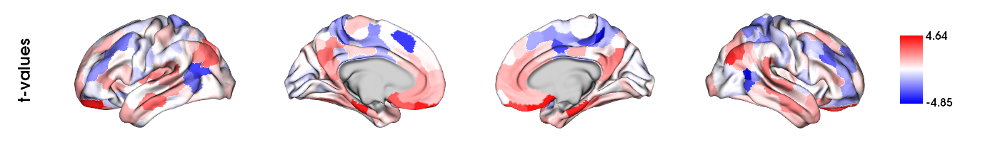

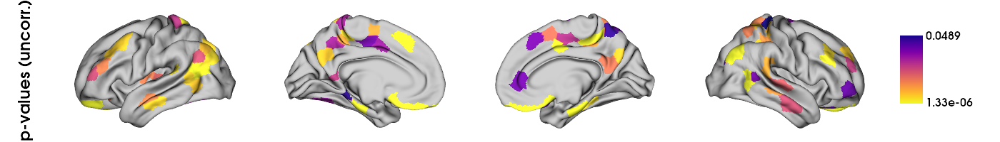

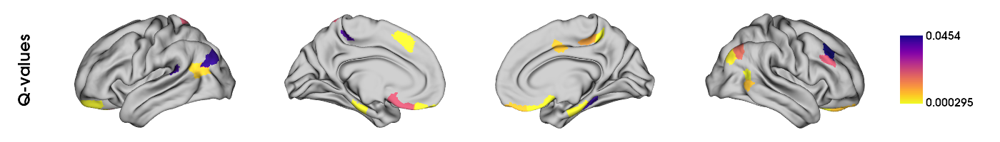

In [127]:
plots_to_display = plot_slm_results_R(R_lm_G3_sex_age_icv_res)
display(*plots_to_display)

# Meta-analytic functional decoding
##
### **how to make sense of area decoding for gradients? here did t values of sex differences, but I don't know that the results of the meta-analysis mean (correlations for what parcels?**
##

**Neurosynth via Brainstat**

https://neurosynth.org/analyses/topics/
https://github.com/neurosynth/neurosynth-data

Tweaking Neurosynth's meta_analytic_decoder:
- adding column with p-vals
- adding column with abs corrcoef
- changing to descending for abs corrcoef

In [138]:
""" Meta-analytic decoding based on NiMARE """
import re
import urllib
import zipfile
from pathlib import Path
from tempfile import NamedTemporaryFile
from typing import Generator, Optional, Sequence, Union

import nibabel as nib
import numpy as np
import pandas as pd
import templateflow.api as tflow
from brainspace.vtk_interface.wrappers.data_object import BSPolyData
from scipy.stats.stats import pearsonr

from brainstat._utils import (
    data_directories,
    deprecated,
    logger,
    read_data_fetcher_json,
)
from brainstat.mesh.interpolate import _surf2vol, multi_surface_to_volume


from brainstat.context.meta_analysis import _fetch_precomputed




def meta_analytic_decoder_bianca(
    template: str,
    stat_labels: np.ndarray,
    data_dir: Optional[Union[str, Path]] = None,
):
    """Meta-analytic decoding of surface maps using NeuroSynth or NeuroQuery.
    
    Adjusted from
    ----------
    https://brainstat.readthedocs.io/en/master/_modules/brainstat/context/meta_analysis.html#meta_analytic_decoder
    original available through: from brainstat.context.meta_analysis import meta_analytic_decoder
    
    changes output dataframe:
        - adding column with abs corrcoef
        - adding column with p-vals
        - changing to descending for abs corrcoef

    Parameters
    ----------
    template : str
        Path of a template volume file.
    stat_labels : str, numpy.ndarray, sequence of str or numpy.ndarray
        Path to a label file for the surfaces, numpy array containing the
        labels, or a list containing multiple of the aforementioned.
    data_dir : str, optional
        The directory of the dataset. If none exists, a new dataset will
        be downloaded and saved to this path. If None, the directory defaults to
        your home directory, by default None.


    Returns
    -------
    pandas.DataFrame
        Table with correlation values for each feature.
    """
    data_dir = Path(data_dir) if data_dir else data_directories["NEUROSYNTH_DATA_DIR"]
    data_dir.mkdir(exist_ok=True, parents=True)

    logger.info(
        "Fetching Neurosynth feature files. This may take several minutes if you haven't downloaded them yet."
    )
    feature_files = tuple(_fetch_precomputed(data_dir, database="neurosynth"))

    mni152 = nib.load(tflow.get("MNI152Lin", resolution=2, desc="brain", suffix="mask"))

    stat_nii = _surf2vol(template, stat_labels.flatten())
    mask = (stat_nii.get_fdata() != 0) & (mni152.get_fdata() != 0)
    stat_vector = stat_nii.get_fdata()[mask]

    feature_names = []
    #correlations = np.zeros(len(feature_files))
    
    r_coef = np.zeros(len(feature_files))
    r_coef_abs = np.zeros(len(feature_files))
    pval = np.zeros(len(feature_files))

    logger.info("Running correlations with all Neurosynth features.")
    for i in range(len(feature_files)):
        feature_names.append(re.search("__[A-Za-z0-9 ]+", feature_files[i].stem)[0][2:])  # type: ignore
        feature_data = nib.load(feature_files[i]).get_fdata()[mask]
        keep = np.logical_not(
            np.isnan(feature_data)
            | np.isinf(feature_data)
            | np.isnan(stat_vector)
            | np.isinf(stat_vector)
        )
        #correlations[i], _ = pearsonr(stat_vector[keep], feature_data[keep])
        
        r_coef[i], r_coef_abs[i], pval[i], = pearsonr(stat_vector[keep], feature_data[keep])[0], abs(pearsonr(stat_vector[keep], feature_data[keep])[0]), pearsonr(stat_vector[keep], feature_data[keep])[1]
    
    correlations = {"Pearson's r": r_coef, "Pearson's r (abs)": r_coef_abs, "p-value": pval}
    df = pd.DataFrame(correlations, index=feature_names)
    return df.sort_values(by="Pearson's r (abs)", ascending=False)

### Format data in fsaverage5

Given that I don't think that the function works with schaefer parcelation, need to tranfer data on fsaverage5's 20484 vertices

In [139]:
# fetch the fsaverage parcellation indicating which schafer parcel (1-400) each of fsaverage5's 20484 vertices belong to
schaefer_400_fs5 = fetch_parcellation("fsaverage5", "schaefer", 400)

#schaefer_400_fs5.shape

# change the 0 values to nan (values go from 0-400, so there are 401 'categories' -> I assume this means that 0 is a non-category and schaefer parcel labels go from 1-400
# !!!!! NEED TO CHECK WHAT THIS NON CATEGORY IS... SEEMS LIKE THERE IS AN ISSUE HERE (I thought it would mean "outside the grid" but I don't think fsaverage is a grid... maybe it's an areas like midline which is missing in Schaefer 400)
schaefer_400_fs5 = schaefer_400_fs5.astype('float')  # this is needed in order to run the following line
schaefer_400_fs5[schaefer_400_fs5 == 0] = np.nan

### Create a new variable (array) containing the t-values of the sex differences in G2

In [140]:
fs5_tvals_sexdif_G2 = []

# iterate over the 20484 vertices in fsaverage5
for i in range(len(schaefer_400_fs5)):
    
    #if schaefer_400_fs5[i] == 'nan'
    if isnan(schaefer_400_fs5[i]):
        # append to the list fs5_tvals_sexdif_G1: 'nan'
        fs5_tvals_sexdif_G2.append('nan')
        
    # if schaefer_400_fs5 has a value
    else:
        # append to the list fs5_tvals_sexdif_G1: the t value of the corresponding Schaefer parcel (here parcel value [i] - 1 because parcel numbers go from 1-400 instead of 0-399 as required for indexing t_val_sex)
        fs5_tvals_sexdif_G2.append(R_lm_G2_sex_age_icv_res.t_val_sex[schaefer_400_fs5[i]-1])

fs5_tvals_sexdif_G2 = np.asarray(fs5_tvals_sexdif_G2)

### Functional Decoding

In [449]:
# run meta analysis
meta_analysis_fc_G2 = meta_analytic_decoder_bianca("fsaverage5", fs5_tvals_sexdif_G2) 

2022-09-14 15:45:05,054 - brainstat - INFO - Fetching Neurosynth feature files. This may take several minutes if you haven't downloaded them yet.
2022-09-14 15:45:06,303 - brainstat - INFO - Running correlations with all Neurosynth features.


In [450]:
meta_analysis_fc_G2

,Pearson's r,Pearson's r (abs),p-value
visual cortex,0.441032,0.441032,0.000000
extrastriate,0.433980,0.433980,0.000000
gaze,0.419953,0.419953,0.000000
occipital cortex,0.415031,0.415031,0.000000
occipital,0.412931,0.412931,0.000000
...,...,...,...
node,-0.000914,0.000914,0.855745
pathophysiological,-0.000516,0.000516,0.918226
ofc,0.000476,0.000476,0.924560
episodic memory,-0.000112,0.000112,0.982278


In [452]:
# export meta analysis results to csv
meta_analysis_fc_G2.to_csv(resdir+'decoding_results_fc_G2.csv')

#
#
# Exploratory Analyses

## Gradients aligned to HCP mean gradient (instead of same data (GSP) mean gradient)

### Loading HCP mean gradients

In [200]:
array_mean_grad_hcp = pd.read_csv('/data/p_02667/sex_diff_gradients/results/HCP/array_mean_grad_hcp.csv')  
array_mean_grad_hcp = np.array(array_mean_grad_hcp)

### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [202]:
list_aligned_hcp_gradients = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_hcp_G1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_hcp_G2 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_hcp_G3 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ 
      # use ._gradients for mean_grad (mean grad was not even calculated with a reference so doesn't have ._aligned) and use .aligned_ for grad_procr 
    
    grad_procr.fit(fc_matrices_400[i], reference=array_mean_grad_hcp)  # align to the gradients of the gradients produced by the mean matrix ***** IN HCP ***** (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_hcp_gradients.append(grad_procr.aligned_)
    list_aligned_hcp_G1.append(grad_procr.aligned_.T[0])
    list_aligned_hcp_G2.append(grad_procr.aligned_.T[1])
    list_aligned_hcp_G3.append(grad_procr.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_hcp_gradients = np.array(list_aligned_hcp_gradients)
array_aligned_hcp_G1 = np.array(list_aligned_hcp_G1)
array_aligned_hcp_G2 = np.array(list_aligned_hcp_G2)
array_aligned_hcp_G3 = np.array(list_aligned_hcp_G3)

In [203]:
array_aligned_hcp_G1[1]

array([ 0.02624803,  0.11248541, -0.05884636, -0.04849426, -0.07926809,
       -0.06796965,  0.06823794, -0.06548656, -0.0627181 , -0.06519589,
       -0.07532512, -0.03899198, -0.02846352, -0.0566953 , -0.0803448 ,
       -0.05868794, -0.04511823, -0.05901629, -0.07888932, -0.05675942,
       -0.05296904, -0.06511729, -0.02583324, -0.06418907, -0.05020359,
        0.00843913, -0.07315746,  0.12817816, -0.0493363 , -0.05877243,
       -0.03050949, -0.05193668, -0.05793397, -0.04068097, -0.05449561,
       -0.03168057, -0.03784481, -0.05250726, -0.04963915, -0.05689323,
       -0.02808026, -0.05912258, -0.05148022, -0.06107708, -0.05025241,
       -0.05011619, -0.0518881 , -0.06327679, -0.06406558, -0.06526932,
       -0.06518176, -0.0569893 , -0.06273257, -0.03766768, -0.04740918,
       -0.06471763, -0.06010071, -0.0389973 , -0.06164027, -0.05304727,
       -0.06402674, -0.0483715 , -0.04419727, -0.03733804, -0.06394128,
       -0.05304585, -0.04568957, -0.05013748, -0.01797406,  0.00

#### Exporting Gradients to csv for R analyses

In [204]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir+'exploratory/array_aligned_hcp_G1.csv', array_aligned_hcp_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'exploratory/array_aligned_hcp_G2.csv', array_aligned_hcp_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir+'exploratory/array_aligned_hcp_G3.csv', array_aligned_hcp_G3, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

### Mean gradients by sex (plots Males vs Females) -> same as above for gradients normally aligned to GSP mean gradients -> so we skip here

### Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

#### Gradient 1

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [206]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1_aligned_hcp = pd.DataFrame(array_aligned_hcp_G1.T)

# adding a column containing the Yeo network labels
df_G1_aligned_hcp['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "1", "yeo network"] = "visual"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_aligned_hcp.loc[df_G1_aligned_hcp["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1_aligned_hcp = df_G1_aligned_hcp.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1_aligned_hcp["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_aligned_hcp.index.name = "sub"
df_G1_aligned_hcp = df_G1_aligned_hcp.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_aligned_hcp=pd.melt(df_G1_aligned_hcp, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1_aligned_hcp["across sexes"] = [1] * 10976

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

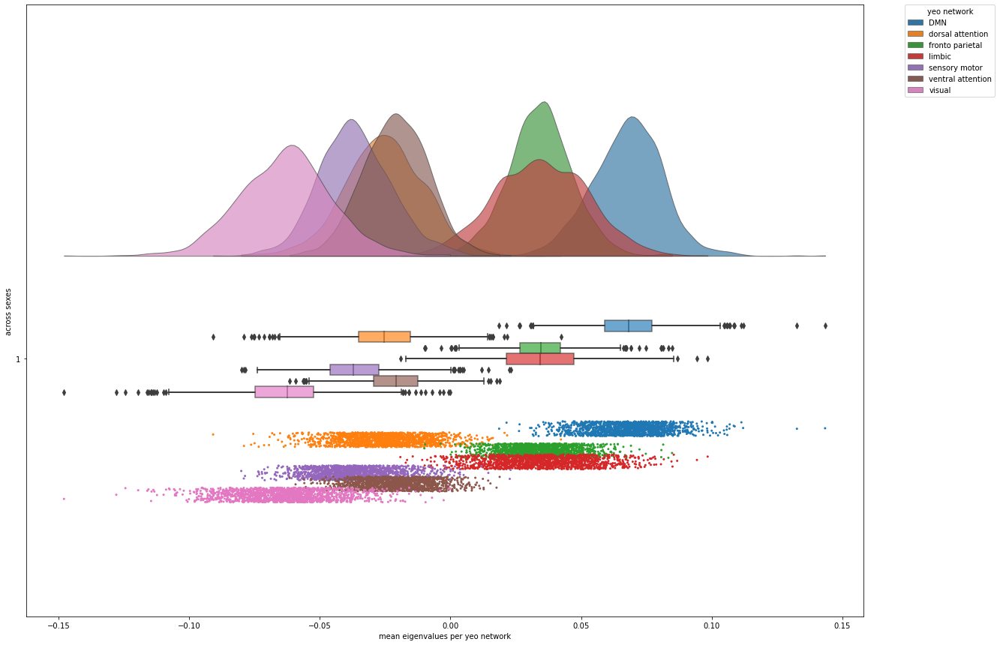

In [207]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

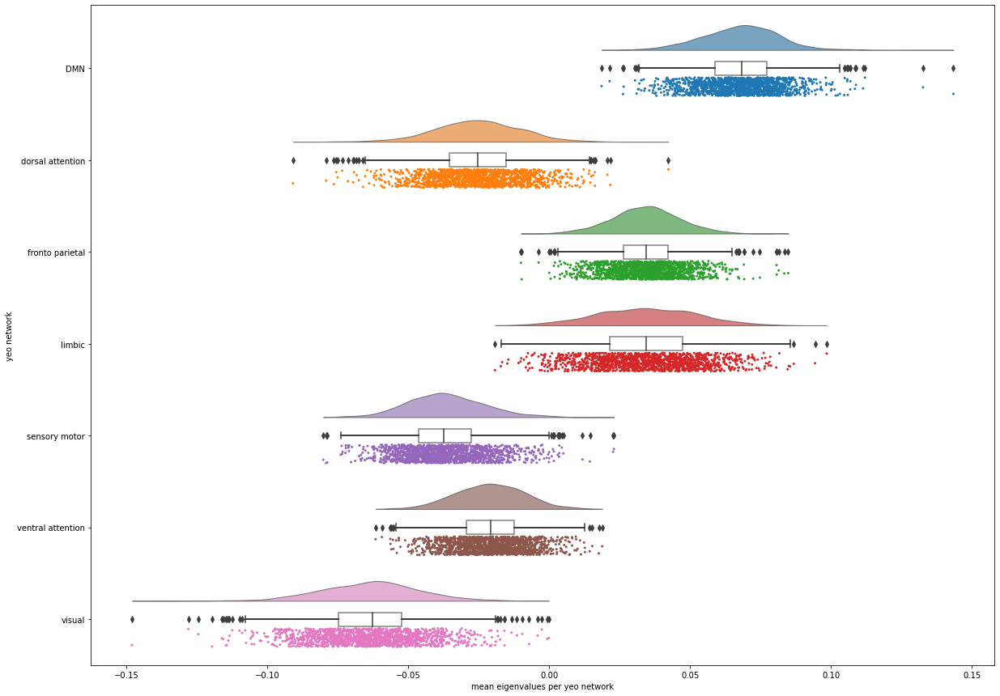

In [208]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G1_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks)

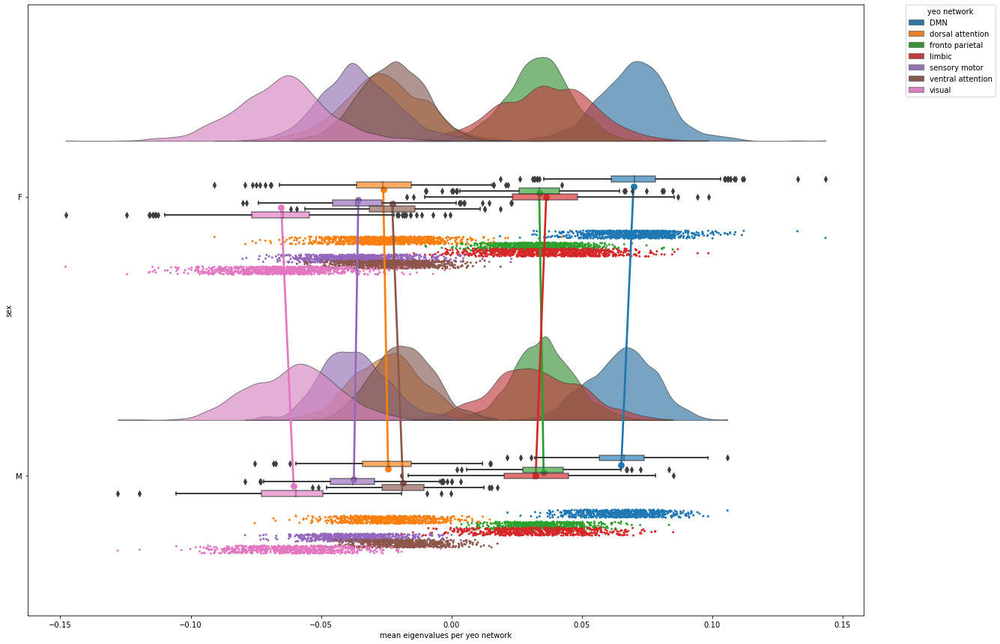

In [209]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

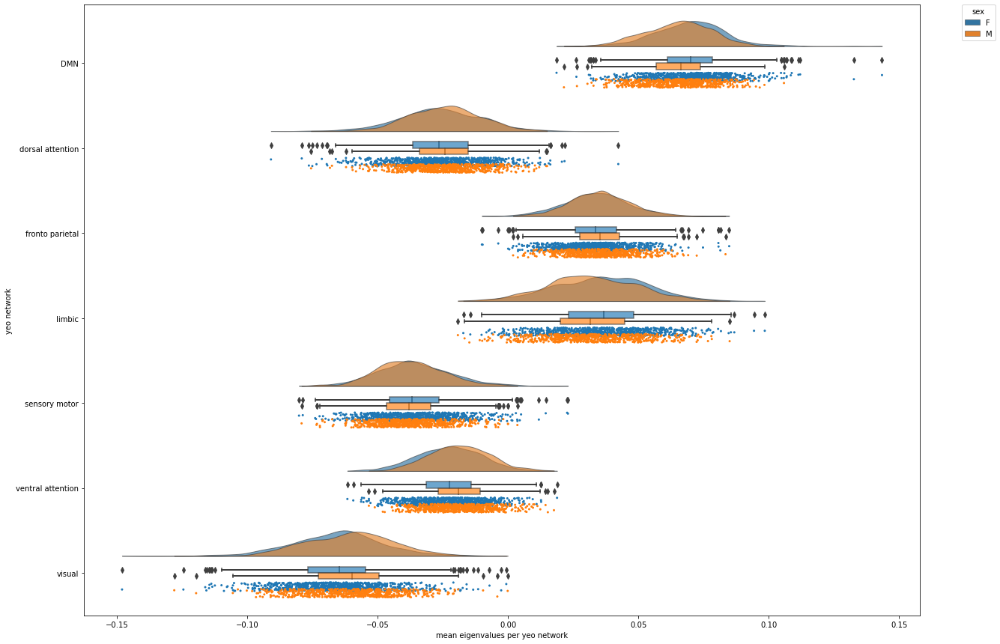

In [210]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 2

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [211]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2_aligned_hcp = pd.DataFrame((array_aligned_hcp_G2.T)*-1)

# adding a column containing the Yeo network labels
df_G2_aligned_hcp['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "1", "yeo network"] = "visual"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_aligned_hcp.loc[df_G2_aligned_hcp["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2_aligned_hcp = df_G2_aligned_hcp.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2_aligned_hcp["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_aligned_hcp.index.name = "sub"
df_G2_aligned_hcp = df_G2_aligned_hcp.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_aligned_hcp=pd.melt(df_G2_aligned_hcp, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2_aligned_hcp["across sexes"] = [1] * 10976

##### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

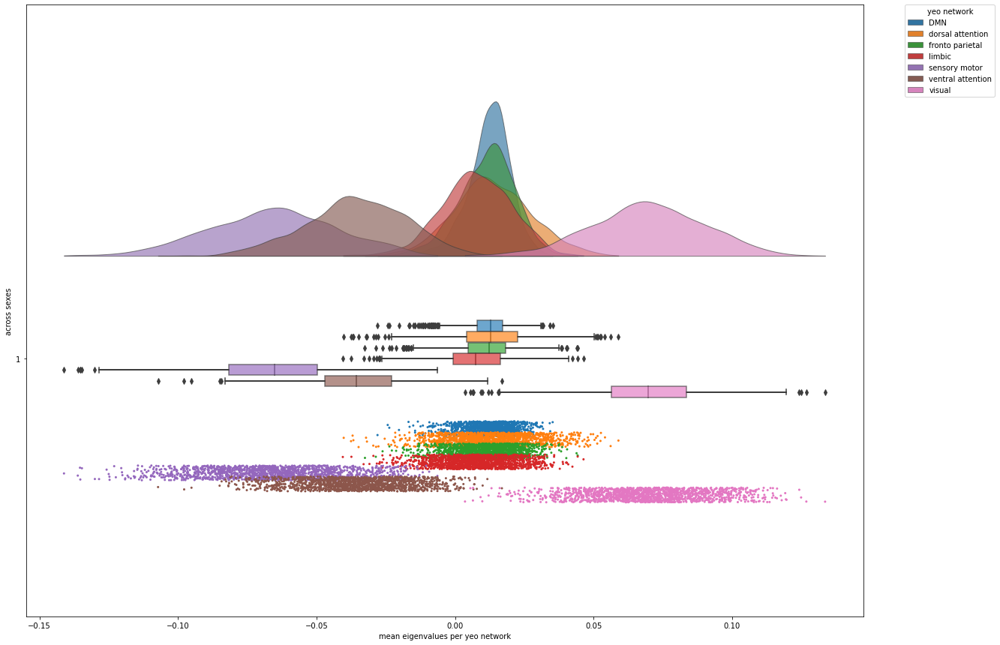

In [212]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

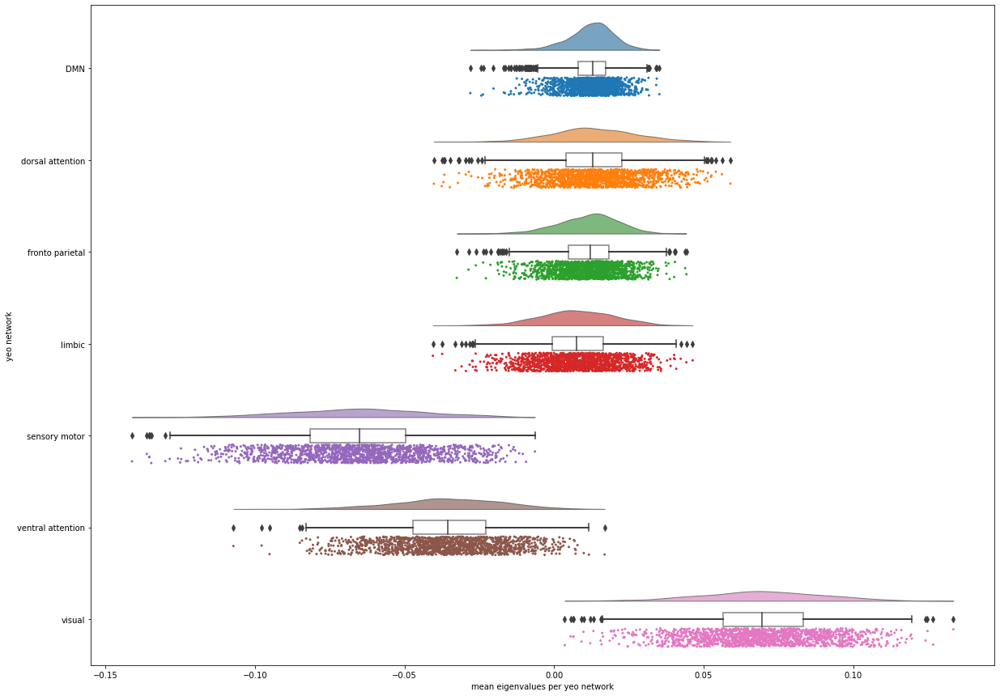

In [213]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G2_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks) 


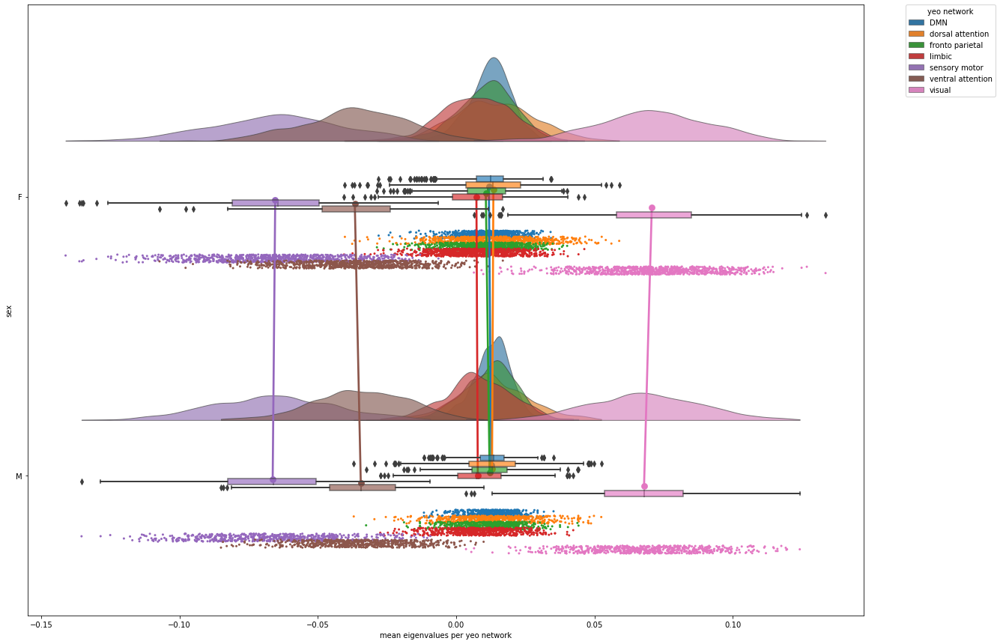

In [214]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

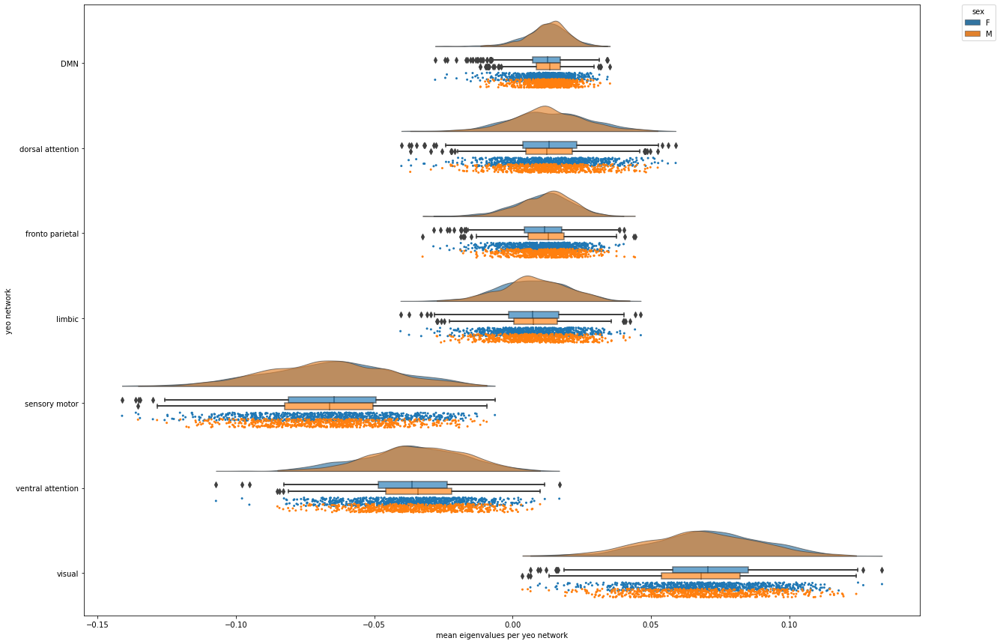

In [215]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [216]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3_aligned_hcp = pd.DataFrame(array_aligned_hcp_G3.T)

# adding a column containing the Yeo network labels
df_G3_aligned_hcp['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "1", "yeo network"] = "visual"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_aligned_hcp.loc[df_G3_aligned_hcp["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3_aligned_hcp = df_G3_aligned_hcp.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3_aligned_hcp["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_aligned_hcp.index.name = "sub"
df_G3_aligned_hcp = df_G3_aligned_hcp.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_aligned_hcp=pd.melt(df_G3_aligned_hcp, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3_aligned_hcp["across sexes"] = [1] * 10976

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
10976 data points (1568 subjects * 7 networks) 

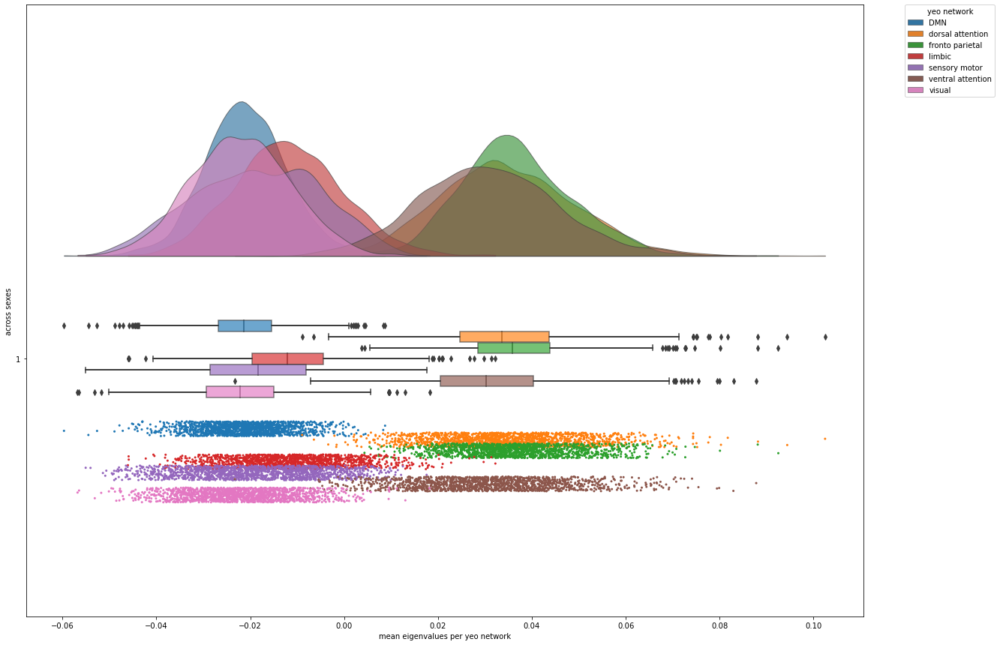

In [217]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

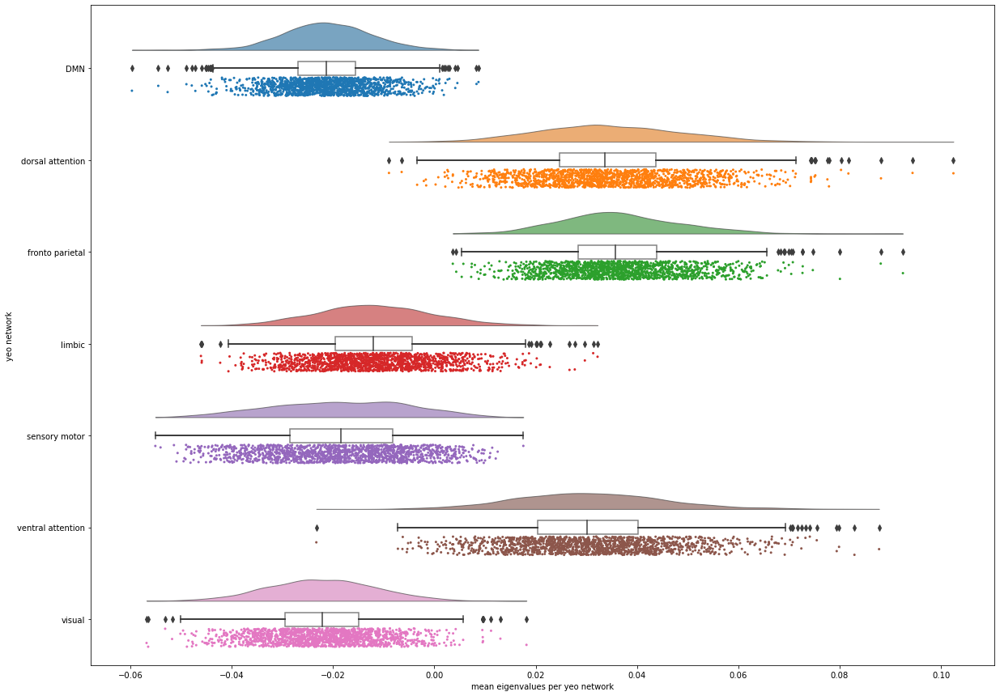

In [218]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                #hue="yeo network",
                data=df_G3_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

10976 data points (1568 subjects * 7 networks) 

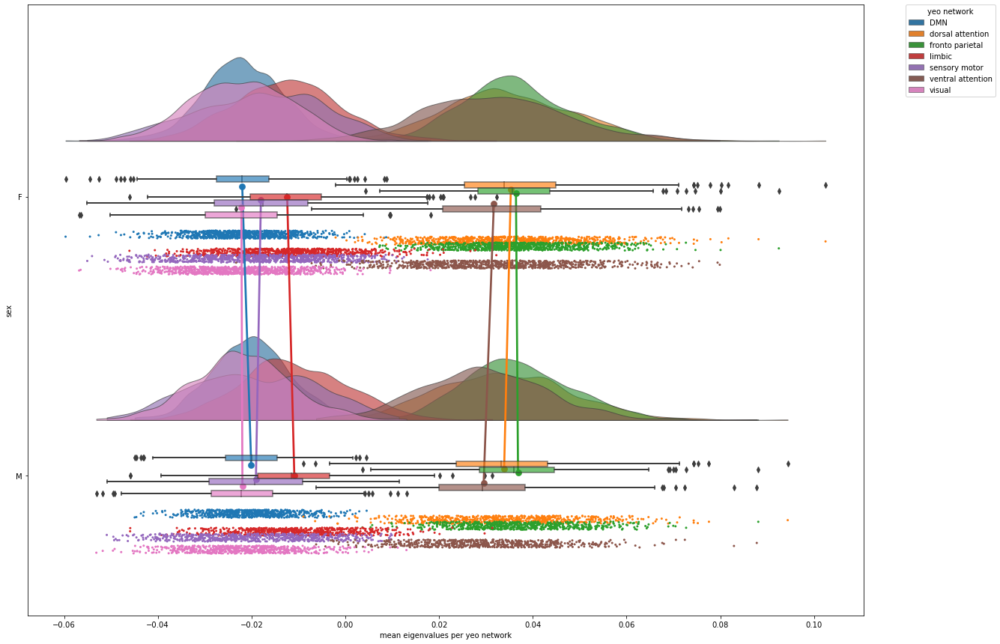

In [219]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

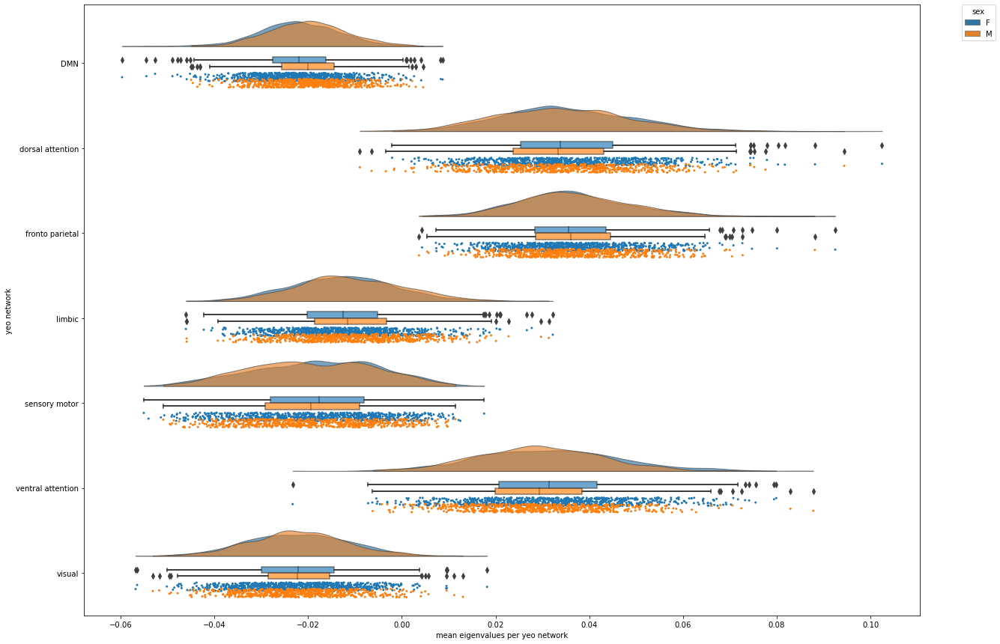

In [220]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3_aligned_hcp,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

#### Gradient 1

##### Python (Brainstat) lm

In [221]:
### creating model terms

term_sex = FixedEffect(demographics_cleaned.Sex)
term_age = FixedEffect(demographics_cleaned.Age_Bin)
term_icv = FixedEffect(demographics_cleaned.ICV)


### defining contrast to test: sex differences

contrast_sex = (demographics_cleaned.Sex == "M").astype(int) - (demographics_cleaned.Sex == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv = term_sex + term_age + term_icv  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_hcp_G1)

In [222]:
slm_SEX_age_icv.Q

array([5.81296623e-01, 1.00000000e+00, 7.85044070e-02, 9.32712422e-02,
       1.51501909e-02, 5.65851439e-02, 3.93276221e-01, 3.44607161e-01,
       3.65448373e-02, 2.70835901e-01, 1.50455358e-03, 1.86517303e-03,
       7.46994489e-01, 1.92087831e-03, 2.51989870e-01, 1.00000000e+00,
       3.55746058e-01, 1.11132953e-01, 4.88623612e-04, 1.00000000e+00,
       2.05750775e-01, 3.18515972e-01, 3.68590615e-01, 6.02954581e-01,
       9.98958385e-02, 7.00258079e-01, 1.23206654e-02, 1.00000000e+00,
       1.37705818e-01, 1.00000000e+00, 1.00000000e+00, 8.48496324e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.94822103e-03, 1.63045076e-01, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 6.60276254e-01, 1.00000000e+00,
       1.68570604e-01, 1.00000000e+00, 1.62428116e-01, 7.76181604e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 5.15851771e-01, 1.00000000e+00,
      

In [223]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 84


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


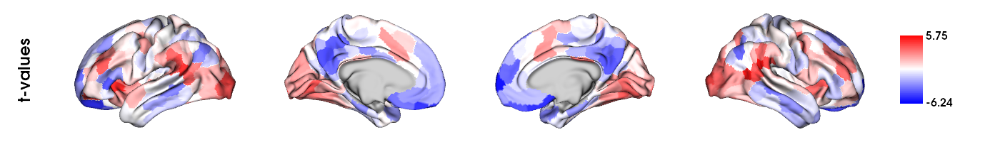

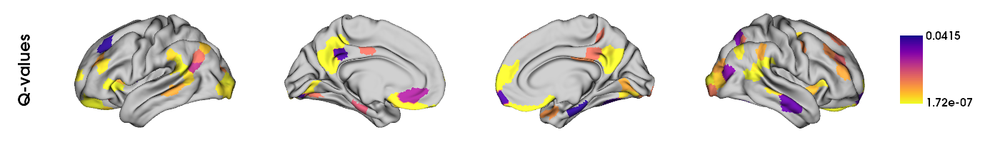

In [224]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

##### R lm visualization

In [236]:
# loading R results

R_lm_G1_sex_age_icv_res_hcp_aligned = pd.read_csv(resdir+'exploratory/R_lm_G1_sex_age_icv_res_hcp_aligned.csv')  

In [239]:
sig = []
for i in range(len(R_lm_G1_sex_age_icv_res_hcp_aligned.q_val_sex)):
    if R_lm_G1_sex_age_icv_res_hcp_aligned.q_val_sex[i] < 0.05:
        sig.append(R_lm_G1_sex_age_icv_res_hcp_aligned.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 105


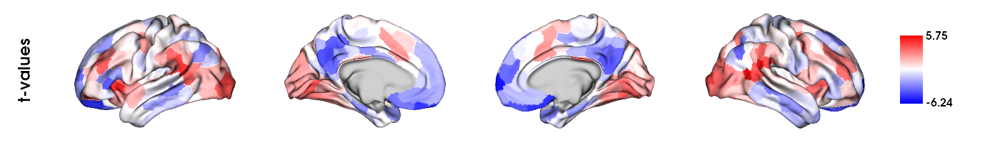

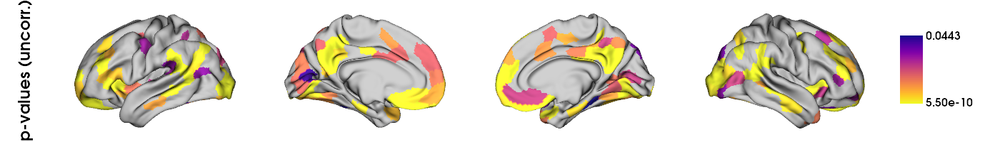

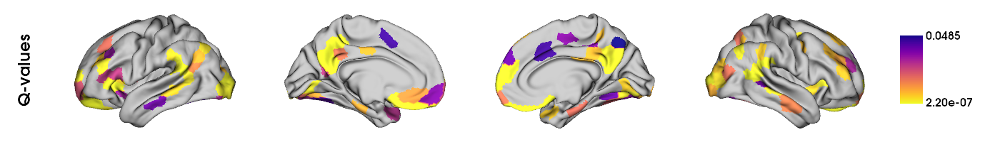

In [241]:
plots_to_display = plot_slm_results_R(R_lm_G1_sex_age_icv_res_hcp_aligned)
display(*plots_to_display)

#### Gradient 2

##### Python (Brainstat) lm

In [262]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_hcp_G2)

In [263]:
slm_SEX_age_icv.Q

array([8.52205260e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 6.77240114e-01, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       8.58467886e-01, 8.87079235e-01, 6.77240114e-01, 4.92871891e-01,
       1.35278863e-03, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 6.69212751e-02, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       8.73705462e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 8.73705462e-01, 1.00000000e+00, 1.00000000e+00,
      

In [264]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 15


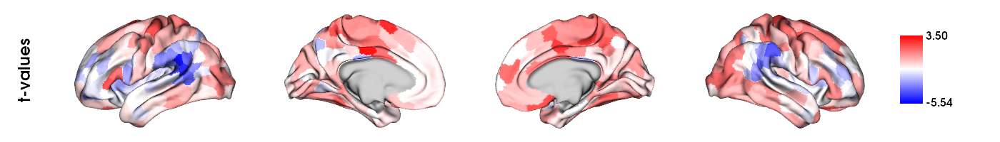

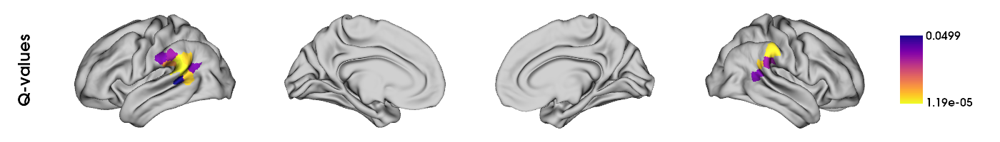

In [265]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

##### R lm visualization

In [266]:
# loading R results

R_lm_G2_sex_age_icv_res_hcp_aligned = pd.read_csv(resdir+'exploratory/R_lm_G2_sex_age_icv_res_hcp_aligned.csv')  

In [267]:
sig = []
for i in range(len(R_lm_G2_sex_age_icv_res_hcp_aligned.q_val_sex)):
    if R_lm_G2_sex_age_icv_res_hcp_aligned.q_val_sex[i] < 0.05:
        sig.append(R_lm_G2_sex_age_icv_res_hcp_aligned.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 19


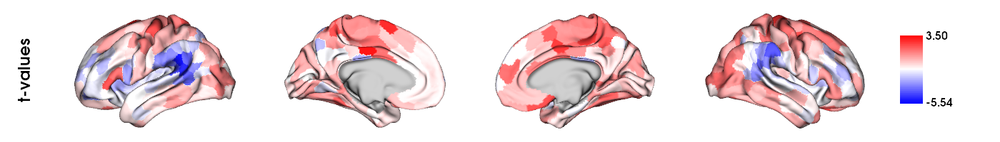

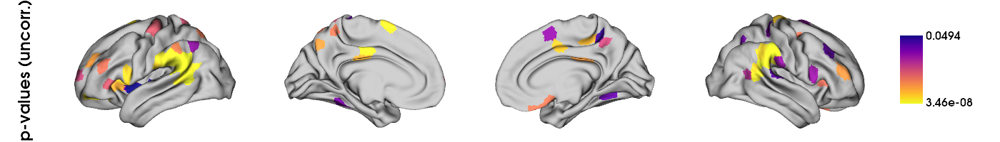

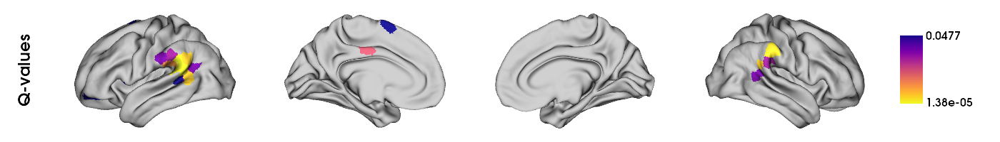

In [268]:
plots_to_display = plot_slm_results_R(R_lm_G2_sex_age_icv_res_hcp_aligned)
display(*plots_to_display)

#### Gradient 3

##### Python (Brainstat) lm

In [269]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_aligned_hcp_G3)

In [270]:
slm_SEX_age_icv.Q

array([8.00394022e-01, 7.25263255e-01, 4.34060255e-01, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 5.15758183e-01, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       6.17846288e-01, 1.00000000e+00, 1.00000000e+00, 9.24368690e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 6.83436029e-01,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.10813132e-01, 1.00000000e+00,
       6.83436029e-01, 2.74096483e-01, 2.91448628e-01, 7.62748780e-01,
       4.70719045e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       2.72567786e-01, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 4.13576562e-02, 1.00000000e+00, 1.21499935e-01,
      

In [271]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 19


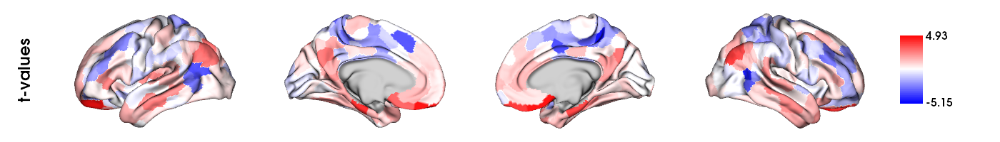

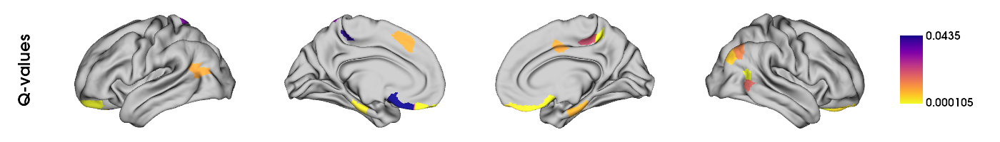

In [272]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

##### R lm visualization

In [273]:
# loading R results

R_lm_G3_sex_age_icv_res_hcp_aligned = pd.read_csv(resdir+'exploratory/R_lm_G3_sex_age_icv_res_hcp_aligned.csv')  

In [274]:
sig = []
for i in range(len(R_lm_G3_sex_age_icv_res_hcp_aligned.q_val_sex)):
    if R_lm_G3_sex_age_icv_res_hcp_aligned.q_val_sex[i] < 0.05:
        sig.append(R_lm_G3_sex_age_icv_res_hcp_aligned.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 27


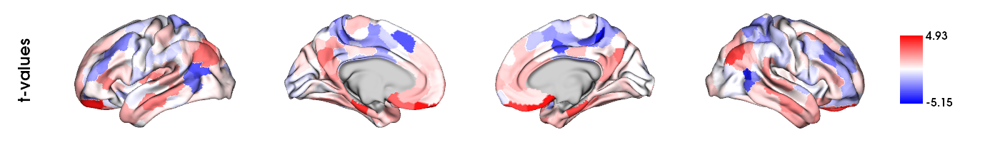

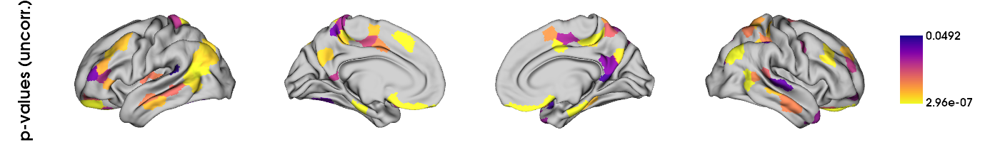

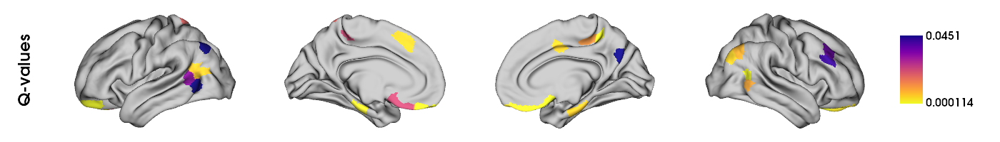

In [275]:
plots_to_display = plot_slm_results_R(R_lm_G3_sex_age_icv_res_hcp_aligned)
display(*plots_to_display)

#
#
# -------------------------------------------------------
# I HAVEN'T YET RERUN CODE BELOW HERE:
# -------------------------------------------------------

## Model without ICV (model = sex + age) for G1, G2, G3

In [92]:
### model terms and sex contrast have already been created above

### defining the model = sex + age
model_sex_age = term_sex + term_age

### fitting the model for sex effects
slm_SEX_age = SLM(
    model_sex_age,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)

### G1

#### Python (Brainstat) lm

In [94]:
# fitting the model for DV = G1
slm_SEX_age.fit(array_aligned_G1)

In [95]:
sig = []
for i in range(len(slm_SEX_age.Q)):
    if slm_SEX_age.Q[i] < 0.05:
        sig.append(slm_SEX_age.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 168


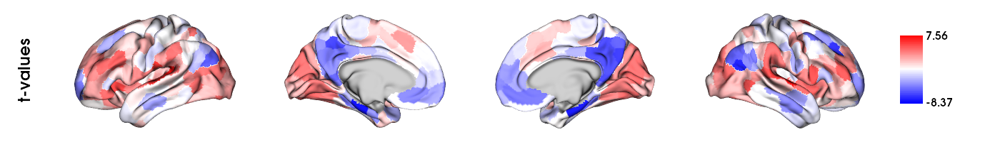

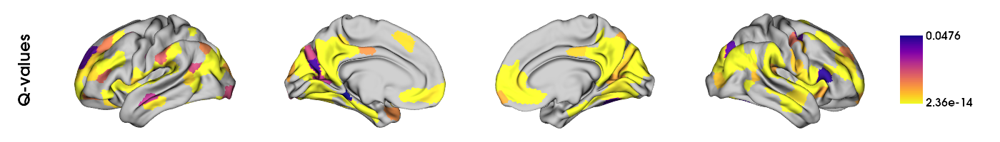

In [96]:
plots_to_display = plot_slm_results(slm_SEX_age)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in model = sex + age

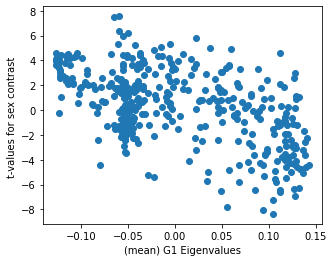

In [97]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [98]:
# loading R results

R_lm_G1_sex_age_res = pd.read_csv(resdir+'R_lm_G1_sex_age_res.csv')  

In [99]:
sig = []
for i in range(len(R_lm_G1_sex_age_res.q_val_sex)):
    if R_lm_G1_sex_age_res.q_val_sex[i] < 0.05:
        sig.append(R_lm_G1_sex_age_res.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 191


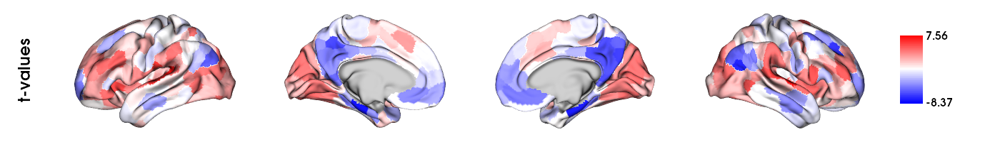

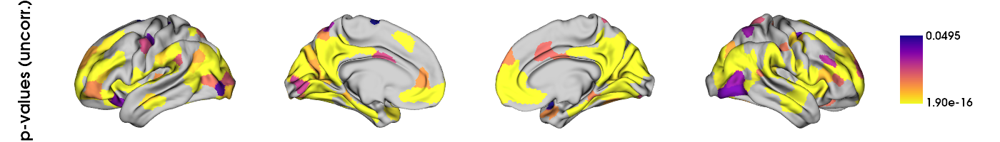

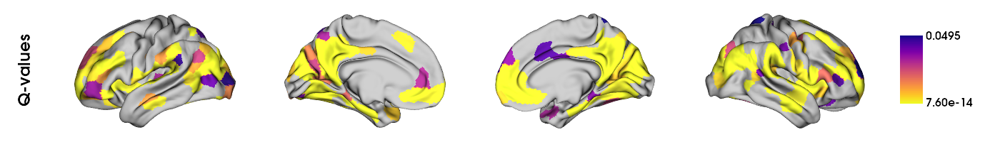

In [100]:
plots_to_display = plot_slm_results_R(R_lm_G1_sex_age_res)
display(*plots_to_display)

### G2

#### Python (Brainstat) lm

In [101]:
# fitting the model for DV = G2
slm_SEX_age.fit(array_aligned_G2)

In [102]:
sig = []
for i in range(len(slm_SEX_age.Q)):
    if slm_SEX_age.Q[i] < 0.05:
        sig.append(slm_SEX_age.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 49


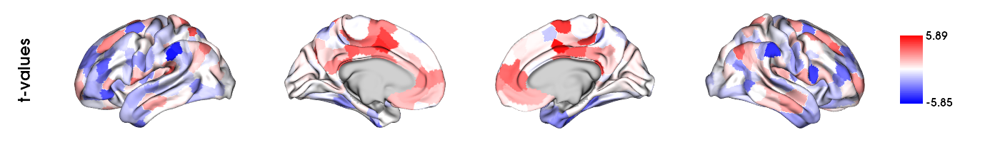

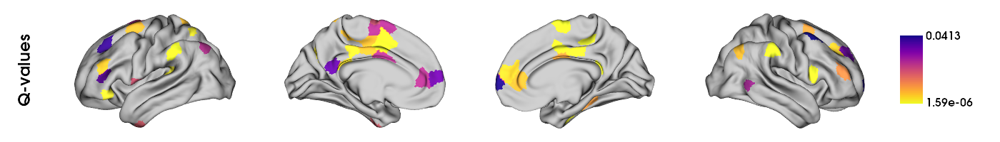

In [103]:
plots_to_display = plot_slm_results(slm_SEX_age)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in model = sex + age

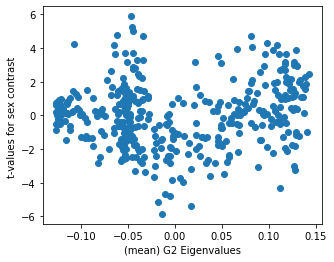

In [104]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [105]:
# loading R results

R_lm_G2_sex_age_res = pd.read_csv(resdir+'R_lm_G2_sex_age_res.csv')  

In [106]:
sig = []
for i in range(len(R_lm_G2_sex_age_res.q_val_sex)):
    if R_lm_G2_sex_age_res.q_val_sex[i] < 0.05:
        sig.append(R_lm_G2_sex_age_res.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 68


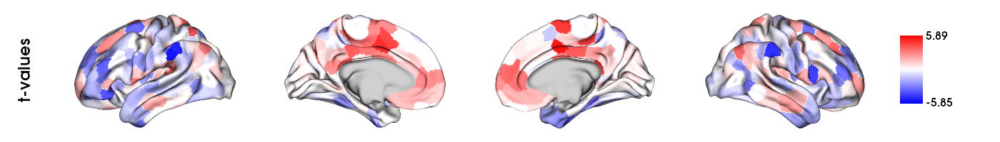

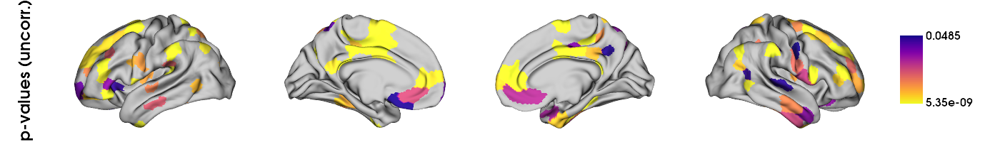

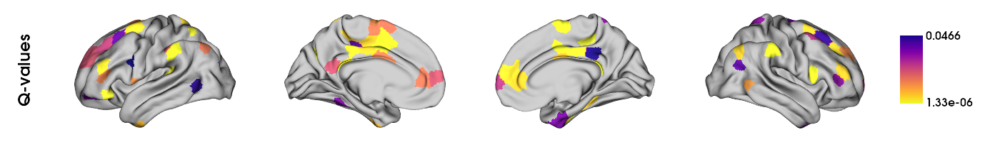

In [107]:
plots_to_display = plot_slm_results_R(R_lm_G2_sex_age_res)
display(*plots_to_display)

### G3

#### Python (Brainstat) lm

In [108]:
# fitting the model for DV = G3
slm_SEX_age.fit(array_aligned_G3)

In [109]:
sig = []
for i in range(len(slm_SEX_age.Q)):
    if slm_SEX_age.Q[i] < 0.05:
        sig.append(slm_SEX_age.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 94


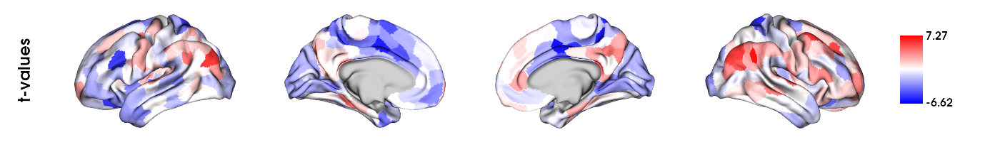

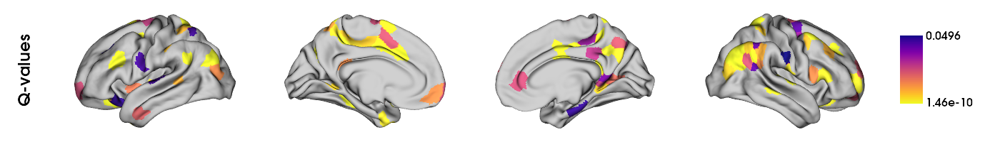

In [110]:
plots_to_display = plot_slm_results(slm_SEX_age)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in model = sex + age

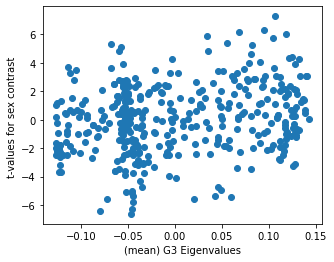

In [111]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### R lm visualization

In [112]:
# loading R results

R_lm_G3_sex_age_res = pd.read_csv(resdir+'R_lm_G3_sex_age_res.csv')  

In [113]:
sig = []
for i in range(len(R_lm_G3_sex_age_res.q_val_sex)):
    if R_lm_G3_sex_age_res.q_val_sex[i] < 0.05:
        sig.append(R_lm_G3_sex_age_res.q_val_sex)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 120


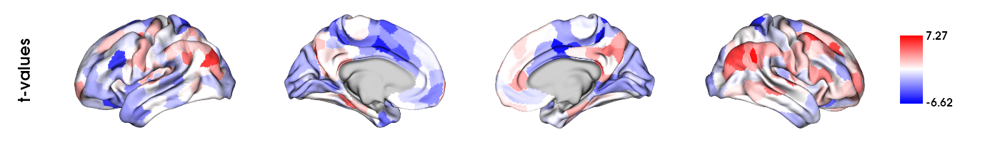

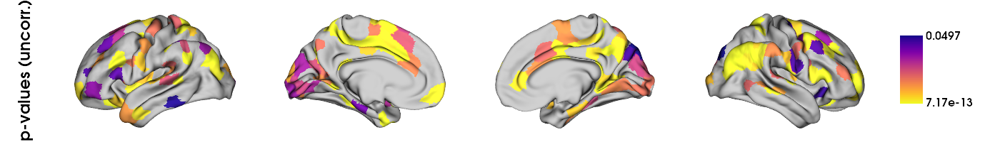

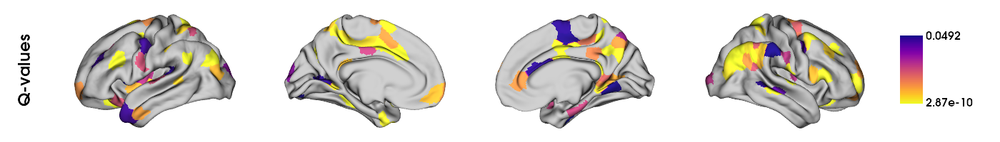

In [114]:
plots_to_display = plot_slm_results_R(R_lm_G3_sex_age_res)
display(*plots_to_display)

# Replication Analyses

## PCA (instead of diffusion embedding) to construct gradients

### Constructing gradients

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [229]:
# GradientMaps function used to build the model parameters
mean_grad_pca = GradientMaps(n_components = 10, random_state = 0, approach = 'pca', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_pca.fit(mean_fc_matrix)

GradientMaps(approach='pca', kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


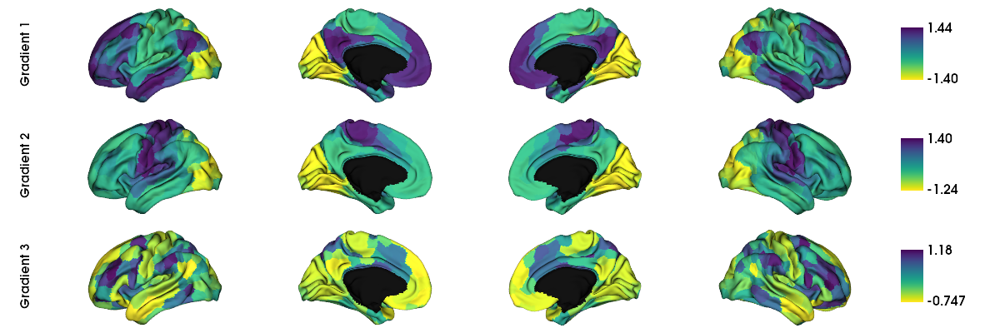

In [230]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad_pca.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

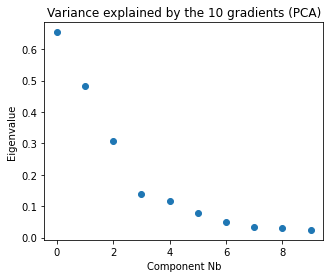

In [231]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad_pca.lambdas_.size), mean_grad_pca.lambdas_)
ax.set_title("Variance explained by the 10 gradients (PCA)")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

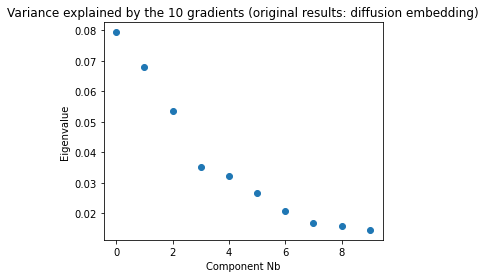

In [232]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad.lambdas_.size), mean_grad.lambdas_)
ax.set_title("Variance explained by the 10 gradients (original results: diffusion embedding)")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [233]:
print(f"Total amount of variance explained by the {len(mean_grad_pca.lambdas_)} gradients (uncorrected sum lambdas) - PCA: {sum(mean_grad_pca.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_pca.lambdas_[0]/sum(mean_grad_pca.lambdas_)*100:.2f}%\nG2: {mean_grad_pca.lambdas_[1]/sum(mean_grad_pca.lambdas_)*100:.2f}%\nG3: {mean_grad_pca.lambdas_[2]/sum(mean_grad_pca.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) - PCA: 1.91

Scaled variance explained by individual gradients:
G1: 34.17%
G2: 25.22%
G3: 16.06%



In [234]:
print(f"Total amount of variance explained by the {len(mean_grad.lambdas_)} gradients (uncorrected sum lambdas) - original resutls diffusion embedding: {sum(mean_grad.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad.lambdas_[0]/sum(mean_grad.lambdas_)*100:.2f}%\nG2: {mean_grad.lambdas_[1]/sum(mean_grad.lambdas_)*100:.2f}%\nG3: {mean_grad.lambdas_[2]/sum(mean_grad.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas) - original resutls diffusion embedding: 0.36

Scaled variance explained by individual gradients:
G1: 21.85%
G2: 18.71%
G3: 14.74%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

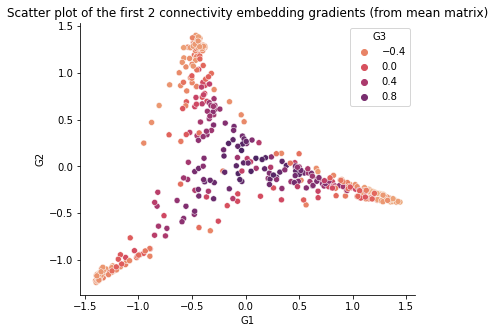

In [235]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_pca.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_pca.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad_pca.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

#### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [236]:
list_aligned_gradients_pca = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr_pca = GradientMaps(n_components=10, random_state=0, approach='pca', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr_pca.fit(fc_matrices_400[i], reference=mean_grad_pca.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients_pca.append(grad_procr_pca.aligned_)
    list_aligned_G1_pca.append(grad_procr_pca.aligned_.T[0])
    list_aligned_G2_pca.append(grad_procr_pca.aligned_.T[1])
    list_aligned_G3_pca.append(grad_procr_pca.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients_pca = np.array(list_aligned_gradients_pca)
array_aligned_G1_pca = np.array(list_aligned_G1_pca)
array_aligned_G2_pca = np.array(list_aligned_G2_pca)
array_aligned_G3_pca = np.array(list_aligned_G3_pca)

### Visualizing gradients by network

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

#### Gradient 1

Create a DataFrame containing the Gradient 1 eigenvalues and labelled Yeo 7 networks

In [237]:
# dataframe of the G1 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G1_pca = pd.DataFrame(array_aligned_G1_pca.T)

# adding a column containing the Yeo network labels
df_G1_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_pca.loc[df_G1_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G1_pca.loc[df_G1_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_pca.loc[df_G1_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_pca.loc[df_G1_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_pca.loc[df_G1_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_pca.loc[df_G1_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_pca.loc[df_G1_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G1_pca = df_G1_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G1_pca["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_pca.index.name = "sub"
df_G1_pca = df_G1_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_pca=pd.melt(df_G1_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G1_pca["across sexes"] = [1] * 7098

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

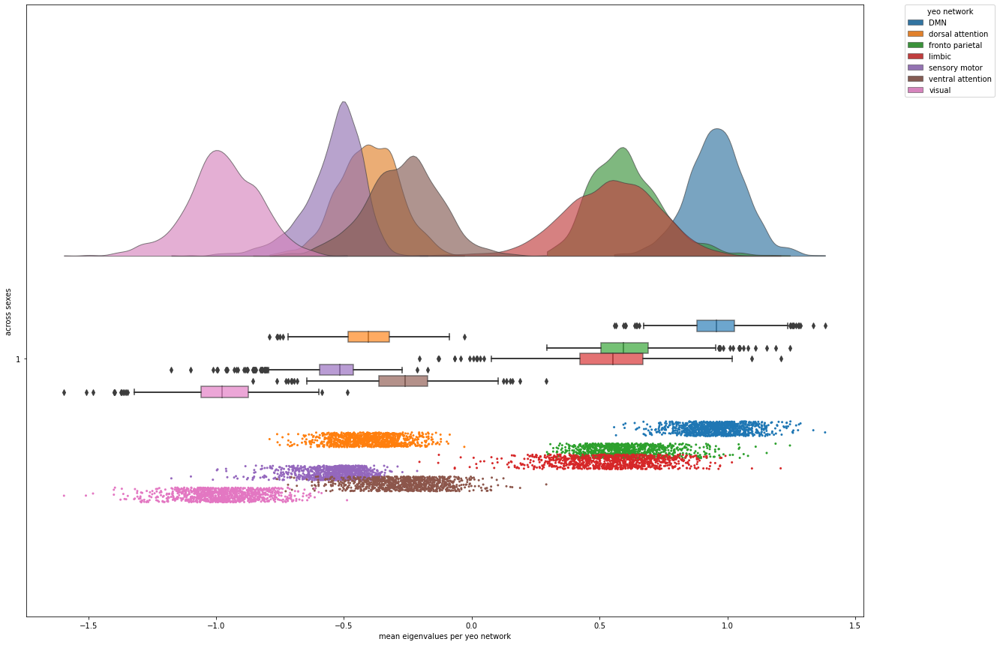

In [238]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plot of mean eigenvalues (G1) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G1 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks)

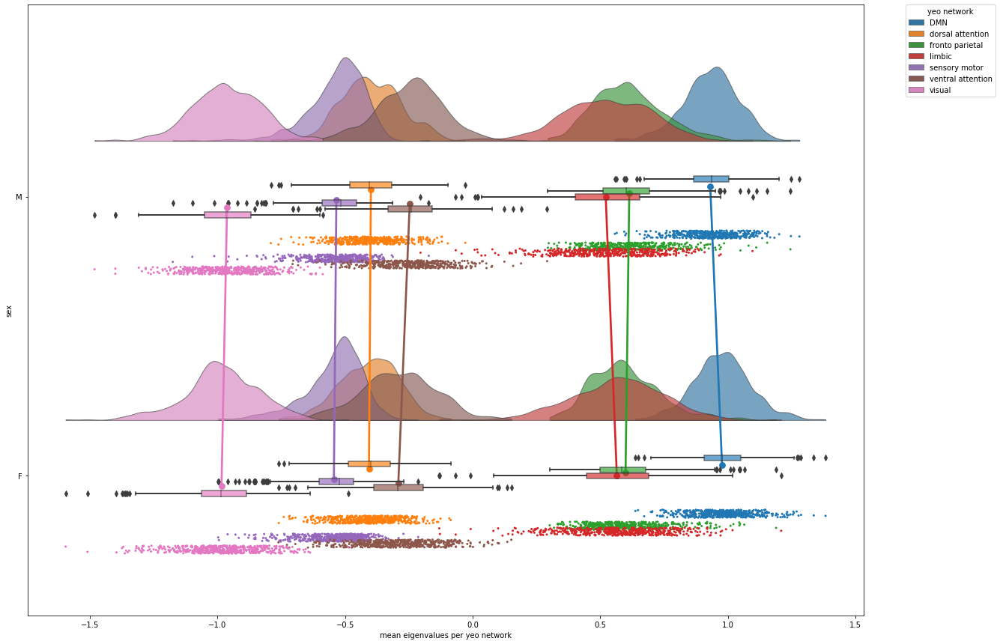

In [239]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

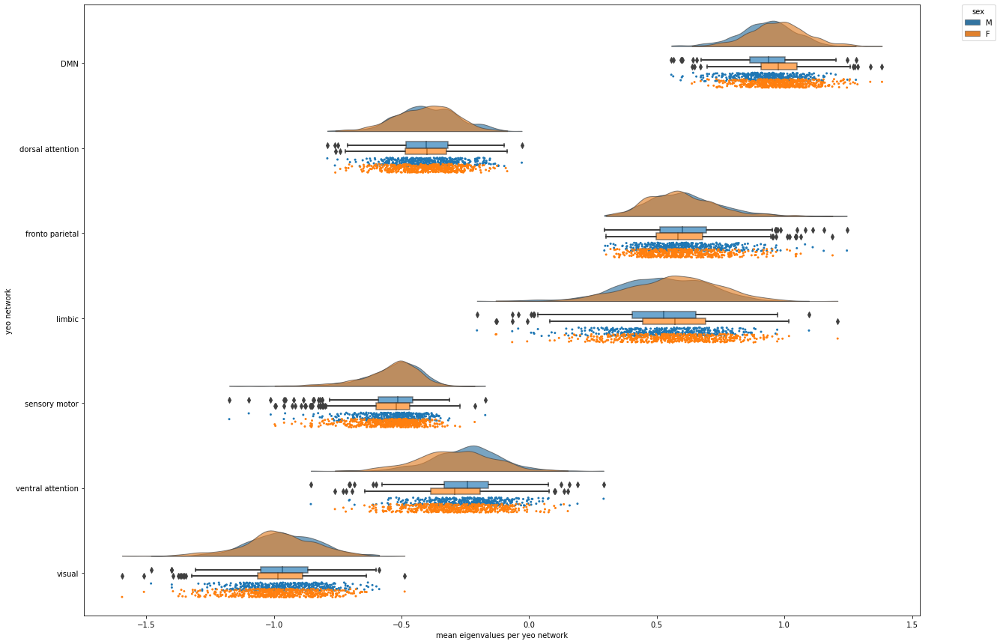

In [240]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G1_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                #figsize=(7,5),  # DELETE THIS
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

##### **In order to study brain organization (and related intersubject variability) - plot the distribution of 400 parcel eigenvalues per network** (variability across 10 subjects - only indicative)
##### RainCloud plot of eigenvalues (G1) for each parcel (labeled by network) - for first 10 subjects

400 parcel eigenvalues (labeled with 7 Yeo networks) for G1, for first 10 subjects

4000 data points (400 parcels * 10 subjects)

Sex of subjects (from top to bottom): ['M', 'F', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M']


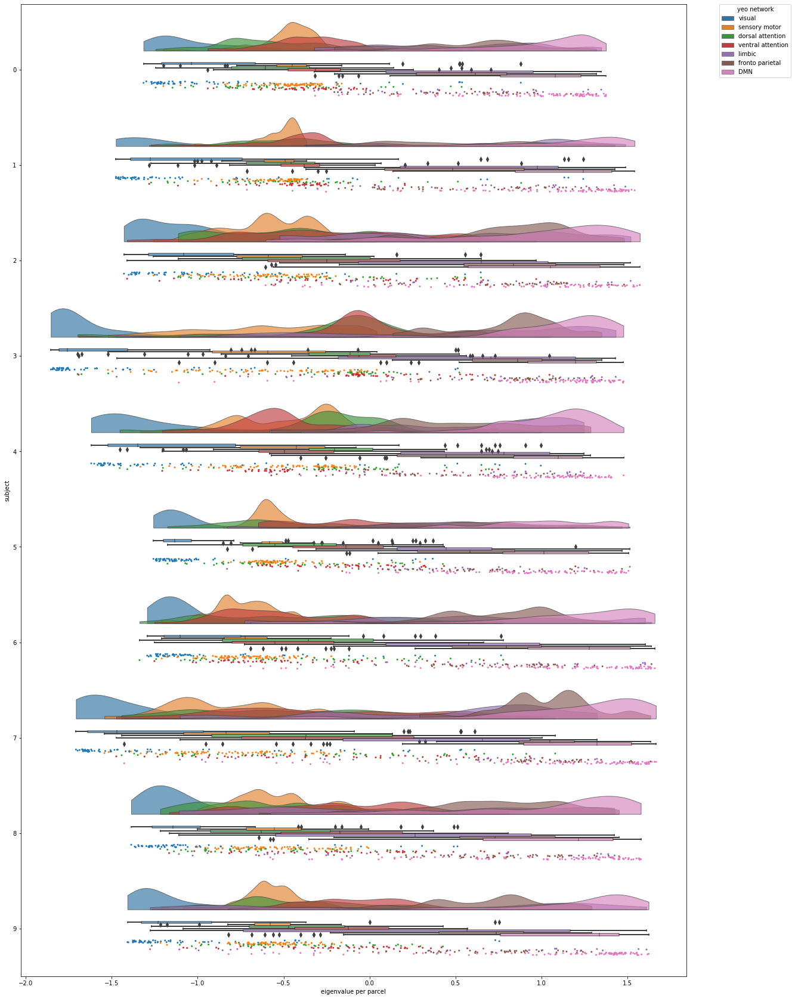

In [241]:
### Organizing the data

df_G1_10sub_pca = pd.DataFrame(array_aligned_G1_pca[0:10].T)

# adding a column containing the Yeo network labels
df_G1_10sub_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G1_10sub_pca.loc[df_G1_10sub_pca["yeo network"] == "7", "yeo network"] = "DMN"

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G1_10sub_pca.index.name = "sub"

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G1_10sub_pca=pd.melt(df_G1_10sub_pca, id_vars=['yeo network'], var_name='subject', value_name='eigenvalue per parcel')


### Plotting 400 parcel eigenvalues (labeled by network) for G1, for first 10 subjects

f,ax=plt.subplots(figsize=(20,30))

ax=pt.RainCloud(x="subject",
                y="eigenvalue per parcel",
                hue="yeo network",
                data=df_G1_10sub_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

print(f'Sex of subjects (from top to bottom): {demographics_cleaned["Sex"].tolist()[0:10]}')

#### Gradient 2

Create a DataFrame containing the Gradient 2 eigenvalues and labelled Yeo 7 networks

In [242]:
# dataframe of the G2 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G2_pca = pd.DataFrame(array_aligned_G2_pca.T)

# adding a column containing the Yeo network labels
df_G2_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G2_pca.loc[df_G2_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G2_pca.loc[df_G2_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G2_pca.loc[df_G2_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G2_pca.loc[df_G2_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G2_pca.loc[df_G2_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G2_pca.loc[df_G2_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G2_pca.loc[df_G2_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G2_pca = df_G2_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G2_pca["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G2_pca.index.name = "sub"
df_G2_pca = df_G2_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G2_pca=pd.melt(df_G2_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G2_pca["across sexes"] = [1] * 7098

##### RainCloud plot of mean eigenvalues (G2) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

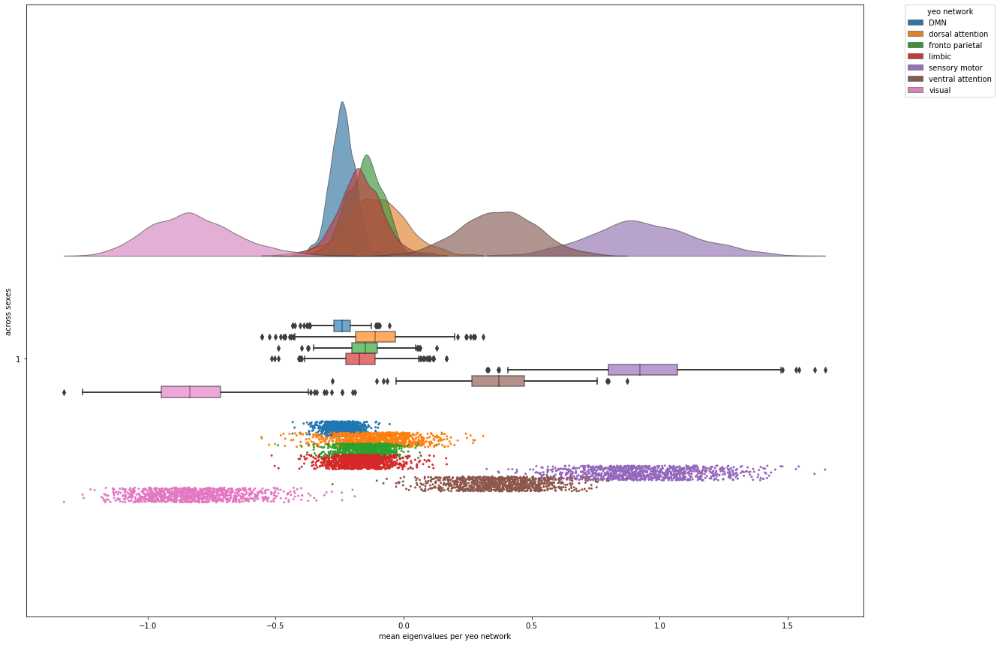

In [243]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G2) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G2 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 


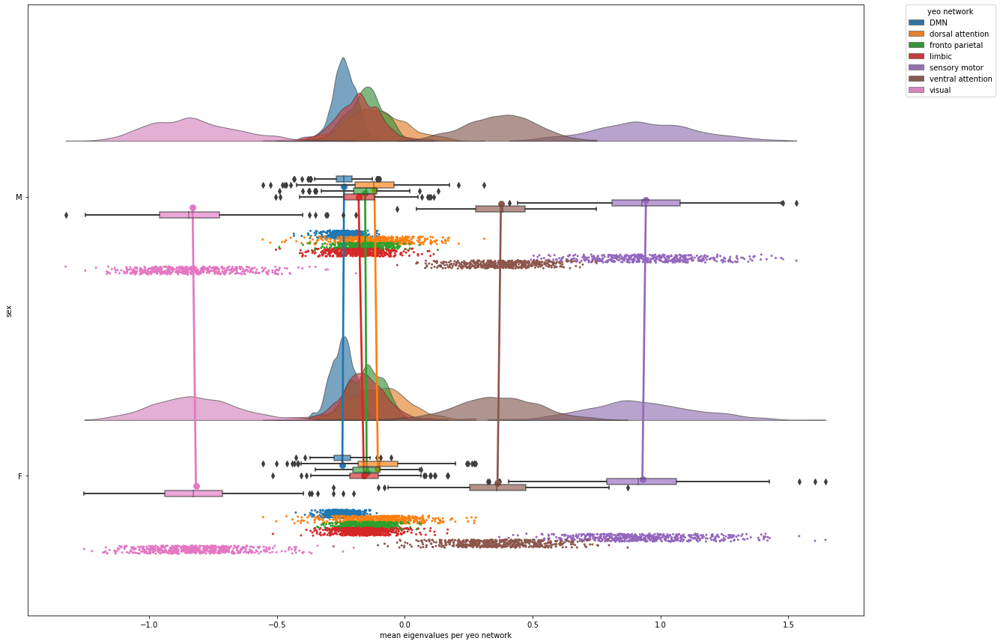

In [244]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

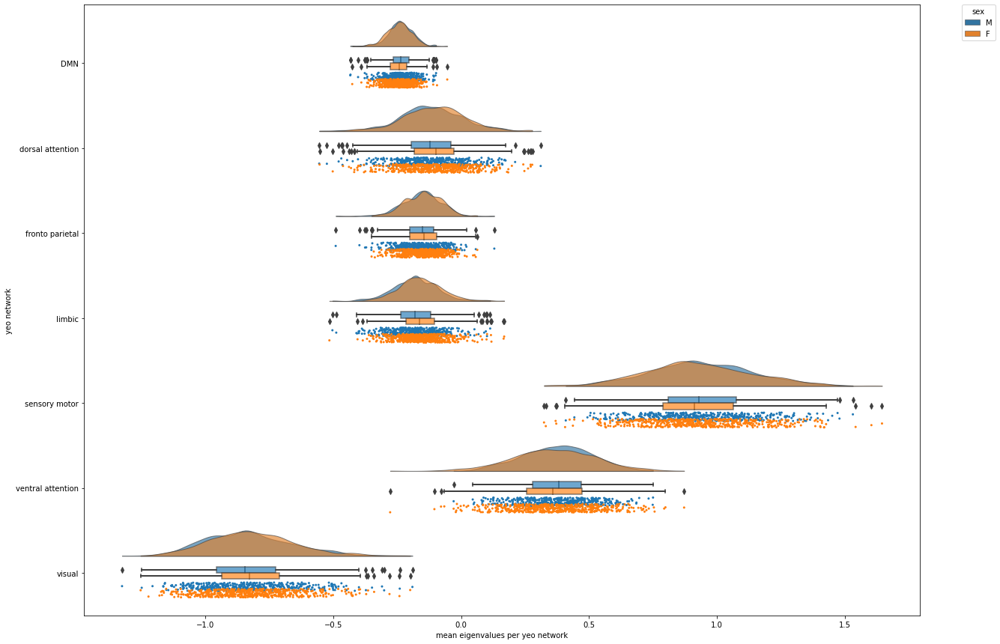

In [245]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G2_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

#### Gradient 3

Create a DataFrame containing the Gradient 3 eigenvalues and labelled Yeo 7 networks

In [246]:
# dataframe of the G3 eigenvalues (transposing the original array because we need the 400 parcels to be vertical in the dataframe in order to be labeled with their corresponding Yeo network)
df_G3_pca = pd.DataFrame(array_aligned_G3_pca.T)

# adding a column containing the Yeo network labels
df_G3_pca['yeo network'] = yeo7_networks

# renaming the Yeo network labels
df_G3_pca.loc[df_G3_pca["yeo network"] == "1", "yeo network"] = "visual"
df_G3_pca.loc[df_G3_pca["yeo network"] == "2", "yeo network"] = "sensory motor"
df_G3_pca.loc[df_G3_pca["yeo network"] == "3", "yeo network"] = "dorsal attention"
df_G3_pca.loc[df_G3_pca["yeo network"] == "4", "yeo network"] = "ventral attention"
df_G3_pca.loc[df_G3_pca["yeo network"] == "5", "yeo network"] = "limbic"
df_G3_pca.loc[df_G3_pca["yeo network"] == "6", "yeo network"] = "fronto parietal"
df_G3_pca.loc[df_G3_pca["yeo network"] == "7", "yeo network"] = "DMN"

# obtaining the mean of the parcels with the same Yeo network label, then transposing because we need the 1014 subjects to be vertical in the dataframe in order to be labeled with their corresponding sex 
df_G3_pca = df_G3_pca.groupby("yeo network", as_index=True).mean().T

# adding a column containing the sex labels
df_G3_pca["sex"] = demographics_cleaned["Sex"].tolist()

# naming the index and resetting it as an index in order to make it callable in the following melt function
df_G3_pca.index.name = "sub"
df_G3_pca = df_G3_pca.reset_index()

# for the RainCloud plots, we need dataframe to have all values to be plotted in 1 column, and labels to be plotted in other columns (max 2)
# using melt() to make dataframe long so that mean eigenvalues per network are in one column, whilst preserving the sub number and sex as ID variables
df_G3_pca=pd.melt(df_G3_pca, id_vars=["sub", 'sex'], var_name='yeo network', value_name='mean eigenvalues per yeo network')

# in order to first display across sexes (clouds on the same line), creating another column with only 1s in order to use it as the "group" for dx
df_G3_pca["across sexes"] = [1] * 7098

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - across sexes

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects) 
7098 data points (1014 subjects * 7 networks) 

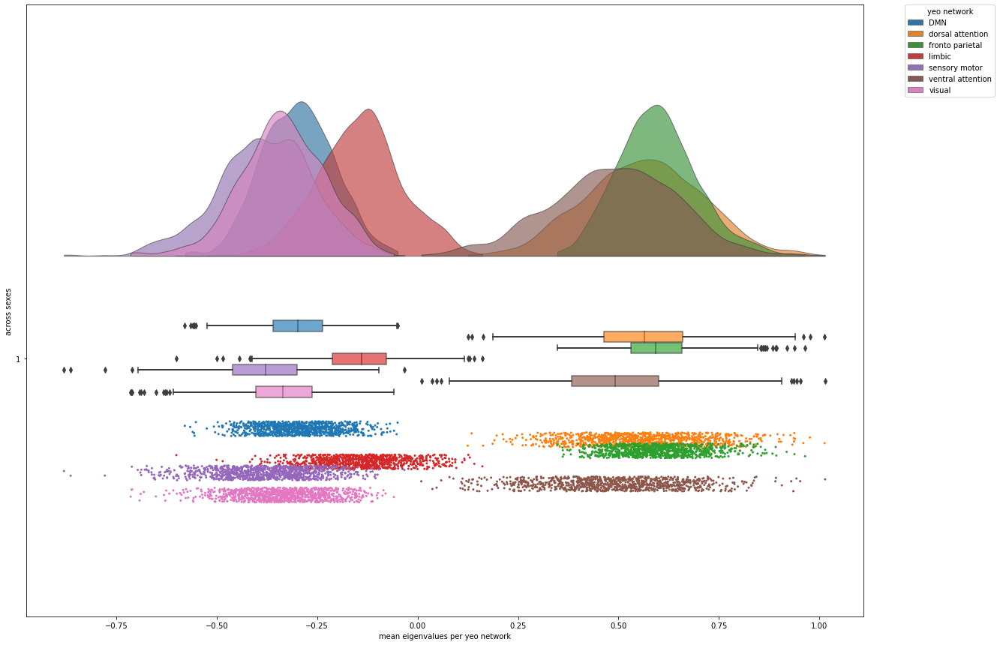

In [247]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="across sexes",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=False, 
                dodge = True)

##### RainCloud plots of mean eigenvalues (G3) for 7 Yeo networks - by sex

Mean eigenvalues for aligned G3 calculated across parcels belonging to each network (all subjects, displayed by sex) 

7098 data points (1014 subjects * 7 networks) 

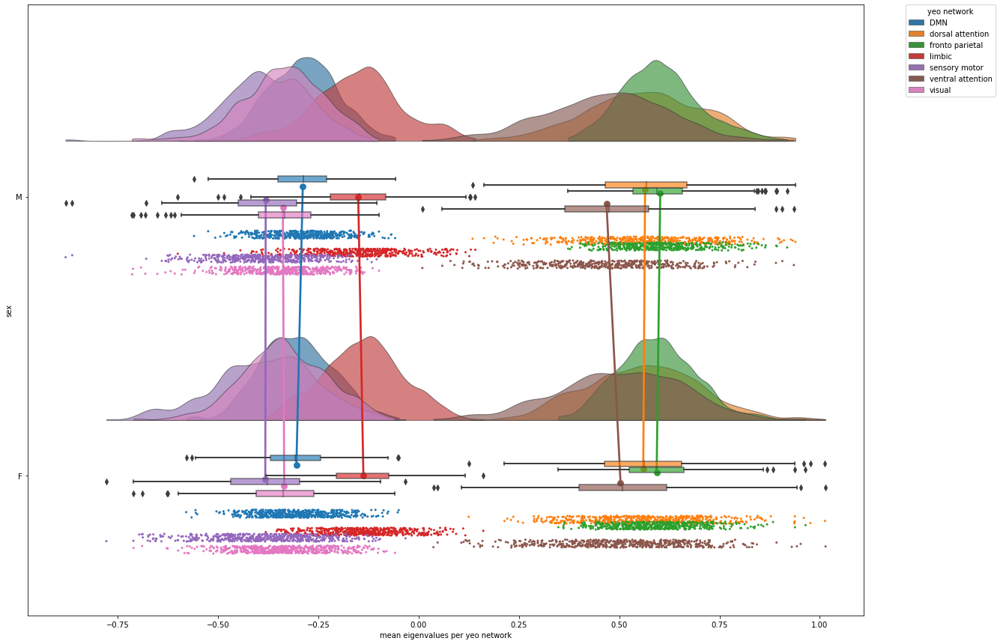

In [248]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="sex",
                y="mean eigenvalues per yeo network",
                hue="yeo network",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)

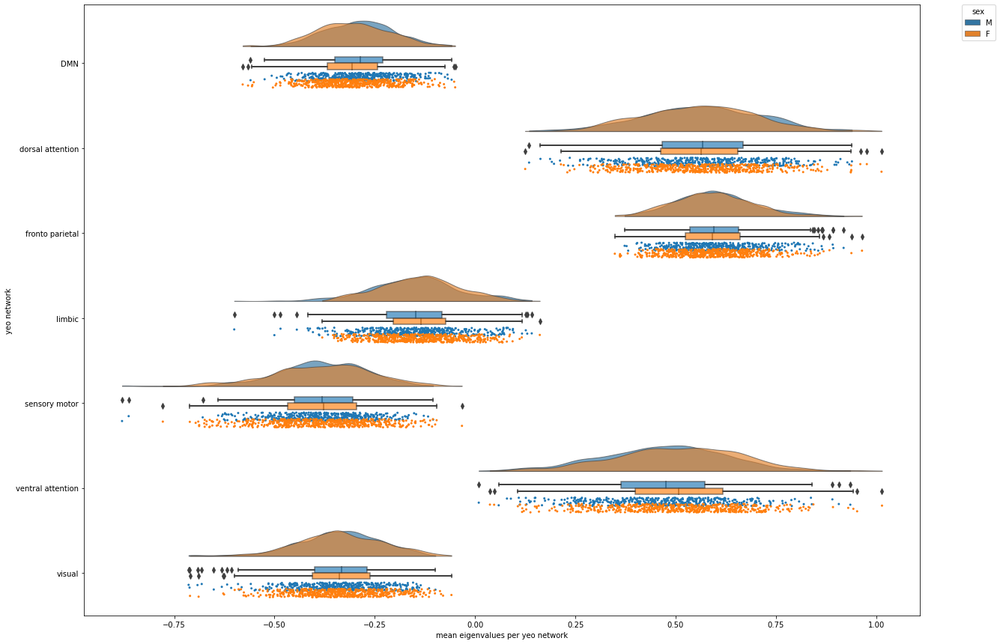

In [249]:
f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="yeo network",
                y="mean eigenvalues per yeo network",
                hue="sex",
                data=df_G3_pca,
                palette=sns.color_palette(n_colors=7),
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65, 
                dodge=True)

### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

#### Gradient 1

In [250]:
### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G1_pca)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


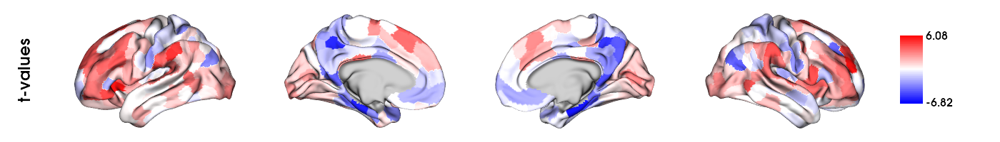

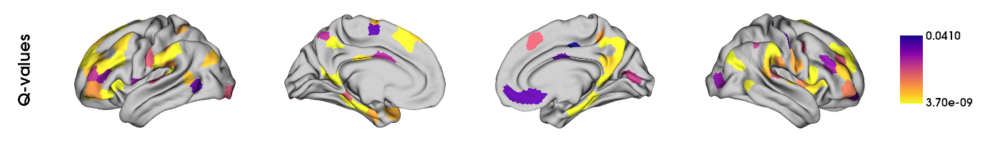

In [251]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESULTS ---

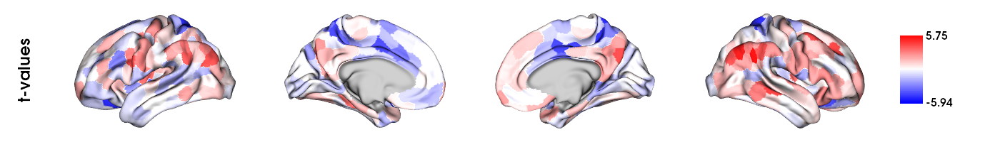

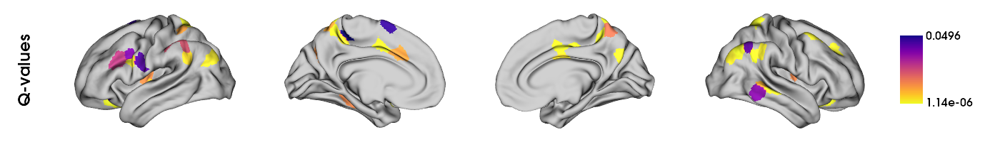

In [252]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

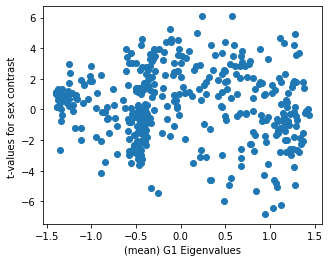

In [253]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 0], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

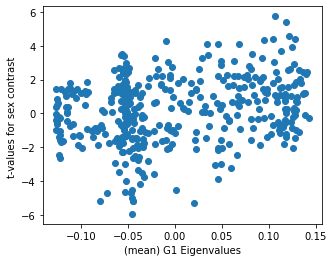

In [254]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 2

In [255]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G2_pca)

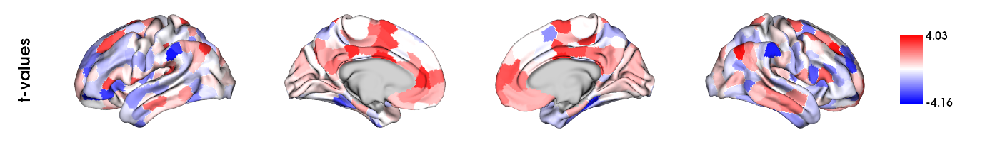

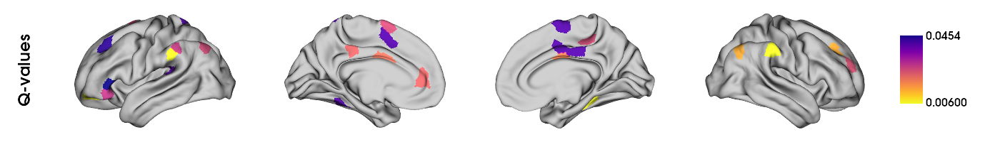

In [256]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESULTS ---

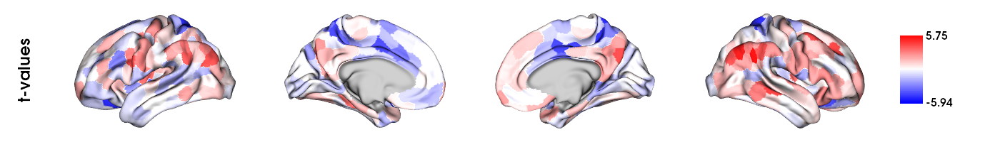

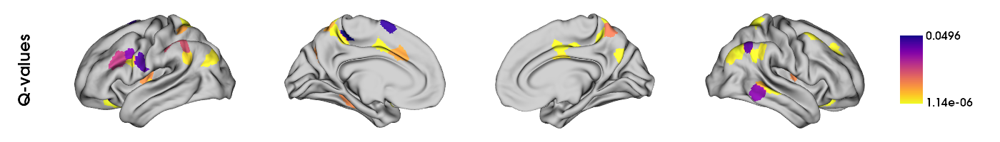

In [257]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

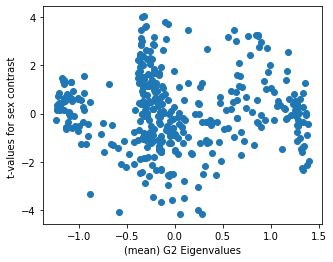

In [258]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 1], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

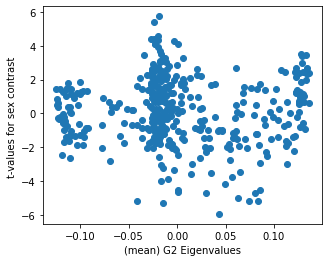

In [259]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 1], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 3

In [260]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_pca = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_pca.fit(array_aligned_G3_pca)

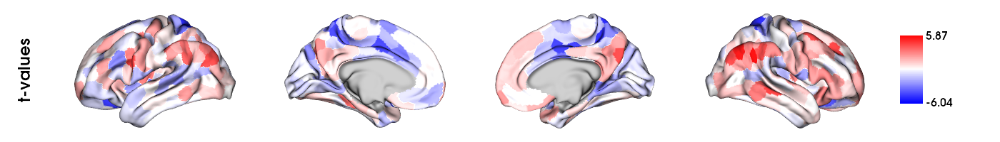

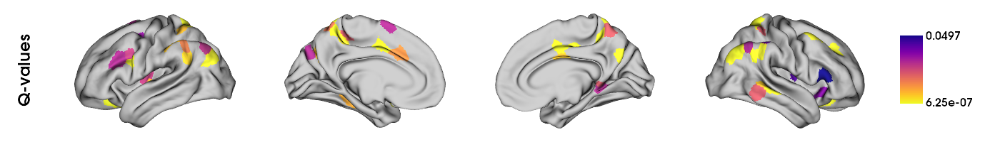

In [261]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_pca)
display(*plots_to_display)

--- ORIGINAL RESUTLS ---

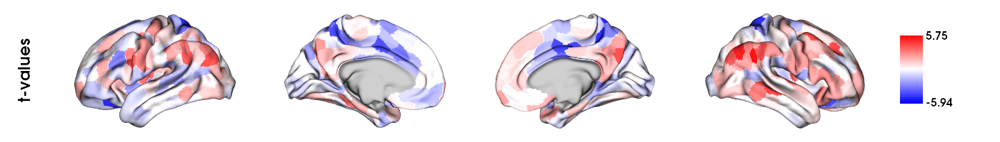

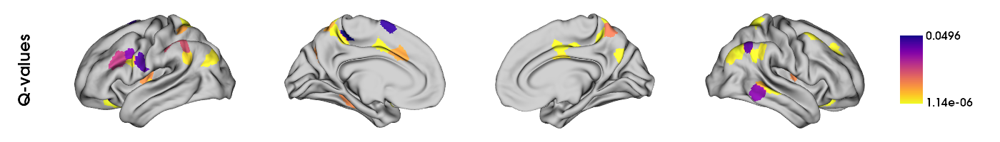

In [262]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

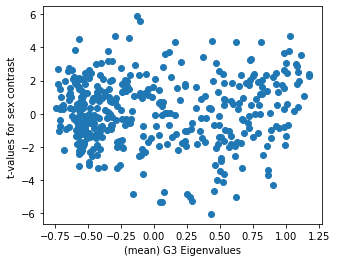

In [263]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_pca.gradients_[:, 2], slm_SEX_age_icv_pca.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS ---

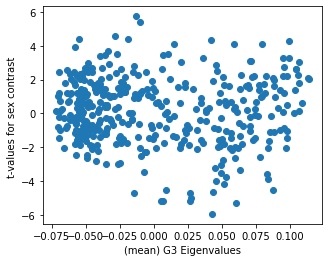

In [264]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 2], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

### Unrelated subjects - PCA

#### Construct mean gradients 
(i.e., gradients for the mean matrix)

In [265]:
# GradientMaps function used to build the model parameters
mean_grad_unrel_1_pca = GradientMaps(n_components = 10, random_state = 0, approach = 'pca', kernel = 'normalized_angle')

# fit function used to compute the gradients
mean_grad_unrel_1_pca.fit(mean_fc_matrix_unrel_1)

GradientMaps(approach='pca', kernel='normalized_angle', random_state=0)

Plot 3 first gradients of the mean matrix

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


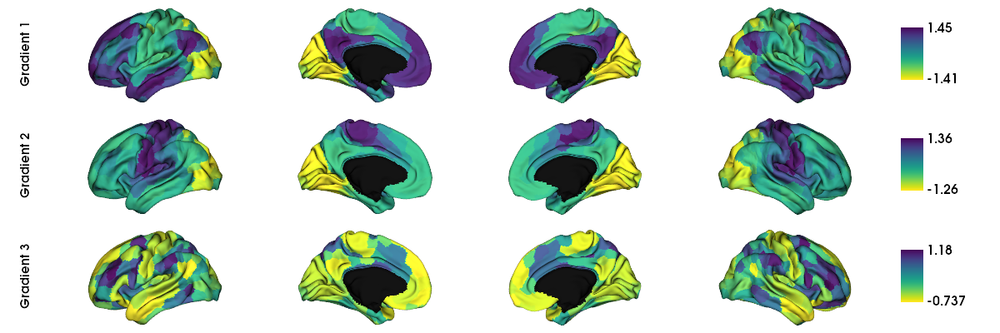

In [266]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0


# list containing placeholders (None) for the number of gradients I want to plot
grad = [None] * 3

for i in range(3):
    # map the gradient to the parcels
    grad[i] = map_to_labels(mean_grad_unrel_1_pca.gradients_[:, i], labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=grad, embed_nb = True, size=(1200, 400), cmap='viridis_r', color_bar=True, label_text=['Gradient 1', 'Gradient 2', 'Gradient 3'], zoom=1.55)

Variance explained by the 10 gradients

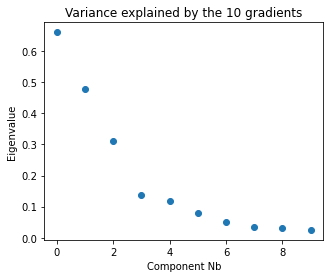

In [267]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(range(mean_grad_unrel_1_pca.lambdas_.size), mean_grad_unrel_1_pca.lambdas_)
ax.set_title("Variance explained by the 10 gradients")
ax.set_xlabel('Component Nb')
ax.set_ylabel('Eigenvalue')

plt.show()

In [268]:
# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Total amount of variance explained by the {len(mean_grad_unrel_1_pca.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_grad_unrel_1_pca.lambdas_):.2f}\n")
print(f"Scaled variance explained by individual gradients:\nG1: {mean_grad_unrel_1_pca.lambdas_[0]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\nG2: {mean_grad_unrel_1_pca.lambdas_[1]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\nG3: {mean_grad_unrel_1_pca.lambdas_[2]/sum(mean_grad_unrel_1_pca.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 1.92

Scaled variance explained by individual gradients:
G1: 34.40%
G2: 24.89%
G3: 16.17%



Scatterplot of the first two gradients, colorcoding displays 3rd gradient (but categorical so not good)

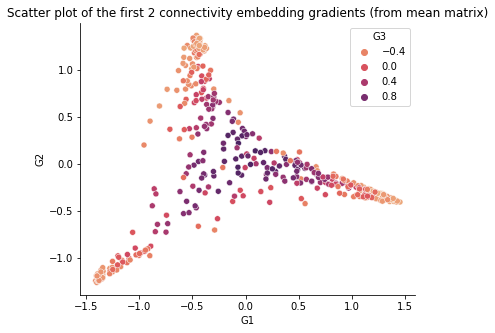

In [269]:
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_grad_unrel_1_pca.gradients_[:,0],  # all rows (400 parces), first column (G1)
                     y=mean_grad_unrel_1_pca.gradients_[:,1],  # all rows (400 parces), second column (G2)
                     hue=mean_grad_unrel_1_pca.gradients_[:,2],  # gives color coding based on all rows (400 parces), third column (G3)
                     palette=sns.color_palette("flare", as_cmap=True), 
                     legend=True, ax=ax);
ax.set_xlabel('G1');
ax.set_ylabel('G2');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='G3')
plt.show(ax)

##### Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [270]:
list_aligned_gradients_unrel_1_pca = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_aligned_G1_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_aligned_G2_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_aligned_G3_unrel_1_pca = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400_unrel_1)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad_procr_pca = GradientMaps(n_components=10, random_state=0, approach='pca', kernel='normalized_angle', alignment='procrustes')  # specify alignment method here (procrustes)

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad_procr_pca.fit(fc_matrices_400[i], reference=mean_grad_pca.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_aligned_gradients_unrel_1_pca.append(grad_procr_pca.aligned_)
    list_aligned_G1_unrel_1_pca.append(grad_procr_pca.aligned_.T[0])
    list_aligned_G2_unrel_1_pca.append(grad_procr_pca.aligned_.T[1])
    list_aligned_G3_unrel_1_pca.append(grad_procr_pca.aligned_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_aligned_gradients_unrel_1_pca = np.array(list_aligned_gradients_unrel_1_pca)
array_aligned_G1_unrel_1_pca = np.array(list_aligned_G1_unrel_1_pca)
array_aligned_G2_unrel_1_pca = np.array(list_aligned_G2_unrel_1_pca)
array_aligned_G3_unrel_1_pca = np.array(list_aligned_G3_unrel_1_pca)

#### Sex effects (standard linear regression - FDR-corrected - main model: sex + age + ICV)

##### Gradient 1

In [271]:
### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G1_unrel_1_pca)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


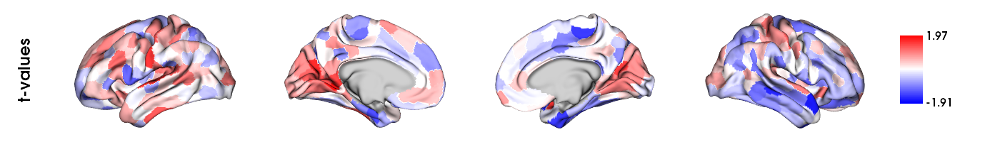

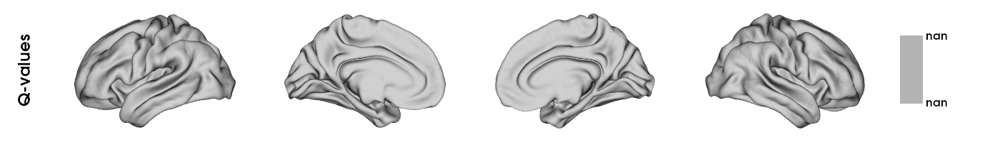

In [272]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

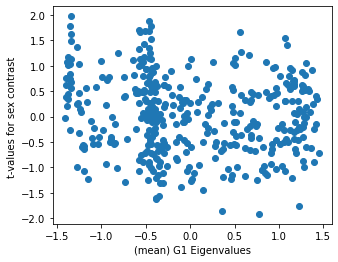

In [273]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 0], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

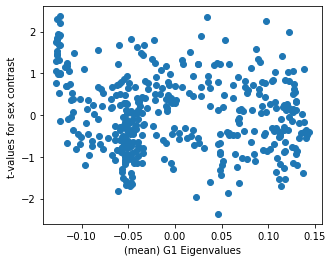

In [274]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 0], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

##### Gradient 2

In [275]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G2_unrel_1_pca)

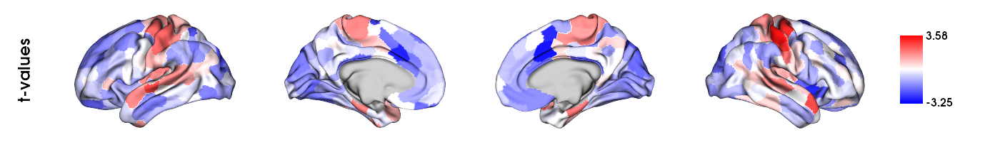

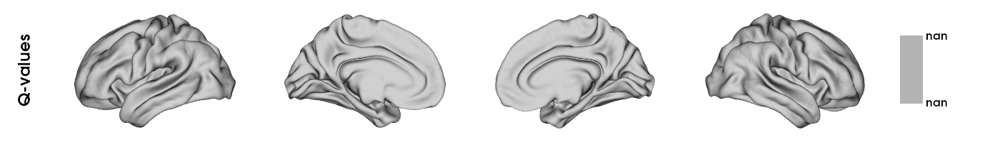

In [276]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 2 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

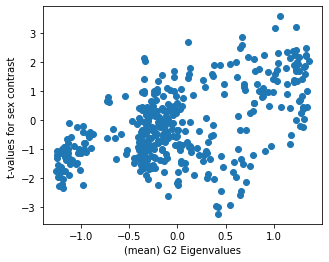

In [277]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 1], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

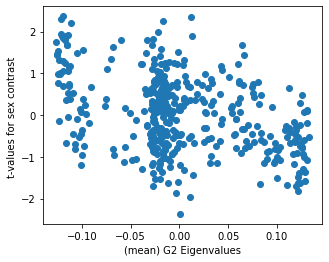

In [278]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 1], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G2 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

##### Gradient 3

In [279]:
### model terms, contrast (sex differences), main model -> already defined for Gradient 1


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv_unrel_1_pca = SLM(
    model_sex_age_icv_unrel_1,
    contrast = contrast_sex_unrel_1,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv_unrel_1_pca.fit(array_aligned_G3_unrel_1_pca)

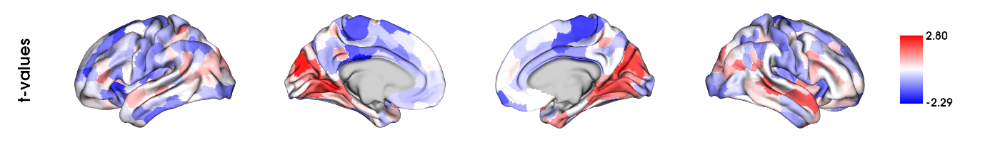

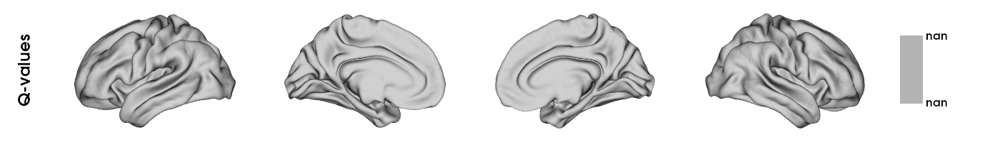

In [280]:
plots_to_display = plot_slm_results(slm_SEX_age_icv_unrel_1_pca)
display(*plots_to_display)

Scatterplot of Gradient 3 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

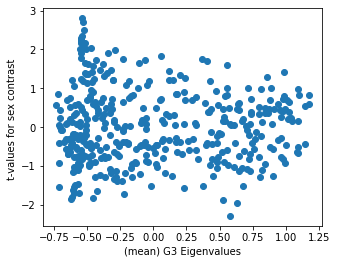

In [281]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1_pca.gradients_[:, 2], slm_SEX_age_icv_unrel_1_pca.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

--- ORIGINAL RESULTS (unrelated / diffusion embedding: ---

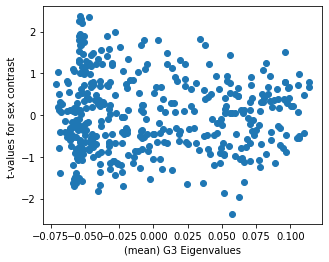

In [282]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad_unrel_1.gradients_[:, 2], slm_SEX_age_icv_unrel_1.t[0])

ax.set_xlabel('(mean) G3 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

## Non-Aligned gradients

### Construct gradients for all subjects (not aligning to see impact on sex effects)

In [283]:
list_NONaligned_gradients = []  # will contain all participants (1014), all parcels (400), all gradients (10)
list_NONaligned_G1 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 1
list_NONaligned_G2 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 2
list_NONaligned_G3 = []  # will contain all participants (1014), all parcels (400) -> values = eigenvalues for GRADIENT 3
  
# loop over all the fc matrices
for i in range(len(fc_matrices_400)):
    # setting model parameters for gradients to be computed across subjects - with procrustes alignment
    grad = GradientMaps(n_components=10, random_state=0, approach='dm', kernel='normalized_angle') 

    # computing
    # note that by using an alignment method, .fit yields a variable (grad_procr) containing both types of gradients, callable with: .gradients_ (original) and .aligned_ (aligned - use this for analyses)
    grad.fit(fc_matrices_400[i], reference=mean_grad.gradients_)  # align to the gradients of the gradients produced by the mean matrix (reference) 

    # append array to lists results (.T is necessary in order to be able to first access the gradients layer (10) so that can index the desired gradient, which will then contain all the parcels (400)
    list_NONaligned_gradients.append(grad.gradients_)
    list_NONaligned_G1.append(grad.gradients_.T[0])
    list_NONaligned_G2.append(grad.gradients_.T[1])
    list_NONaligned_G3.append(grad.gradients_.T[2])
    
# make gradient lists into arrays (for analyses)    
array_NONaligned_gradients = np.array(list_NONaligned_gradients)
array_NONaligned_G1 = np.array(list_NONaligned_G1)
array_NONaligned_G2 = np.array(list_NONaligned_G2)
array_NONaligned_G3 = np.array(list_NONaligned_G3)

### Sex effects

#### Gradient 1

In [284]:
### creating model terms

term_sex = FixedEffect(demographics_cleaned.Sex)
term_age = FixedEffect(demographics_cleaned.Age_Bin)
term_icv = FixedEffect(demographics_cleaned.ICV)


### defining contrast to test: sex differences

contrast_sex = (demographics_cleaned.Sex == "M").astype(int) - (demographics_cleaned.Sex == "F").astype(int)  # makes M = 1 and F = -1


### defining the main model 

model_sex_age_icv = term_sex + term_age + term_icv  


### fitting the main model

# sex effects including sex, age, and icv in model
slm_SEX_age_icv = SLM(
    model_sex_age_icv,
    contrast = contrast_sex,
    correction=["fdr"],
    two_tailed=True,
)
slm_SEX_age_icv.fit(array_NONaligned_G1)

In [285]:
slm_SEX_age_icv.Q

array([1.        , 0.6015344 , 1.        , 1.        , 1.        ,
       1.        , 0.6015344 , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 0.73560289,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       0.18192379, 1.        , 1.        , 0.62154314, 1.     

In [286]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 13


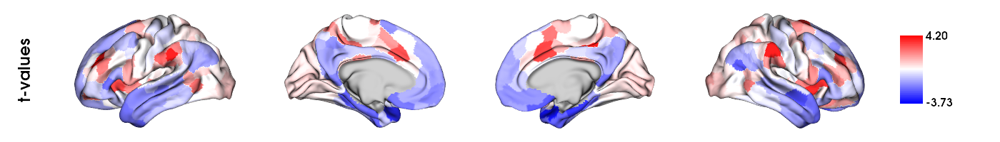

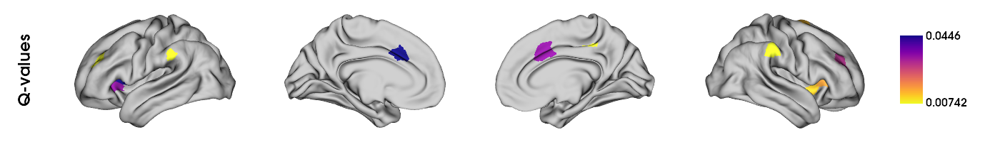

In [287]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

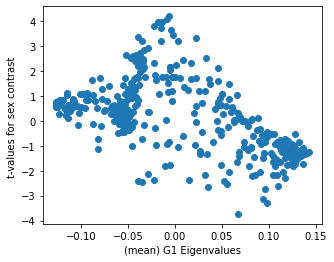

In [288]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 2

In [289]:
slm_SEX_age_icv.fit(array_NONaligned_G2)

In [290]:
slm_SEX_age_icv.Q

array([1.        , 0.96958303, 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       0.93360832, 0.93360832, 0.94879069, 1.        , 1.        ,
       1.        , 0.93360832, 1.        , 1.        , 1.        ,
       1.        , 1.        , 0.93360832, 0.93360832, 1.        ,
       1.        , 1.        , 0.93360832, 1.        , 1.        ,
       0.93908282, 0.87549816, 1.        , 1.        , 1.     

In [291]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 0


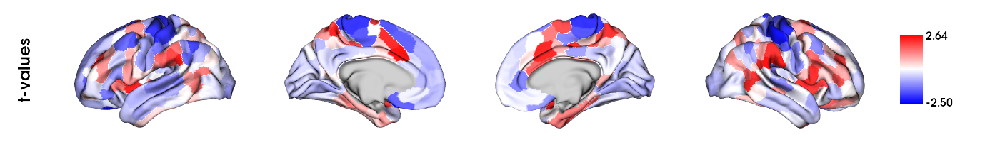

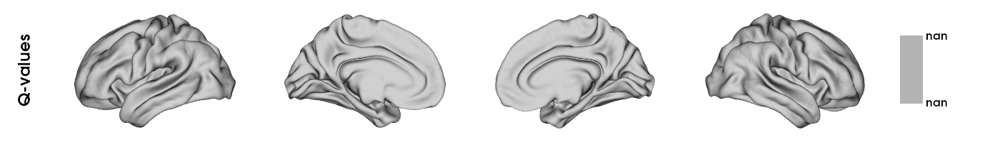

In [292]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

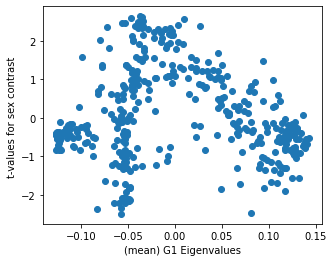

In [293]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

#### Gradient 3

In [294]:
slm_SEX_age_icv.fit(array_NONaligned_G3)

In [295]:
slm_SEX_age_icv.Q

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1.

In [296]:
sig = []
for i in range(len(slm_SEX_age_icv.Q)):
    if slm_SEX_age_icv.Q[i] < 0.05:
        sig.append(slm_SEX_age_icv.Q)
        
print(f"Number of significant parcels: {len(sig)}")

Number of significant parcels: 0


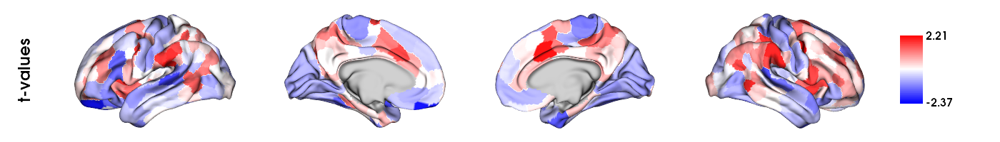

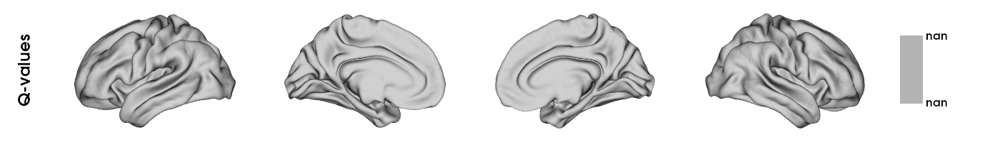

In [297]:
plots_to_display = plot_slm_results(slm_SEX_age_icv)
display(*plots_to_display)

Scatterplot of Gradient 1 eigenvalues (from mean matrix) and t-values for sex contrast in main model (controling for age and icv)

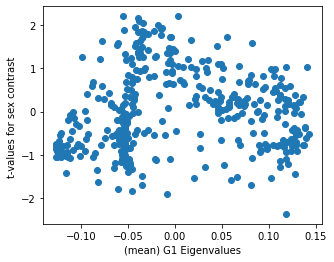

In [298]:
fig, ax = plt.subplots(1, figsize=(5, 4))
ax.scatter(mean_grad.gradients_[:, 0], slm_SEX_age_icv.t[0])

ax.set_xlabel('(mean) G1 Eigenvalues')
ax.set_ylabel('t-values for sex contrast ')

plt.show()

### **SUMMARY results with non-aligned gradients:**
When not aligning, losing a lot of significant parcels for gradient 1 (94 -> 13) and all significance for gradient 2 (previously 17) and 3 (previously 48)

**THIS ANALYSIS HAS NOT YET BEEN DONE WITH R LM CALCULATION**